A collection of python tools for astronomical image analysis. <br>
By Geferson Lucatelli

Objectives:
1. Basic image manipulation and plotting.
2. Characterize the radio emission of radio maps.
3. Perform image analysis to extract relevant physical properties.

Basically, this notebook contains:

    1. Plotting capabilities
    2. Signal processing / Image analysis (non-parametric)
    3. Source Extraction
    5. Others

Multiple libraries, functions, etc, are placed in the library file `libs/libs.py`. The module `morphen.py` helps to deal with different kinds of tasks. You can run it on a notebook or as a `CLI`. 

Index:

1. [Introduction/Imports](#imports) <br>
2. [Data Manipulation](#data_manipulation) <br>
    2.1 [Preparing Images](#preparing_images) <br>
    2.2 [Masking](#masking) <br>
3. [Source Extraction](#source_extraction) <br>

<a id='imports'></a>

```
 _           ___                            _       
/ |         |_ _|_ __ ___  _ __   ___  _ __| |_ ___ 
| |  _____   | || '_ ` _ \| '_ \ / _ \| '__| __/ __|
| | |_____|  | || | | | | | |_) | (_) | |  | |_\__ \
|_|         |___|_| |_| |_| .__/ \___/|_|   \__|___/
                          |_|                      
```

<a id='imports'></a>
# Importing required libraries. 

In [9]:
import sys
sys.path.append('../libs/')
sys.path.append('../')
import morphen as mp
import libs as mlibs
import numpy as np



Note now that we can use existing imported packages from `libs.py` as `mlibs.np`, etc..

In [10]:
mlibs.np.__version__

'1.24.4'

In [11]:
mp.__version__

'0.3.1b'

<a id='data_manipulation'></a>

```
 ____            ____        _
|___ \          |  _ \  __ _| |_ __ _
  __) |  _____  | | | |/ _` | __/ _` |
 / __/  |_____| | |_| | (_| | || (_| |
|_____|         |____/ \__,_|\__\__,_|

 __  __             _             _       _   _             
|  \/  | __ _ _ __ (_)_ __  _   _| | __ _| |_(_) ___  _ __  
| |\/| |/ _` | '_ \| | '_ \| | | | |/ _` | __| |/ _ \| '_ \ 
| |  | | (_| | | | | | |_) | |_| | | (_| | |_| | (_) | | | |
|_|  |_|\__,_|_| |_|_| .__/ \__,_|_|\__,_|\__|_|\___/|_| |_|
                     |_|                                    

````

## Listing Imaging Data

The way you read data (`.fits` or `CASA` images) is up to you, but here we provide a simple interface through `morphen` to easily read `.fits` files.

For this notebook, we are going to use a set of example data, that can be found in this repository: https://github.com/lucatelli/data_examples
For that, clone the entire repo. 
<!-- 
Additionally, the same data can be found in this link: 
()

```
import os
os.system('wget ()')
os.system('tar -xvf data_examples.tar.xz')
```

<br> -->

With this data, you can experiment with the general usage of `morphen`. 

In [95]:
# First, define the path to the data.
root_path = '../../data_examples/data_examples_general/vla_only/UGC5101_X/'

In [96]:
#To easily list files in a directory, use the glob module, setting a prefix of your images.
# In this example, images produced by WSClean have the prefix '-MFS-image.fits'
prefix_images = '*MFS-image.fits'

In [97]:
imagelist = mlibs.glob.glob(root_path+prefix_images)


In [98]:
imagelist

['../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-image.fits',
 '../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-image.fits']

### Sorting a list of images by beam-size. 

Sometimes, it is convenient to sort the radio images according to the size of the restoring beam. This function will also return the associated residual images if they exist at the same directory. If the directory structure is the same as indicated previously, that will be done automatically. If not, you must provide the associated list or residual maps. You must ensure that the id of each image will correspond to the residuals.  

Residual images are important to get error estimates for flux densities, and for modelling the background noise.

In [99]:
mlibs.sort_list_by_beam_size??

Signature: mlibs.sort_list_by_beam_size(imagelist, residuallist=None, return_df=False)
Source:   
def sort_list_by_beam_size(imagelist, residuallist=None,return_df=False):
    """
    Sort a list of images files by beam size.

    If no residual list is provided, it will assume that the residual files are in the same
    directory as the image files, and that the residual files have the same name prefix as the
    image files.


    Parameters
    ----------
    imagelist : list
        List of image files.
    residuallist : list, optional
        List of associated residual files.
    return_df : bool, optional
        Return a pandas dataframe with the beam sizes.

    Returns
    -------
    imagelist_sort : list
        Sorted list of image files.
    residuallist_sort : list
        Sorted list of residual files.
    df_beam_sizes_sorted : pandas dataframe
        Dataframe with the beam sizes.
    """
    beam_sizes_list = []
    for i in tqdm(range(len(imagelist))):
        bea

In [100]:
imagelist,residuallist = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist,
                                 return_df = False)

100%|██████████| 2/2 [00:00<00:00, 71.69it/s]

0 >> selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-image.fits
1 >> selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-image.fits


In [101]:
residuallist

array(['../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-residual.fits',
       '../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-residual.fits'],
      dtype=object)

Now, we can use the function `mp.read_data` to read the data the data.


In [102]:
# lets select one image from our list of images. 
idx = -1 #select one index from the list. 
input_data=mp.read_data(filename=imagelist[idx],
                        residualname=residuallist[idx])

++>> Image File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-image.fits
++>> Residual File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-residual.fits
-->> No PSF File was provided.


In [103]:
# input_data??

In [104]:
#Some basic information cab be obtained from `input_data` object.
#2D numpy array of the source image
input_data.image_data_2D

array([[ 3.02492890e-06,  3.17884712e-07, -2.60909928e-06, ...,
        -4.35704897e-06, -6.60618980e-06, -7.34033665e-06],
       [ 5.43647684e-06,  4.45252681e-06,  3.11180679e-06, ...,
        -6.45954151e-06, -7.37405571e-06, -5.72745375e-06],
       [ 6.54576706e-06,  7.49127048e-06,  7.89675596e-06, ...,
        -6.01709007e-06, -5.43050692e-06, -2.27464398e-06],
       ...,
       [-9.56238000e-06, -8.10077381e-06, -5.80174446e-06, ...,
        -5.42785529e-06, -4.71634939e-06, -5.75049580e-06],
       [-1.13677434e-05, -1.04898727e-05, -8.53862184e-06, ...,
        -8.91438685e-06, -6.58776798e-06, -5.22190976e-06],
       [-1.15884286e-05, -1.07414480e-05, -9.27955534e-06, ...,
        -1.32532987e-05, -9.38525864e-06, -5.71169903e-06]])

In [105]:
#2D numpy array of the residual image
input_data.residual_data_2D

array([[ 3.02496960e-06,  3.17923195e-07, -2.60906472e-06, ...,
        -4.35701440e-06, -6.60615115e-06, -7.34029572e-06],
       [ 5.43649776e-06,  4.45254636e-06,  3.11182475e-06, ...,
        -6.45952105e-06, -7.37403388e-06, -5.72743193e-06],
       [ 6.54579890e-06,  7.49130140e-06,  7.89678688e-06, ...,
        -6.01705688e-06, -5.43047327e-06, -2.27461123e-06],
       ...,
       [-9.56237363e-06, -8.10076745e-06, -5.80173901e-06, ...,
        -5.42785301e-06, -4.71634530e-06, -5.75049035e-06],
       [-1.13677324e-05, -1.04898627e-05, -8.53861275e-06, ...,
        -8.91437503e-06, -6.58775662e-06, -5.22189839e-06],
       [-1.15884122e-05, -1.07414317e-05, -9.27953897e-06, ...,
        -1.32532832e-05, -9.38524227e-06, -5.71168312e-06]])

In [106]:
# MAD std of the residual image
input_data.rms_img

6.751820729028619e-06

In [107]:
#we then can set
image_data = input_data.image_data_2D
residual_data = input_data.residual_data_2D

For general access of the images, you can also use the function `mlibs.ctn`.
Its original name means Casa>To>Numpy, but it is a general function to load data into `numpy`` arrays. 

In [108]:
mlibs.ctn??

Signature: mlibs.ctn(image)
Source:   
def ctn(image):
    '''
        Name origin:
        ctn > casa to numpy
        Function that read fits files, using casa IA.open or astropy.io.fits.
        Note: For some reason, IA.open returns a rotated mirroed array, so we need
        to undo it by a rotation.
        '''
    if isinstance(image, str) == True:
        try:
            ia = IA()
            ia.open(image)
            try:
                numpy_array = ia.getchunk()[:, :, 0, 0]
            except:
                numpy_array = ia.getchunk()[:, :]
            ia.close()
            # casa gives a mirroed and 90-degree rotated image :(
            data_image = np.rot90(numpy_array)[::-1, ::]
            return (data_image)
        except:
            try:
                data_image = pf.getdata(image)
                return (data_image)
            except:
                print('Input image is not a fits file.')
                return(ValueError)
    else:
        print('Input 

#### Ploting the radio map
To facilitate our lives, the function `mlibs.eimshow` is an enhanced version 
of `plt.imshow` that allows us to plot radio images with the correct axis, proper scaling, contours, etc. 
It was tested at some extent, and the default parameters works pretty well for radio maps.

You can input a file name, or a numpy array.
But, to properly plot the data with correct `wcs` projection, you can provide the filename itself, not the data. 


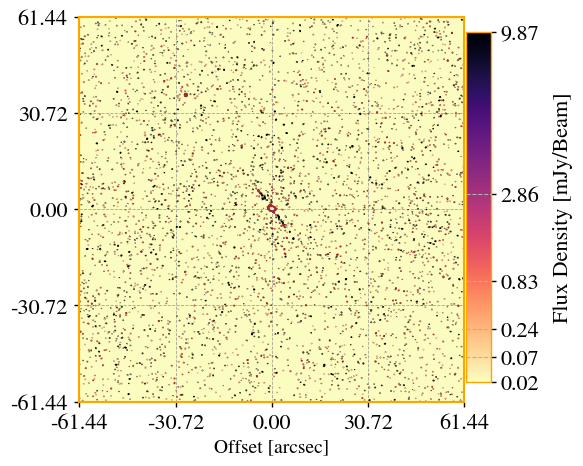

In [109]:
ax=mlibs.eimshow(input_data.filename)

##### Image too large to see the structure of the radio source? 
You can easily crop the image.

  >> Center -->  [1536 1541    0    0]


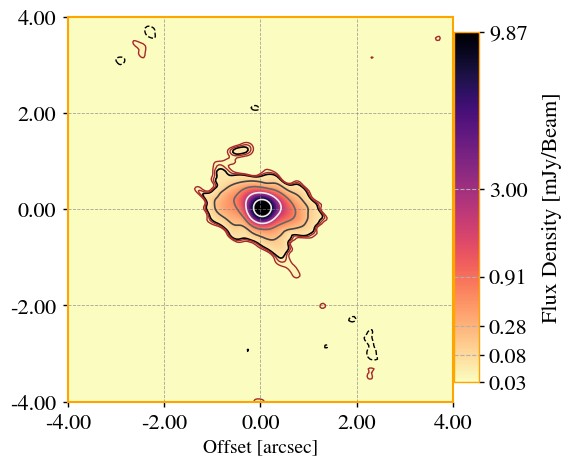

In [110]:
ax=mlibs.eimshow(input_data.filename, 
                 crop=True,box_size=(100),
                 center=None)

Input image is not a string.
Input image is not a string.


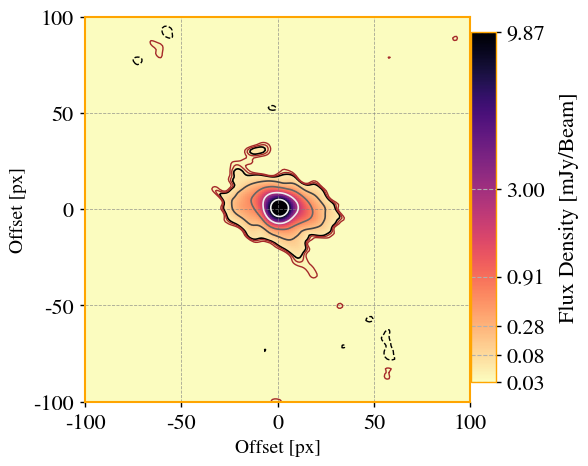

In [111]:
#or also just the data as a numpy array. Axes projection will be pixels. 
ax=mlibs.eimshow(image_data,
                        crop=True,
                        box_size=(100),
                        center=None)


##### There are other several options to customize the plot.

  >> Center -->  [1536 1541    0    0]


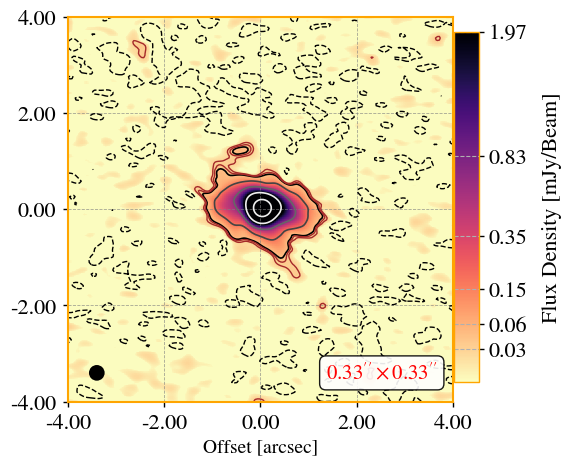

In [112]:
ax=mlibs.eimshow(input_data.filename,
                 add_beam=True,
                 crop=True,box_size=(100),
                 vmin_factor=1.0,vmax_factor=0.1, #level factor (max from peak, and min from std)
                 neg_levels=mlibs.np.asarray([-1]), # negative contours to draw -- which negative std level?
                 CM='magma_r',
       )

  >> Center -->  [1536 1541    0    0]


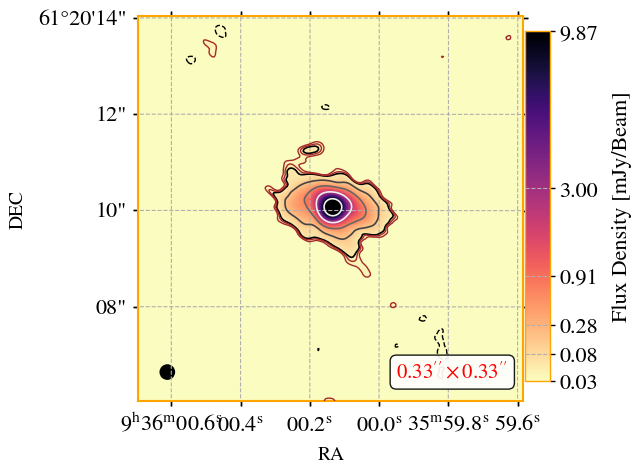

In [113]:
#change the projection of the image.
ax=mlibs.eimshow(input_data.filename,
                 add_beam=True,
                 crop=True,box_size=(100),
                 projection='celestial'
       )

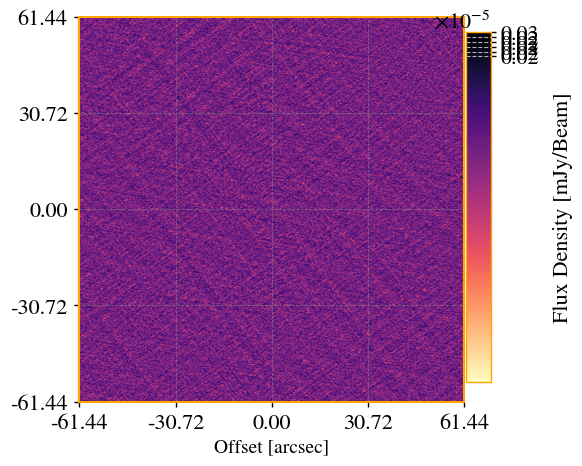

In [114]:
#checking the residual map.
ax=mlibs.eimshow(input_data.residualname,
        vmin_factor=-3.0,vmax_factor=0.99, #level factor (max from peak, and min from std)
        CM='magma_r',add_contours=False # remove contours
       )

### Using the residual map to compute the rms background level. 
If the zoom-in is not computing the rms value properly, you can provide it 
(e.g. use the residual rms):

  >> Center -->  [1536 1541    0    0]


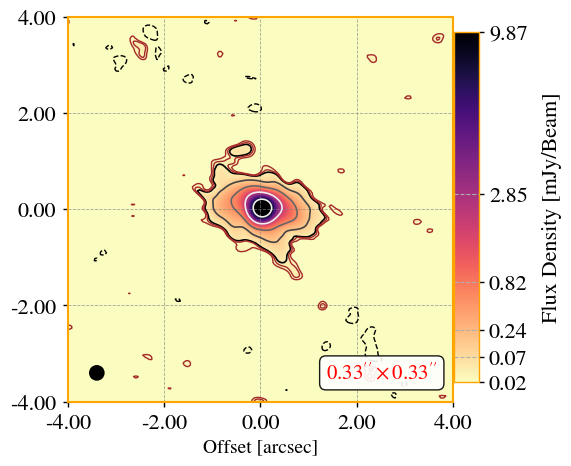

In [115]:
rms = input_data.rms_res

ax=mlibs.eimshow(input_data.filename, rms=rms,
                 vmin_factor=3.0,vmax_factor=0.5, #level factor (max from peak, and min from std)
                 neg_levels=np.asarray([-3]), # negative contours to draw -- which std level?
                 CM='magma_r',crop=True,box_size=(100), # in pixels
                 add_beam=True,
       )

### Add a scale bar in physical units
If you provide at which redshift the source is located, you can also add a scale bar using
`astropy.units` module.

  >> Center -->  [1536 1541    0    0]


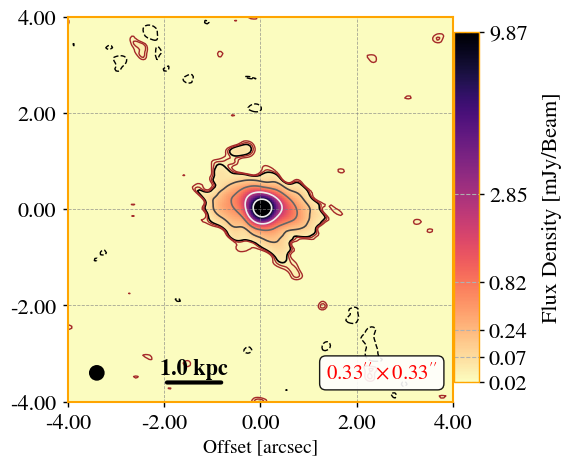

In [116]:
#If you provide at which redshift the source is located, you can also add a scale bar using
# astropy.units module.
ax=mlibs.eimshow(input_data.filename,
                 add_beam=True,
                 rms=rms,
                 crop=True,box_size=(100),
                 vmin_factor=3.0,vmax_factor=0.5, #level factor (max from peak, and min from std)
                 neg_levels=mlibs.np.asarray([-3]), # negative contours to draw -- which negative std level?
                 CM='magma_r',
                 source_distance=mlibs.find_z_NED('UGC5101'), #in z
                 scalebar_length = 1.0*mlibs.u.kpc
       )

## Perform Image Cutouts
If the emission is too small compared to the image size, you can perform a cutout of the image witha `cutout_size` using the function 
`mlibs.cutout_2D_radec`. 


++>> Image File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-image.fits
++>> Residual File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-residual.fits
-->> No PSF File was provided.
  >> Center -->  [1536 1541    0    0]


[1536 1541    0    0]
09:35:51.600, +61.21.11.700, 9.999e+09Hz, I
143.96499999999997 61.35325


<Axes: xlabel='Offset [arcsec]'>

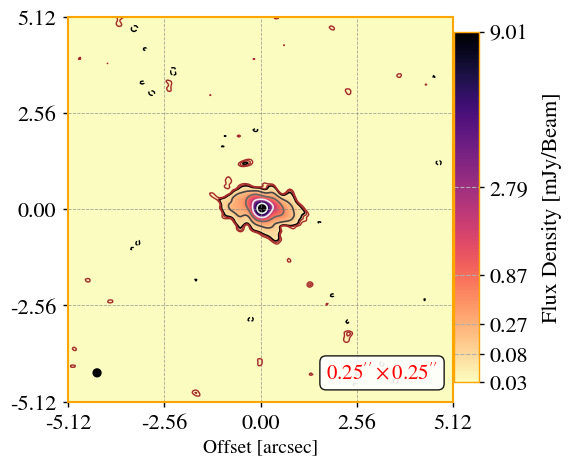

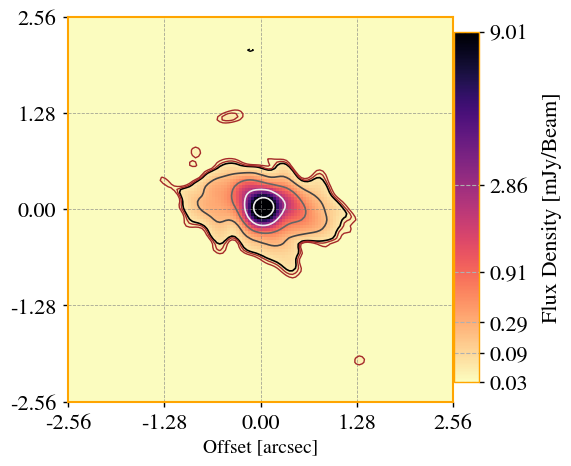

In [117]:
# lets select another image from our list of images. 
idx = 0#select one index from the list. 
input_data=mp.read_data(filename=imagelist[idx],
                        residualname=residuallist[idx])
ax=mlibs.eimshow(input_data.filename,crop=True,box_size=128,add_beam=True)
cutout_size = 128
ra,dec,new_filename = mlibs.cutout_2D_radec(imagename=input_data.filename,
                                            residualname=input_data.residualname,
                                            cutout_size = cutout_size,
                                            special_name='')
mlibs.eimshow(new_filename)

If you have multiple images for the same source, you can use the coordinates from the previous run to cut all the images at the same position.

In [118]:
imagelist_c = []
residuallist_c = []
for i in mlibs.tqdm(range(len(imagelist))):
    _,_,image_c = mlibs.cutout_2D_radec(imagename=imagelist[i],
                                            residualname=residuallist[i],
                                            ra_f=ra,dec_f=dec,
                                            cutout_size = cutout_size,
                                            special_name='')
    imagelist_c.append(image_c)
    residuallist_c.append(image_c.replace('-image.cutout.fits','-residual.cutout.fits'))

100%|██████████| 2/2 [00:00<00:00, 56.20it/s]


In [119]:
imagelist_c

['../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-image.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-image.cutout.fits']

In [120]:
residuallist_c

['../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..0.5-MFS-residual.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/UGC5101_X/selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-residual.cutout.fits']

<a id='image_analysis'></a>

```
 _____           ___                            
|___ /          |_ _|_ __ ___   __ _  __ _  ___ 
  |_ \   _____   | || '_ ` _ \ / _` |/ _` |/ _ \
 ___) | |_____|  | || | | | | | (_| | (_| |  __/
|____/          |___|_| |_| |_|\__,_|\__, |\___|
                                     |___/      
    _                _           _     
   / \   _ __   __ _| |_   _ ___(_)___ 
  / _ \ | '_ \ / _` | | | | / __| / __|
 / ___ \| | | | (_| | | |_| \__ \ \__ \
/_/   \_\_| |_|\__,_|_|\__, |___/_|___/
                       |___/
```

# Basic Image Analysis

Bellow, we provide some details of how to perform basic image analysis, such as:
1. Compute the total integrated flux density from a radio map.
2. Calculate associated uncertainties and the rms of the backgroud.
3. Compute the peak brightness intensity. 
4. Estimate the approximated sizes and areas of the radio emission.
5. Perform a simple source extraction for structural separation.
5. etc
   

Be aware that these functions are in current development and undergoing improvements. If you would like to request some kind of particular analysis, suggest modifications, contribute, point out issues, etc, feel free to contact us or open a new git issue.

## Some functions
Standard tasks that are available and needed to extract properties from images are listed below. 

### Masking
Masking is critical to obtain accurate information of the emission structure and its total integrated flux density. 
In here, we use a conservative threshold based on the median absolute deviation (`mad`), where we use `6 sigma_mad` and from that apply a mask dilation to recover the fainter emission surrounding it. 

You can set another threshold values as well (check examples below).

Relevant arguments:
- `sigma` : median absolute deviation threshold limit, discard intensities lower than that. Default is `6`
- `dilation_size` : The size of the dilation of the mask. Default is `None`, which uses the size of the restoring beam from the header of the interferometric image. This choice is suitable.
- `iterations` : Number of iterations to perform the mask dilation. Default is `2`. Using `dilation_size=None`  and `iterations=2` yields good results. 
- `rms` : the reference rms background level, in which `threshold = rms * sigma`. If `rms=None`, it will be estimated from the image. Note, however, that if there are not enough sampling data points for the background, `rms` will be overestimated. In that case, you need to provide a proper `rms` value, using the residual map (like mentioned before while plotting the images).

Note: Using the default options for the `dilation_size = None` (i.e. beam size) and `iterations=2`, has proved effective for both VLA and e-MERLIN images.

In [121]:
# lets select another image from our list of images. 
idx = -1#select one index from the list. 
input_data=mp.read_data(filename=imagelist_c[idx],
                        residualname=residuallist_c[idx])

++>> Image File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-image.cutout.fits
++>> Residual File: selfcal_image_UGC05101.calibrated.avg12s_trial_1_3072x3072_0.04asec_100000.briggs.multiscale..1.0-MFS-residual.cutout.fits
-->> No PSF File was provided.


In [122]:
# mlibs.mask_dilation??

 ==>  Dilation size is 4 [px]


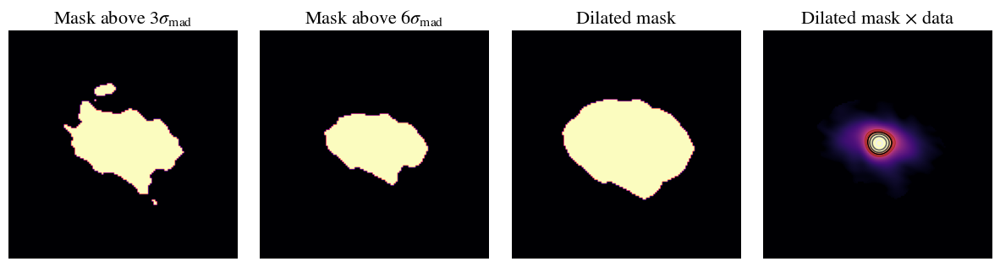

In [123]:
#default options
mask = mlibs.mask_dilation(image=input_data.filename,PLOT=True,sigma=6,dilation_size=None)

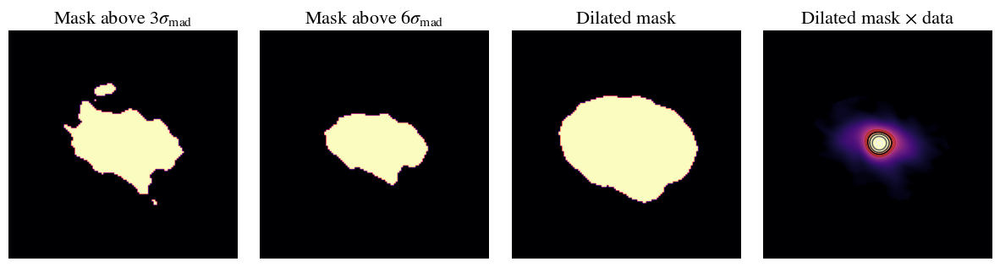

In [124]:
#keeping the threshold, but incresing the dillation size. 
_ = mlibs.mask_dilation(image=input_data.filename,PLOT=True,sigma=6,dilation_size=5)

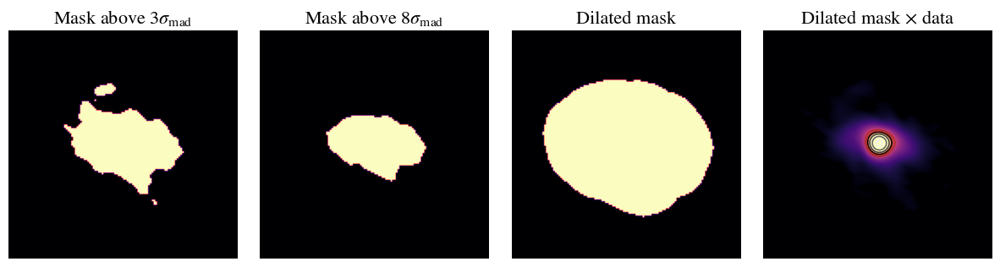

In [125]:
_ = mlibs.mask_dilation(image=input_data.filename,PLOT=True,sigma=8,dilation_size=10)

 ==>  Dilation size is 4 [px]


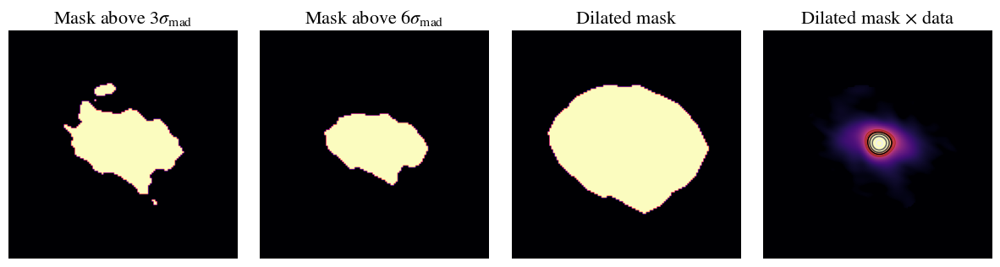

In [126]:
_ = mlibs.mask_dilation(image=input_data.filename,PLOT=True,sigma=6,dilation_size=None,iterations=4)

 ==>  Dilation size is 4 [px]


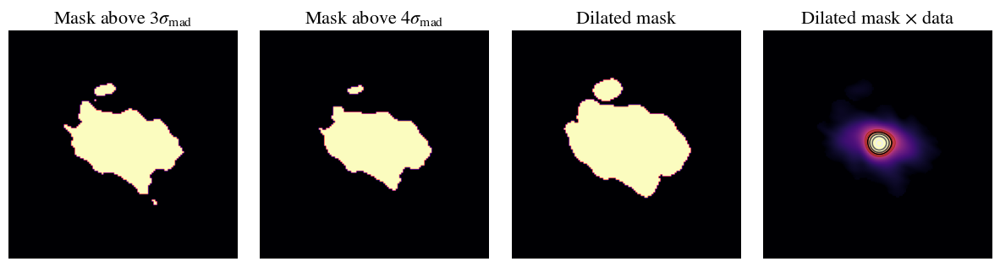

In [127]:
mask = mlibs.mask_dilation(image=input_data.filename,PLOT=True,sigma=4,dilation_size=None,iterations=1)


### `level_statistics()`
Function to compute basic image statistics, such as total flux density and uncertain flux. 

It splits the range of image intensity values in four distinct regions:

1. Inner region: intensities/fluxes within `[peak intensity, 0.1 * peak intensity]`
2. Mid region: intensities/fluxes within `[0.1 * peak intensity, 10 * rms]`
3. Low region: intensities/fluxes within `[10 * rms, 6 * rms]`
4. Uncertain region: intensities/fluxes within `[6 * rms, 3 * rms]`
    
The flux uncertainty using this approach is computed as being the flux from $6 \times \sigma_{\rm mad}$ to $3 \times \sigma_{\rm mad}$.

Note that you do not necessarily have to provide the dilated mask computed previously. It is calculated inside the function, using the default arguments. However, you can change the arguments accordingly, or provide the mask as well, with the `mask` argument. 

In [128]:
# mlibs.level_statistics??

In [129]:
level_stats = mlibs.level_statistics(img=input_data.filename,
                                     mask=None)

 ==>  Dilation size is 4 [px]


In [130]:
f"{level_stats['total_flux']*1000:.2f}+/-{level_stats['uncertain_flux']*1000:.2f}mJy"

'31.50+/-0.23mJy'

### 3.1.3 - Image Shape Analysis
Now, we can calculate global properties of the radio emission, for example:
 - Total integrated flux density
 - Peak brightness
 - Flux density uncertainty
 - Half-light radius $R_{50}$
 - Orientation $PA$
 - Axis ratio $q$

In [131]:
# mlibs.compute_image_properties??

 ==>  Dilation size is 4 [px]
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 31.66 +/- 0.28 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 31.66 +/- 1.58 mJy
Fractional error = 0.05
-----------------------------------------------------------------
16 64 48


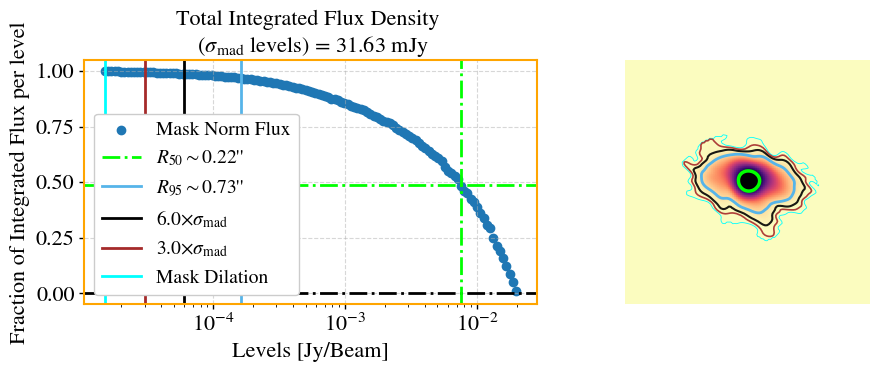

In [132]:
image_measures = mlibs.compute_image_properties(input_data.filename,
                                                input_data.residualname,
                                                # rms=input_data.rms_res,
                                                last_level=1.5)

Optional Arguments: 
 - `last_level=1` means that almost all emission inside the dilated mask should be used in the computation. If using, for example `last_level=3`, a new threshold is calculated inside the masked region, above `3 sigma mad`. If you are using the mask dilation with a conservative threshold, it is 'safe' to use `last_level=1`. 

### All together: The class `radio_image_analysis`

In `morphen.py`, the class `radio_image_analysis` is designed to contain the function calls from the library files within `libs`, which it is practical to perform all the calculations we are interested. 

All possible modifications can be done and calculations of interest can be appended. 

Note: For now, just one function is used, `measures`, from `libs/libs.py`. This function contains relevant routines to quantify properties from radio images.
More features will be added in the future.


In [133]:
# mp.radio_image_analysis??

In [134]:
# mlibs.measures??

In [135]:
import libs as mlibs
from importlib import reload
reload(mlibs)


                                                          ..___|**_
                                                  .|||||||||*+@+*__*++.
                                              _||||.           .*+;].,#_
                                         _|||*_                _    .@@@#@.
                                   _|||||_               .@##@#| _||_
   Radio Morphen              |****_                   .@.,/\..@_.
                             #///#+++*|    .       .@@@;#.,.\@.
                              .||__|**|||||*||*+@#];_.  ;,;_
 Geferson Lucatelli                            +\*_.__|**#
                                              |..      .]]
                                               ;@       @.*.
                                                #|       _;]];|.
                                                 ]_          _+;]@.
                                                 _/_             |]\|    .  _
                                              ...._@* __ .

<module 'libs' from '/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py'>

2024-03-13 07:19:41 - INFO - Computing image level statistics.
2024-03-13 07:19:41 - WARNING - The redshift of the source was not specified.Conversions to physical units will not be performed.
2024-03-13 07:19:41 - INFO -   CALC >> Performing mask dilation.


 ==>  Dilation size is 4 [px]


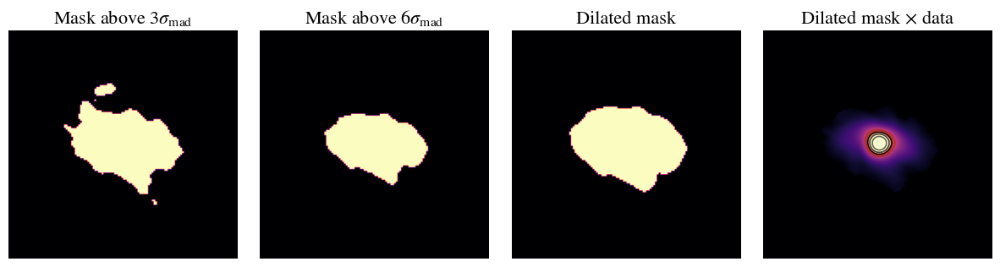

2024-03-13 07:19:41 - INFO -   CALC >> Performing level statistics.
2024-03-13 07:19:41 - INFO -   CALC >> Computing image properties.
2024-03-13 07:19:42 - INFO - +---------------------------+
2024-03-13 07:19:42 - INFO - | Basic Source Properties |
2024-03-13 07:19:42 - INFO - +---------------------------+
2024-03-13 07:19:42 - DEBUG -  ==>  Peak of Flux=19.74 [mJy/beam]
2024-03-13 07:19:42 - DEBUG -  ==>  Total Flux Inside Mask='31.55 [mJy]
2024-03-13 07:19:42 - DEBUG -  ==>  Total Flux Image=31.66 [mJy]
2024-03-13 07:19:42 - DEBUG -  ==>  Half-Light Radii=5.38 [px]
2024-03-13 07:19:42 - DEBUG -  ==>  Total Source Size=17.69 [px]
2024-03-13 07:19:42 - DEBUG -  ==>  Source Global Axis Ratio=0.65
2024-03-13 07:19:42 - DEBUG -  ==>  Source Global PA=167.93 [degrees]
2024-03-13 07:19:42 - DEBUG -  ==>  Inner Axis Ratio=0.90
2024-03-13 07:19:42 - DEBUG -  ==>  Outer Axis Ratio=0.65
2024-03-13 07:19:42 - DEBUG -  ==>  Inner PA=133.74 [degrees]
2024-03-13 07:19:42 - DEBUG -  ==>  Outer PA=

-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 31.55 +/- 0.22 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 31.55 +/- 1.58 mJy
Fractional error = 0.05
-----------------------------------------------------------------
16 64 48


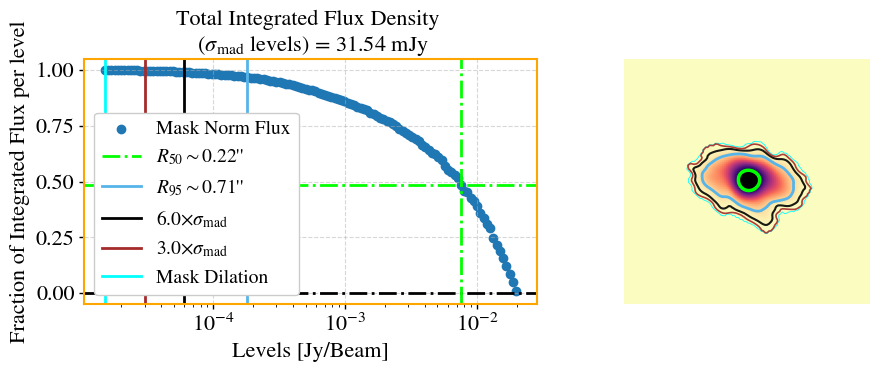

2024-03-13 07:19:42 - INFO -   CALC >> Computing Petrosian properties.


1


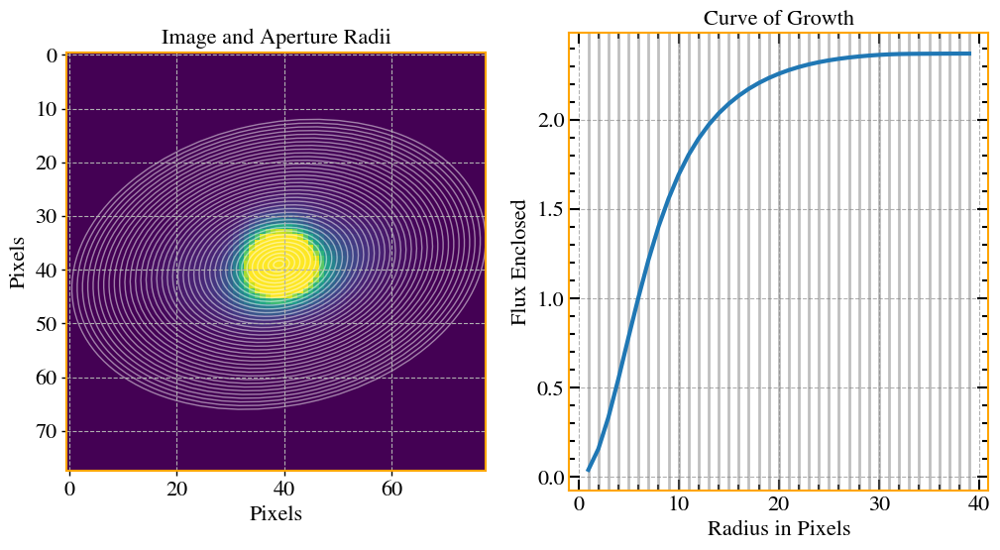

eta = 0.2
epsilon = 2
r_half_light (old vs new) = 6.88
r_total_flux (old vs new) = 29.86
R50 =  6.883576715343068
Rp= 14.932186437287458


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


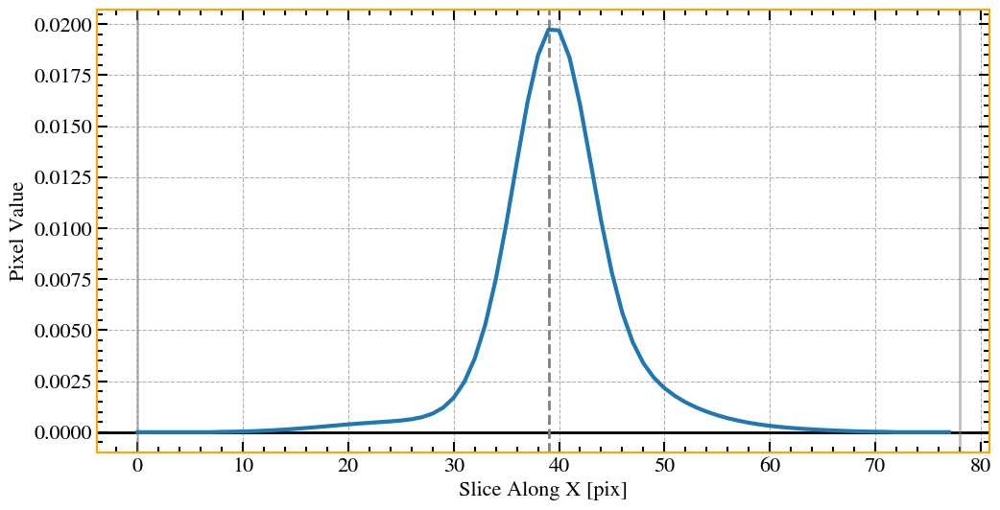

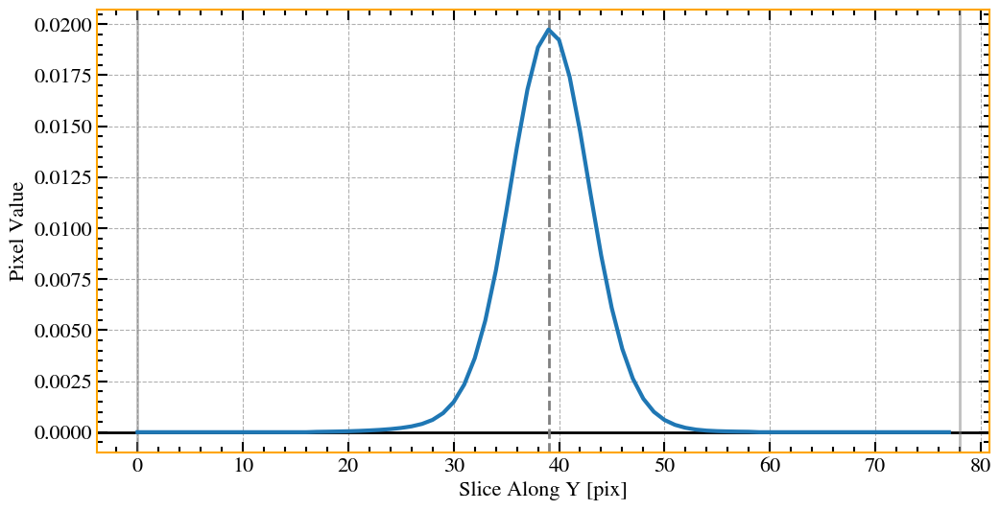

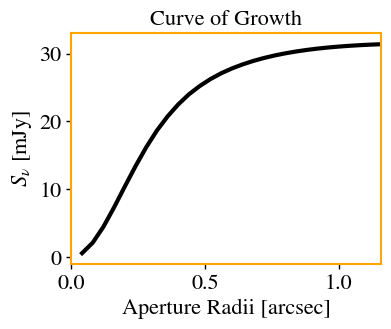

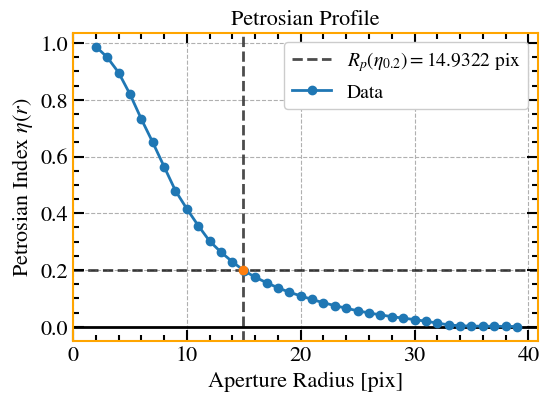

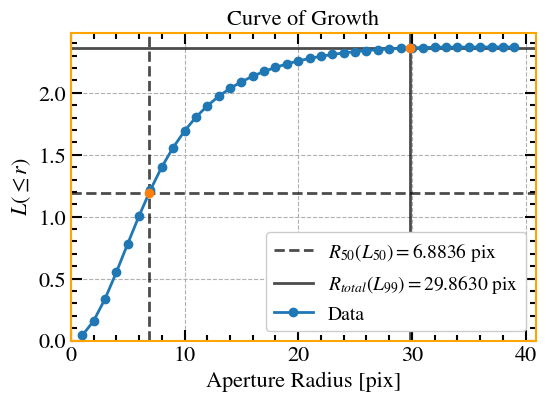

/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


--==>> Computing asymetries...
--==>> Computing image statistics...


100%|██████████| 10/10 [00:00<00:00, 53.12it/s]


In [136]:
analysis = mp.radio_image_analysis(input_data,
                                   do_petro = True,
                                   # z=mlibs.z_d['VV705'],
                                   crop=False,box_size=400,
                                   vmin_factor=3.0,last_level=1.5)

#### Output quantities
Note that multiple quantities are calculated (many of them are for 
testing/debugging purposes). They are stored in `image_measures`. For now, the ones that are relevant are: 
- `total_flux_mask` > Total integrated flux inside the dilated mask
- `uncertain_flux` > Total integrated flux density inside the dilated mask (from `6*rms` to ~ `3*rms`). We can consider this as an uncertainty of the flux density.
- `C50radii` > Half-flux equivalent circular radius of the source.
- `C95radii` > approximated full-size circular radius of the source.
    (at the 95% flux)
- `Rp` > Petrosian radius
- `R50p` > Half-flux radius of the source from Petrosian photometry
- `R90p` > approximated full-size radius of the source (at the 95% flux) from the Petrosian photometry
- `rms_residual` > background rms of the residual image
- `peak_of_flux` > peak brightness of the radio map
- `(x0,y0)` > peak brightness position
- `(x0c,y0c)` > centroid position
- `(x0m,y0m)` > brightness momentum centre position
- `A50` > area enclosing half of the total flux (as multiple of the restoring 
    beam area)
- `A95` > total estimated emission area (as multiple of the restoring beam area)
- `qmi` > median averaged axis ratio of the region enclosing the half-light flux
- `qmo` > median averaged axis ratio of the outer region (from A50)
- `PAmi` > median averaged position angle (in degrees) of the region enclosing 
    the half-light flux
- `PAmo` > median averaged position angle (in degrees) of the outer region 
    (from A50)


All measured quantities are saved in a file in the form `*_stats.csv`, containing the dictionary `analysis.image_measures`.

In [137]:
analysis.image_measures

{'peak_of_flux': 0.019740626215934753,
 'total_flux': 0.031545042043054,
 'inner_flux': 0.02455307633055947,
 'low_flux': 0.0002606284098667116,
 'mid_flux': 0.006458625398371632,
 'uncertain_flux': 0.00027271190425618607,
 'inner_flux_f': 0.7783497735412239,
 'low_flux_f': 0.008262103740771529,
 'mid_flux_f': 0.20474296371381048,
 'uncertain_flux_f': 0.008645159004193983,
 'number_of_beams': 24.712620952912108,
 'n_beams_inner': 3.5265721876799723,
 'n_beams_mid': 13.108202282508575,
 'n_beams_low': 3.3668783527661623,
 'n_beams_uncertain': 7.771766632472089,
 'total_flux_nomask': 0.03165570706116946,
 'total_flux_mask': 0.0315477617500541,
 'max_residual': 1.528512621007394e-05,
 'min_residual': -2.7966172638116404e-05,
 'flux_residual': 3.4635741288385532e-06,
 'flux_error_res': 1.039072238651566e-05,
 'flux_error_res_2': 0.00021643678309341826,
 'flux_error_res_3': 0.0015773918957178831,
 'mad_std_residual': 7.393056729033741e-06,
 'rms_residual': 6.863673052558689e-06,
 'total_flu

#### Check total fluxes densities

In [138]:
# proper estimate for the total integrated flux  (good estimate, even if image contains deconvolution errors). 
# However, sometimes may be underestimated. 
f"{analysis.image_measures['total_flux_mask'] * 1e3:.2f} mJy"


'31.55 mJy'

In [139]:
# upper total integrated flux  (may be overstimated if image contains deconvolution errors)
f"{analysis.image_measures['total_flux_nomask'] * 1e3:.2f}mJy"

'31.66mJy'

In [140]:
#total integrated flux (only uses positive pixel values, ignores negative intensities)
f"{analysis.image_measures['total_flux_levels'] * 1e3:.2f}mJy"

'31.54mJy'

#### Check uncertainties
For well calibrated, good quality images, the uncertainties given below should be very similar 
to each other. 


In [141]:
f"{analysis.image_measures['uncertain_flux']*1e3:.2f}mJy"

'0.27mJy'

In [142]:
f"{analysis.image_measures['flux_error_res']*1e3:.2f}mJy"

'0.01mJy'

In [143]:
f"{analysis.image_measures['flux_error_res_2']*1e3:.2f}mJy"

'0.22mJy'

In [144]:
f"{analysis.image_measures['flux_error_res_3']*1e3:.2f}mJy"

'1.58mJy'

In [145]:
f"{analysis.image_measures['rms_residual'] * 1e6:.2f} mu Jy/beam"

'6.86 mu Jy/beam'

#### Physical Sizes
We can also provide what is the redshift of the source. With that, conversions to physical sizes will be computed. 

If you do know the redshift, use the argument `z`. 

If you do not know, but trust the redshift provided by NED, use the function `find_z_NED`. For example: 

In [146]:
# from astroquery.ipac.ned import Ned
# result_table = Ned.query_object("MCG12-02-001")
# redshift_NED = result_table['Redshift'].data.data

In [147]:
redshift_source = mlibs.find_z_NED("UGC5101")

In [148]:
#In principle, multiple cross-IDs recognised by NED should work.
mlibs.find_z_NED('MCG+10-14-025')

0.039367

In [149]:
mlibs.find_z_NED('LEDA 027292')

0.039367

In [150]:
mlibs.find_z_NED("IRAS 09320+6134")

0.039367

2024-03-13 07:19:51 - INFO - Computing image level statistics.
2024-03-13 07:19:51 - INFO -   CALC >> Performing mask dilation.


 ==>  Dilation size is 4 [px]


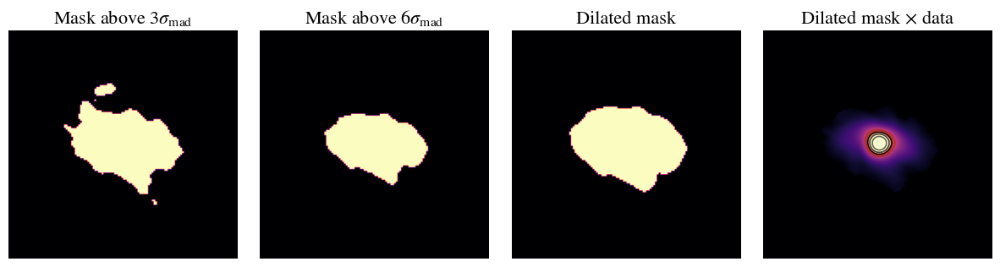

2024-03-13 07:19:52 - INFO -   CALC >> Performing level statistics.
2024-03-13 07:19:52 - INFO -   CALC >> Computing image properties.
2024-03-13 07:19:52 - INFO - +---------------------------+
2024-03-13 07:19:52 - INFO - | Basic Source Properties |
2024-03-13 07:19:52 - INFO - +---------------------------+
2024-03-13 07:19:52 - DEBUG -  ==>  Peak of Flux=19.74 [mJy/beam]
2024-03-13 07:19:52 - DEBUG -  ==>  Total Flux Inside Mask='31.55 [mJy]
2024-03-13 07:19:52 - DEBUG -  ==>  Total Flux Image=31.66 [mJy]
2024-03-13 07:19:52 - DEBUG -  ==>  Half-Light Radii=5.38 [px]
2024-03-13 07:19:52 - DEBUG -  ==>  Total Source Size=17.69 [px]
2024-03-13 07:19:52 - DEBUG -  ==>  Source Global Axis Ratio=0.65
2024-03-13 07:19:52 - DEBUG -  ==>  Source Global PA=167.93 [degrees]
2024-03-13 07:19:52 - DEBUG -  ==>  Inner Axis Ratio=0.90
2024-03-13 07:19:52 - DEBUG -  ==>  Outer Axis Ratio=0.65
2024-03-13 07:19:52 - DEBUG -  ==>  Inner PA=133.74 [degrees]
2024-03-13 07:19:52 - DEBUG -  ==>  Outer PA=

-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 31.55 +/- 0.22 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 31.55 +/- 1.58 mJy
Fractional error = 0.05
-----------------------------------------------------------------
16 64 48


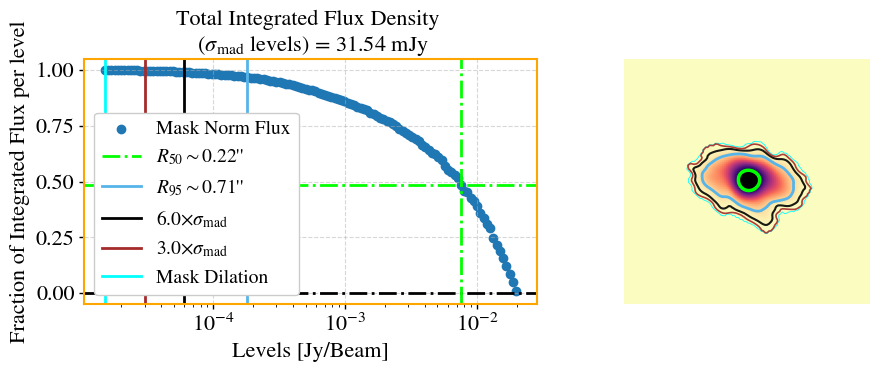

2024-03-13 07:19:53 - INFO -   CALC >> Computing Petrosian properties.


1


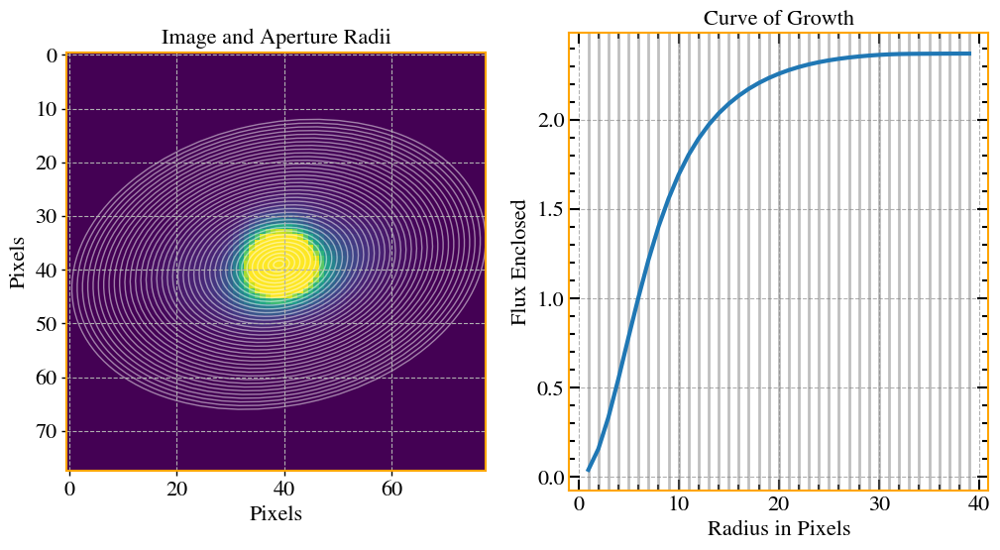

eta = 0.2
epsilon = 2
r_half_light (old vs new) = 6.88
r_total_flux (old vs new) = 29.86
R50 =  6.883576715343068
Rp= 14.932186437287458


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


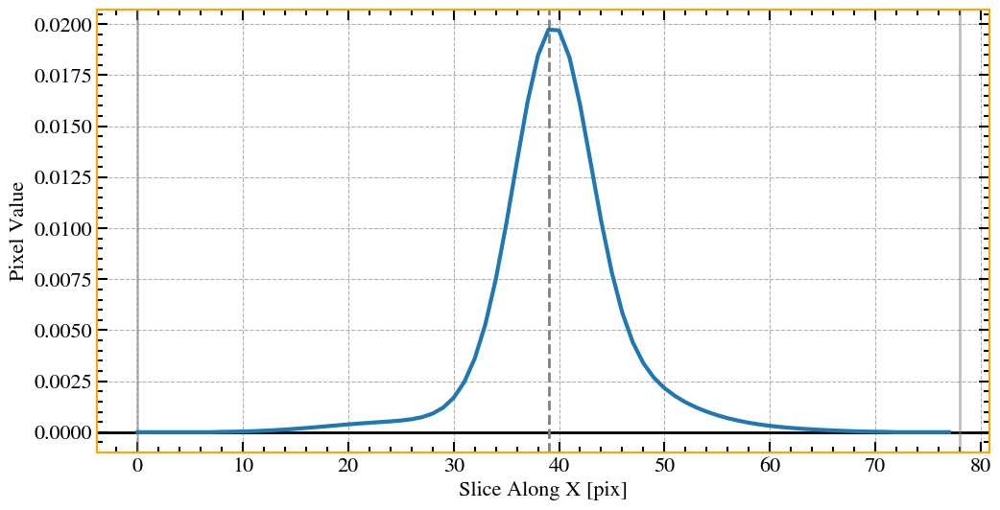

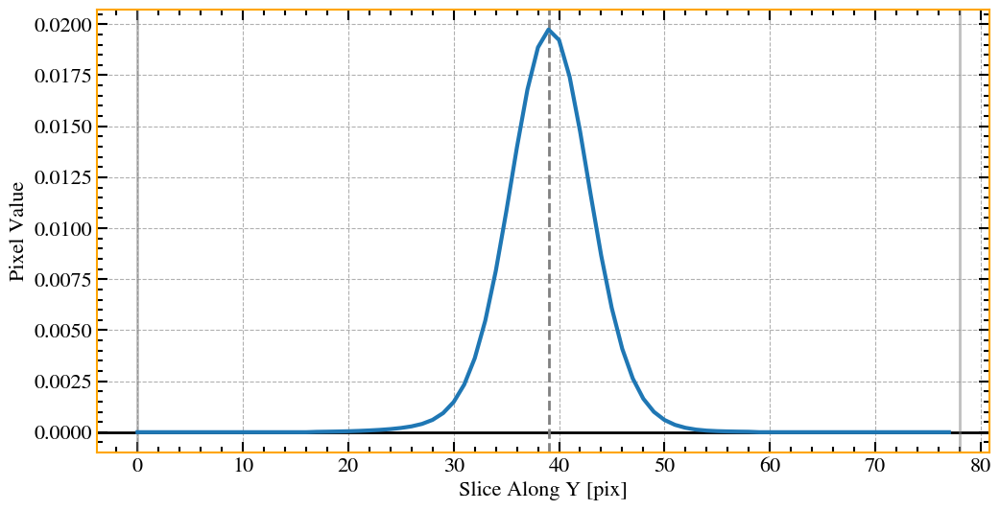

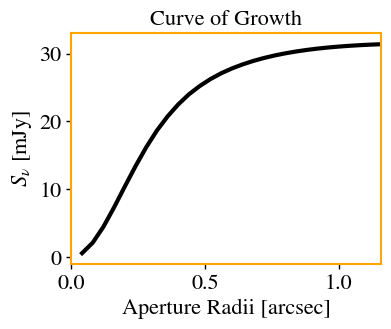

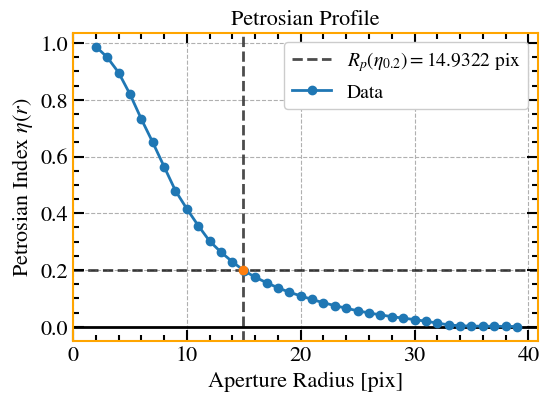

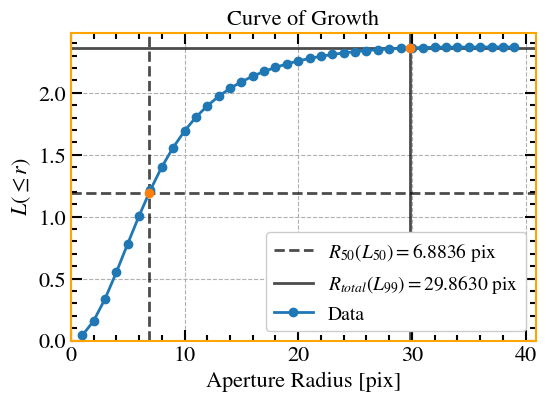

/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


--==>> Computing asymetries...
--==>> Computing image statistics...


100%|██████████| 10/10 [00:00<00:00, 70.83it/s]


In [151]:
analysis = mp.radio_image_analysis(input_data,
                                   do_petro = True,
                                   z=redshift_source,
                                   crop=False,box_size=350,
                                   vmin_factor=3.0,last_level=1.5)

For reference, the function that computes pixel sizes to parsecs is `pixsize_to_pc`:

In [152]:
mlibs.pixsize_to_pc??


Signature: mlibs.pixsize_to_pc(z, cell_size, Om0=0.308)
Docstring: <no docstring>
Source:   
def pixsize_to_pc(z, cell_size, Om0=0.308):
    h = 67.8  # * (h1 + h2) / 2
    cosmo = FlatLambdaCDM(H0=h, Om0=Om0)
    d_A = cosmo.angular_diameter_distance(z=z)
    # print('D_a = ', d_A)  # 946.9318492873492 Mpc
    theta = cell_size * u.arcsec
    distance_pc = (theta * d_A).to(u.pc, u.dimensionless_angles())  # unit is Mpc only now

    # print('Linear Distance = ', distance_pc)  # 3.384745689510495 Mpc
    return (distance_pc.value)
File:      /media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/libs/libs.py
Type:      function

In [153]:
# The pixel size is stored in:
f"{analysis.image_measures['pix_to_pc']} pc"

'32.1803902504463 pc'

In [154]:
# # print(f"Redshift of VV705 = {z_d['VV705']}")
# pix_to_pc = mlibs.pixsize_to_pc(z=mlibs.find_z_NED("MCG12-02-001"),
#                           cell_size=mlibs.get_cell_size(input_data.filename))

In [155]:
# Now, we can get the half-light circular radii of the source in pc:
f"{analysis.image_measures['C50radii']*analysis.image_measures['pix_to_pc']:.1f} pc"

'173.2 pc'

In [156]:
# and the full size circular radii:
f"{analysis.image_measures['C95radii']*analysis.image_measures['pix_to_pc']:.1f} pc"

'569.2 pc'

In [157]:
analysis.image_measures

{'peak_of_flux': 0.019740626215934753,
 'total_flux': 0.031545042043054,
 'inner_flux': 0.02455307633055947,
 'low_flux': 0.0002606284098667116,
 'mid_flux': 0.006458625398371632,
 'uncertain_flux': 0.00027271190425618607,
 'inner_flux_f': 0.7783497735412239,
 'low_flux_f': 0.008262103740771529,
 'mid_flux_f': 0.20474296371381048,
 'uncertain_flux_f': 0.008645159004193983,
 'number_of_beams': 24.712620952912108,
 'n_beams_inner': 3.5265721876799723,
 'n_beams_mid': 13.108202282508575,
 'n_beams_low': 3.3668783527661623,
 'n_beams_uncertain': 7.771766632472089,
 'total_flux_nomask': 0.03165570706116946,
 'total_flux_mask': 0.0315477617500541,
 'max_residual': 1.528512621007394e-05,
 'min_residual': -2.7966172638116404e-05,
 'flux_residual': 3.4635741288385532e-06,
 'flux_error_res': 1.039072238651566e-05,
 'flux_error_res_2': 0.00021643678309341826,
 'flux_error_res_3': 0.0015773918957178831,
 'mad_std_residual': 7.393056729033741e-06,
 'rms_residual': 6.863673052558689e-06,
 'total_flu

In [158]:
analysis.image_measures

{'peak_of_flux': 0.019740626215934753,
 'total_flux': 0.031545042043054,
 'inner_flux': 0.02455307633055947,
 'low_flux': 0.0002606284098667116,
 'mid_flux': 0.006458625398371632,
 'uncertain_flux': 0.00027271190425618607,
 'inner_flux_f': 0.7783497735412239,
 'low_flux_f': 0.008262103740771529,
 'mid_flux_f': 0.20474296371381048,
 'uncertain_flux_f': 0.008645159004193983,
 'number_of_beams': 24.712620952912108,
 'n_beams_inner': 3.5265721876799723,
 'n_beams_mid': 13.108202282508575,
 'n_beams_low': 3.3668783527661623,
 'n_beams_uncertain': 7.771766632472089,
 'total_flux_nomask': 0.03165570706116946,
 'total_flux_mask': 0.0315477617500541,
 'max_residual': 1.528512621007394e-05,
 'min_residual': -2.7966172638116404e-05,
 'flux_residual': 3.4635741288385532e-06,
 'flux_error_res': 1.039072238651566e-05,
 'flux_error_res_2': 0.00021643678309341826,
 'flux_error_res_3': 0.0015773918957178831,
 'mad_std_residual': 7.393056729033741e-06,
 'rms_residual': 6.863673052558689e-06,
 'total_flu

In [159]:
print(analysis.image_measures['C50radii'])#half-light radii source size in pixels
print(analysis.image_measures['C95radii'])#total source size in pixels

5.382025607773058
17.688940559532284


### Asymmetry and Concentration

In [160]:
analysis.image_measures['A1']

0.168725563457586

In [161]:
#internal implementation
analysis.image_measures['C1']

0.5214542743815872

In [162]:
# using PetroFit
analysis.image_measures['C1p']

0.520097464248007

## Compare fractional radius using intensity levels growth curve, spline and PetroFit.

 ==>  Dilation size is 4 [px]
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 31.66 +/- 0.28 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 31.66 +/- 1.58 mJy
Fractional error = 0.05
-----------------------------------------------------------------
16 64 48


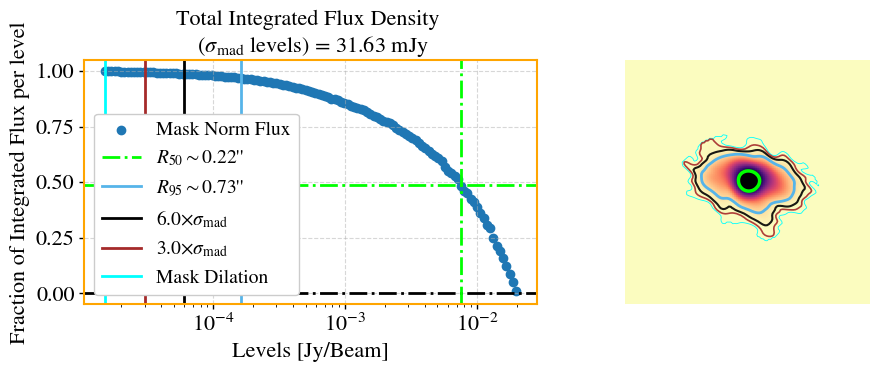

In [163]:
image_measures = mlibs.compute_image_properties(input_data.filename,
                                                input_data.residualname,
                                                # rms=input_data.rms_res,
                                                last_level=1.5)

In [164]:
levels, fluxes, _, _, _, results_measures = image_measures

In [165]:
Lgrow = np.cumsum(fluxes)
Lgrow_norm = Lgrow / fluxes.sum()

In [166]:
input_data.image_data_2D.max()

0.019740626215934753

In [167]:
_radii = []
for i in range(0, len(levels)):
    mask_at_level_i = input_data.image_data_2D >= levels[i]
    circular_radii = np.sqrt(np.sum(mask_at_level_i) / np.pi)
    print(circular_radii)
    _radii.append(circular_radii)
radii = np.asarray(_radii)

0.5641895835477563
1.381976597885342
1.8712051592547776
2.256758334191025
2.5854414729132054
2.876813695875796
3.0901936161855166
3.385137501286538
3.742410318509555
3.8678889139475245
4.1073621666150775
4.296739856991561
4.54864184146723
4.720348719413148
4.853342309955121
5.077706251929807
5.140011726956917
5.382025607773058
5.641895835477563
5.781222885281108
5.917270272703197
6.023896332520351
6.180387232371033
6.4820448144285745
6.627726932618989
6.770275002573076
6.863662517577698
7.001408606295148
7.203090409536582
7.334464586120832
7.527227892173502
7.694520051971082
7.817640190446719
7.978845608028654
8.117274569709014
8.234075889688375
8.42514715711158
8.593479713983122
8.79484521425256
8.95623198216277
9.044647077096718
9.218933756735217
9.373021315815206
9.557977680176279
9.706684619910241
9.83698151873187
10.124020118074668
10.31094088749354
10.433694507453072
10.585134856802455
10.764051215546116
10.896310731002211
11.141851534268367
11.32602684669552
11.507254783503184
1

In [168]:
np.sum(mask_at_level_i)

2839

In [169]:
len(radii)

128

[]

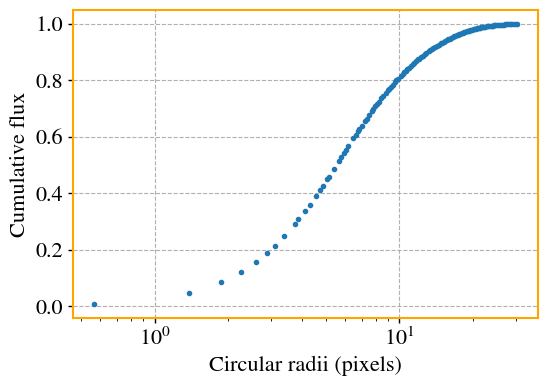

In [170]:
mlibs.plt.plot(radii,Lgrow_norm,'.')
mlibs.plt.xlabel('Circular radii (pixels)')
mlibs.plt.ylabel('Cumulative flux')
mlibs.plt.semilogx()

In [171]:
from scipy.interpolate import interp1d

def find_fractional_radius(cumulative_flux, radii, fraction):
    """
    Calculate the radius that encloses a given fraction of the total flux.
    
    Parameters:
    - cumulative_flux: numpy array of cumulative flux densities
    - radii: numpy array of radii corresponding to the cumulative flux densities
    - fraction: the fraction of the total flux for which to calculate the radius
    
    Returns:
    - radius_at_fraction: the radius that encloses the specified fraction of the total flux
    """
    # Ensure the fraction is between 0 and 1
    if not (0 < fraction < 1):
        raise ValueError("Fraction must be between 0 and 1.")
    
    # Calculate the total flux to find the target flux for the given fraction
    total_flux = cumulative_flux[-1]
    target_flux = total_flux * fraction
    
    # Use spline interpolation to create a smooth function of cumulative flux vs radius
    spline = interp1d(cumulative_flux, radii, kind='cubic')
    
    # Use the interpolated function to find the radius for the target flux
    radius_at_fraction = spline(target_flux)
    
    return radius_at_fraction



In [172]:
fraction = 0.90  

fractional_radius = find_fractional_radius(Lgrow_norm, radii, fraction)
print("Fractional Radius:", fractional_radius)

Fractional Radius: 13.042905978457828


In [173]:
results_measures['C90radii']

13.528790949515026

In [174]:
analysis.image_measures['R90p']

16.332266453290657

### Breaking the Radio emission into multiple components
Now, we describe how to break the radio emission into multiple components, using a source extraction algorithm.

In order this to work, some assumptions need to be made.
1. Using the same interferometric visibility, images with different angular resolutions can be recovered. One must be used as the reference image for the source detection. At the current version, is upt to you to choose the reference image.
2. In the same way, a reference mask must be provided. A good choice is to use the mask from the image restored with the largest restoring beam (highest sensitivity).


From the reference detection mask, the algorithm will create relevant sub-masks for each detected structure, and also dilate those masks. The dilation contain two constraints:
1. Overlap between the sub-masks is not allowed.
2. The maximum dilation is limited by the boundaries of the reference mask (largest).

In this example, we are going to use NGC7674, a classic example of a double-lobed radio galaxy, morphologically classified as Seyfer 2.


In [182]:
# First, define the path to the data.
root_path = '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/'
#To easily list files in a directory, use the glob module, setting a prefix of your images.
# In this example, images produced by WSClean have the prefix '-MFS-image.fits'
prefix_images = '*MFS-image.fits'
imagelist = mlibs.glob.glob(root_path+prefix_images)

### Sorting a list of images by beam-size. 

imagelist,residuallist = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist,
                                 return_df = False)
    

100%|██████████| 3/3 [00:00<00:00, 77.23it/s]

0 >> final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-image.fits
1 >> final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-1.0-MFS-image.fits
2 >> final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.fits


In [183]:
# lets select another image from our list of images. 
idx = 0#select one index from the list. 
input_data=mp.read_data(filename=imagelist[idx],
                        residualname=residuallist[idx])

++>> Image File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-image.fits
++>> Residual File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-residual.fits
-->> No PSF File was provided.


[531 466   0   0]
23:27:56.7097, +08.46.44.1320, 1.49995e+10Hz, I
351.98629041666663 8.778925555555556


<Axes: xlabel='Offset [arcsec]'>

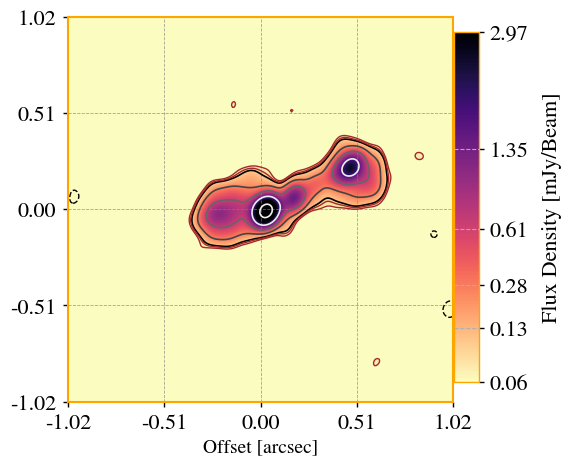

In [184]:
cutout_size = 256
ra,dec,new_filename = mlibs.cutout_2D_radec(imagename=input_data.filename,
                                            residualname=input_data.residualname,
                                            cutout_size = cutout_size,
                                            special_name='')
mlibs.eimshow(new_filename)

In [186]:
imagelist_c = []
residuallist_c = []
for i in mlibs.tqdm(range(len(imagelist))):
    _,_,image_c = mlibs.cutout_2D_radec(imagename=imagelist[i],
                                            residualname=residuallist[i],
                                            ra_f=ra,dec_f=dec,
                                            cutout_size = cutout_size,
                                            special_name='')
    imagelist_c.append(image_c)
    residuallist_c.append(image_c.replace('-image.cutout.fits','-residual.cutout.fits'))

100%|██████████| 3/3 [00:00<00:00, 55.80it/s]


In [187]:
imagelist_c

['../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-image.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-1.0-MFS-image.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutout.fits']

In [188]:
residuallist_c

['../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-residual.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-1.0-MFS-residual.cutout.fits',
 '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-residual.cutout.fits']

++>> Image File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutout.fits
++>> Residual File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-residual.cutout.fits
-->> No PSF File was provided.
 ==>  Dilation size is 7 [px]


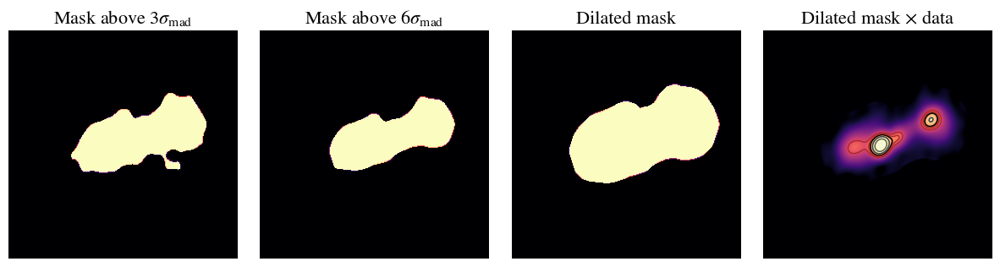

In [190]:
# lets generate the largest mask.
idx = -1 #select the index from the lowest resolution image.
input_data=mp.read_data(filename=imagelist_c[idx],
                        residualname=residuallist_c[idx])

rms = mlibs.mad_std(input_data.residual_data_2D)
_, mask = mlibs.mask_dilation(input_data.filename, 
                              PLOT=True,dilation_type='disk',
                              sigma=6, iterations=2, dilation_size=None)


Now, lets make a catalog of sources.

In [191]:
import libs as mlibs
from importlib import reload
reload(mlibs)


                                                          ..___|**_
                                                  .|||||||||*+@+*__*++.
                                              _||||.           .*+;].,#_
                                         _|||*_                _    .@@@#@.
                                   _|||||_               .@##@#| _||_
   Radio Morphen              |****_                   .@.,/\..@_.
                             #///#+++*|    .       .@@@;#.,.\@.
                              .||__|**|||||*||*+@#];_.  ;,;_
 Geferson Lucatelli                            +\*_.__|**#
                                              |..      .]]
                                               ;@       @.*.
                                                #|       _;]];|.
                                                 ]_          _+;]@.
                                                 _/_             |]\|    .  _
                                              ...._@* __ .

<module 'libs' from '/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py'>

In [192]:
idx = 0 #select the index of the detection image.
input_data_detection=mp.read_data(filename=imagelist_c[idx],
                        residualname=residuallist_c[idx])

++>> Image File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-image.cutout.fits
++>> Residual File: final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..-2.0-MFS-residual.cutout.fits
-->> No PSF File was provided.


In [193]:
input_data_detection.image_data_2D

array([[-5.83602423e-06, -9.88807187e-06, -1.25616889e-05, ...,
        -3.85595158e-05, -3.69760564e-05, -3.37003839e-05],
       [-4.84703605e-06, -8.16793181e-06, -1.02375179e-05, ...,
        -3.90771020e-05, -3.70617818e-05, -3.33868666e-05],
       [-3.86946340e-06, -6.43636849e-06, -7.86873079e-06, ...,
        -3.84102495e-05, -3.60185986e-05, -3.20392501e-05],
       ...,
       [-1.97806548e-05, -1.99039350e-05, -1.97662357e-05, ...,
         1.33241956e-05,  1.63139302e-05,  1.85074477e-05],
       [-1.84433138e-05, -1.76290578e-05, -1.65202437e-05, ...,
         1.78942028e-05,  2.13170806e-05,  2.37449367e-05],
       [-1.65811234e-05, -1.49715879e-05, -1.30319440e-05, ...,
         2.16008029e-05,  2.53830858e-05,  2.80051790e-05]])

Deblending:   0%|          | 0/1 [00:00<?, ?it/s]

0
1
2


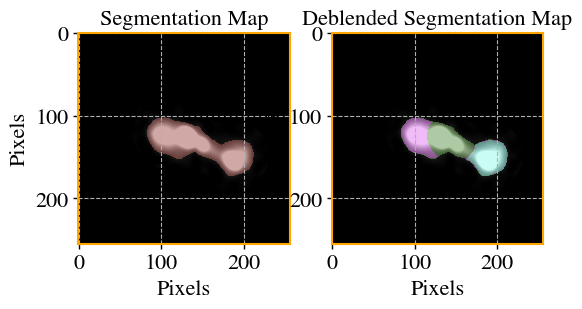

In [205]:
cat, segm, segm_deblend = mlibs.make_catalog(image=input_data_detection.image_data_2D*mask,
                                       threshold=6.0 * input_data_detection.rms_res,
                                       deblend=True,
                                    #    kernel_size=7,#this was deprecated in the new version of photutils/petrofit
                                    #    fwhm=3, #this was deprecated in the new version of photutils/petrofit
                                       npixels=int(mlibs.beam_area2(input_data_detection.filename)*1.0),
                                       nlevels = 64,
                                       plot=True, 
                                       vmax=0.1*input_data_detection.image_data_2D.max(),
                                       vmin=0.1 * input_data_detection.rms_res)
indices = mlibs.order_cat(cat, key='segment_flux', reverse=True)
masks_deblended = []
for k in range(len(indices)):
    print(k)
    masks_deblended.append(segm_deblend == segm_deblend.labels[indices[k]])
#         idx = sorted_idx_list[0]  # index 0 is largest

In [206]:
cat

<photutils.segmentation.catalog.SourceCatalog>
Length: 3
labels: [1 2 3]

If we have different images, we can use the detection masks and perform multi-structure analysis to all images using those sub-masks as a reference (i.e. alike forced photometry).

  0%|          | 0/1 [00:00<?, ?it/s]WARNING: FITSFixedWarning: The WCS transformation has more axes (4) than the image it is associated with (2) [astropy.wcs.wcs]


Using RMS from residual
     >> CALC: Performing mask dilation.
 ==>  Dilation size is 7 [px]


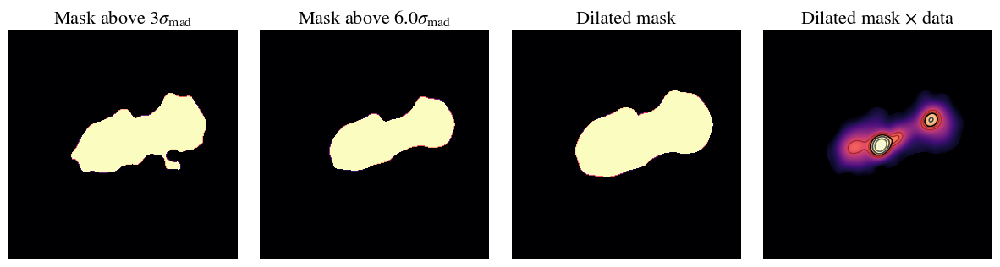

     >> CALC: Performing level statistics.
     >> CALC: Computing image properties.
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 17.35 +/- 0.19 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 17.35 +/- 0.87 mJy
Fractional error = 0.05
-----------------------------------------------------------------
32 128 96


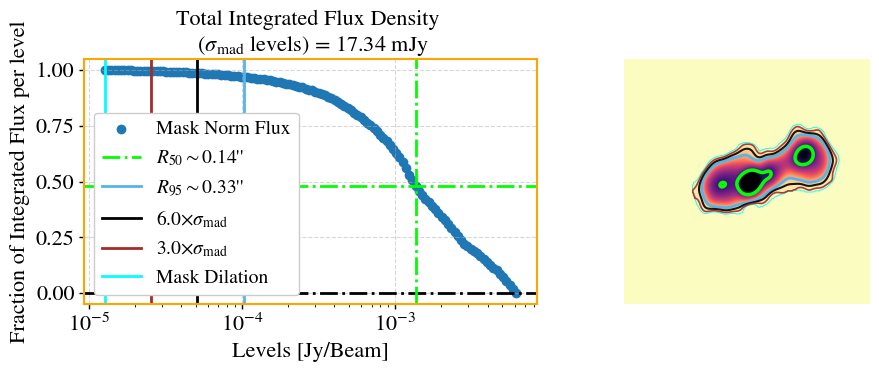

     >> CALC: Computing Petrosian properties.
1


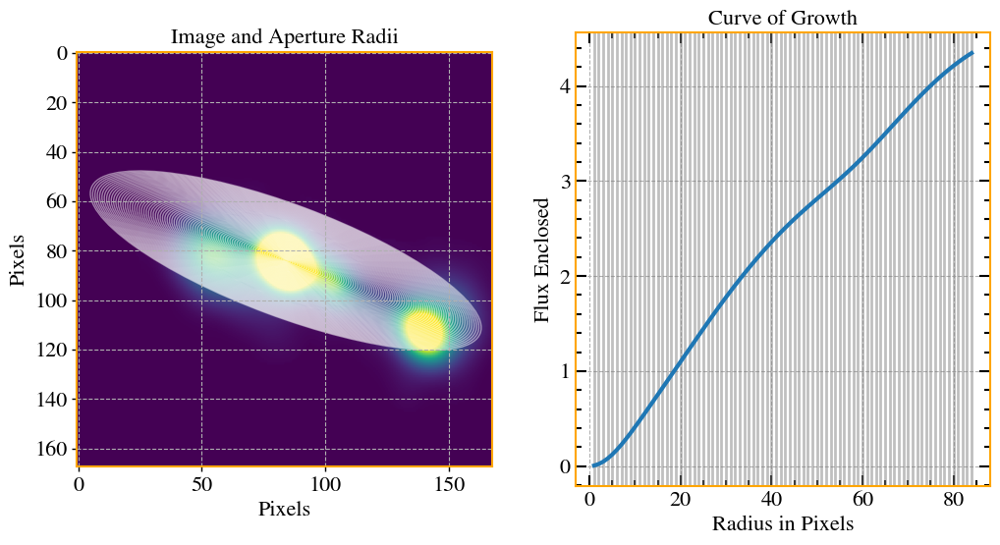

Rlast     >>  84
Rp        >>  nan
Rtotal    >>  nan
1


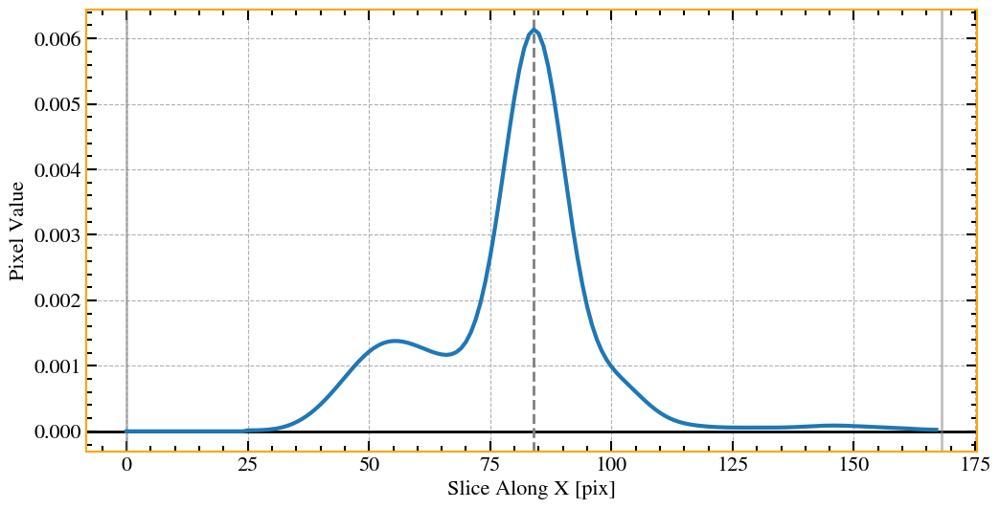

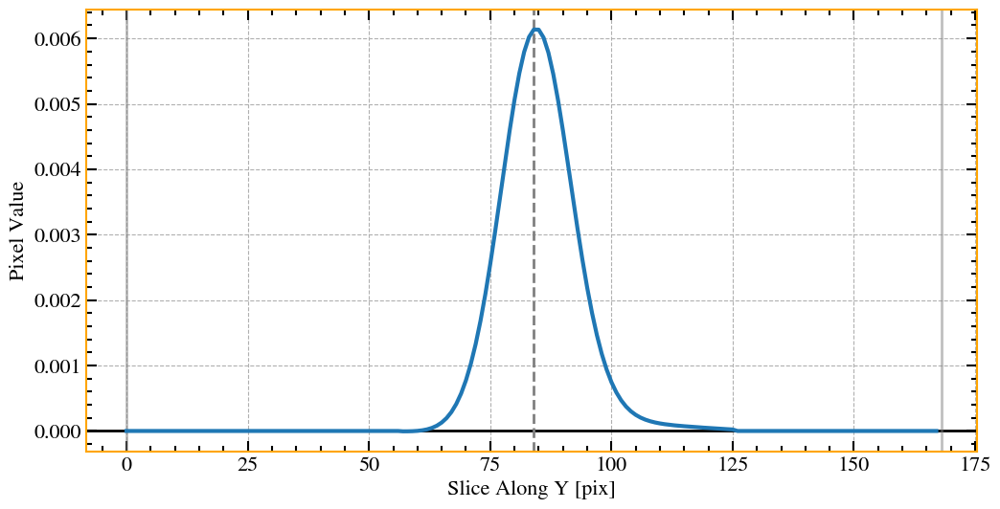

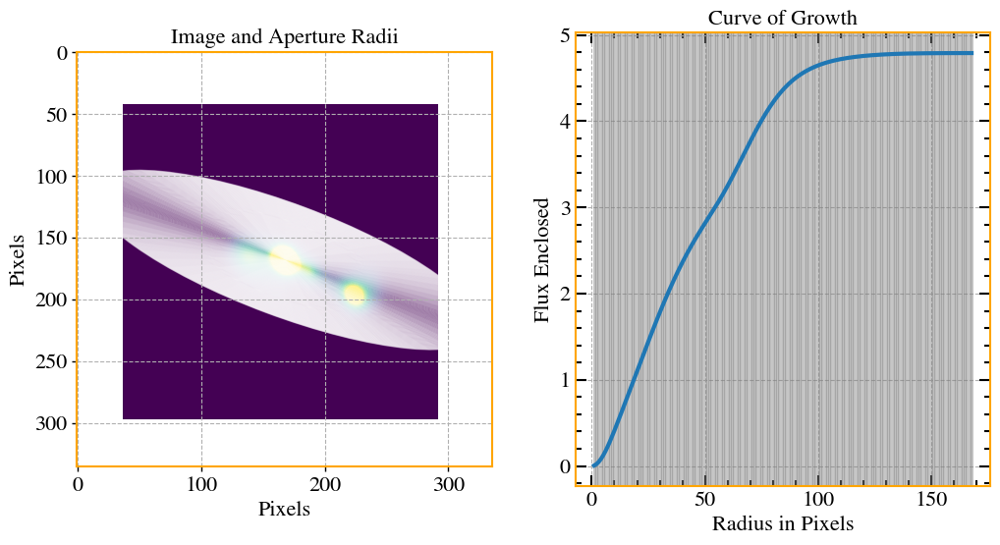

Rlast     >>  168
Rp        >>  90.93978795759152
Rtotal    >>  nan
1


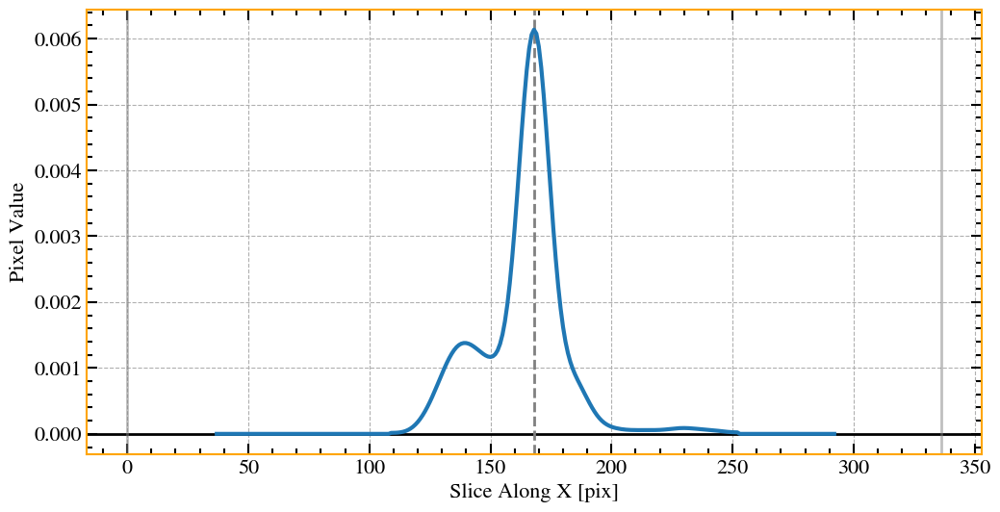

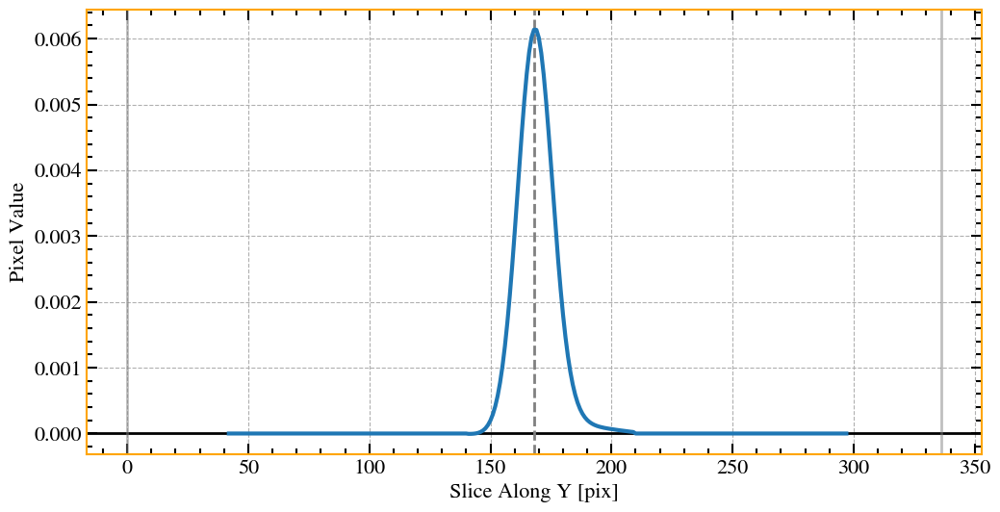

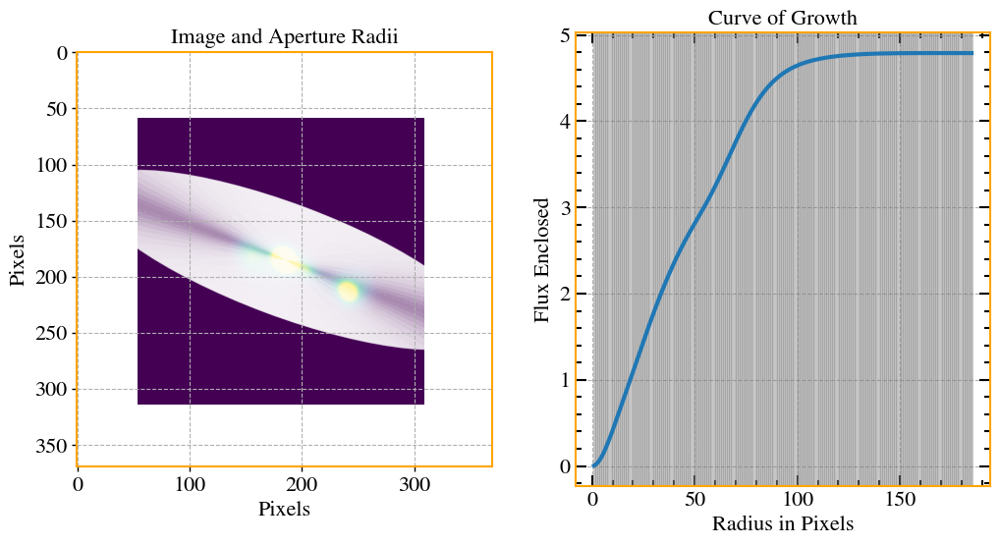

eta = 0.25
epsilon = 2
r_half_light (old vs new) = 41.21
r_total_flux (old vs new) = 165.79
R50 =  41.20785123870317
Rp= 87.35458257884824


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


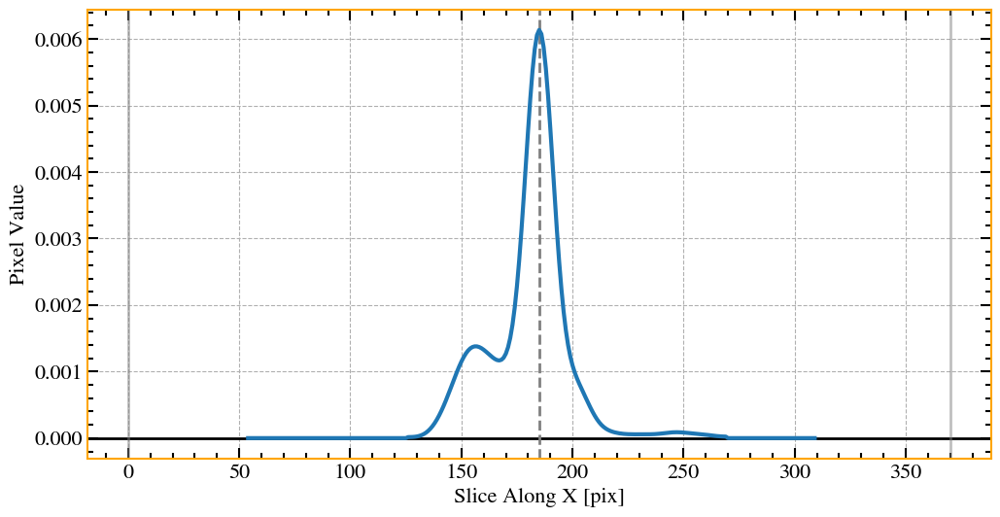

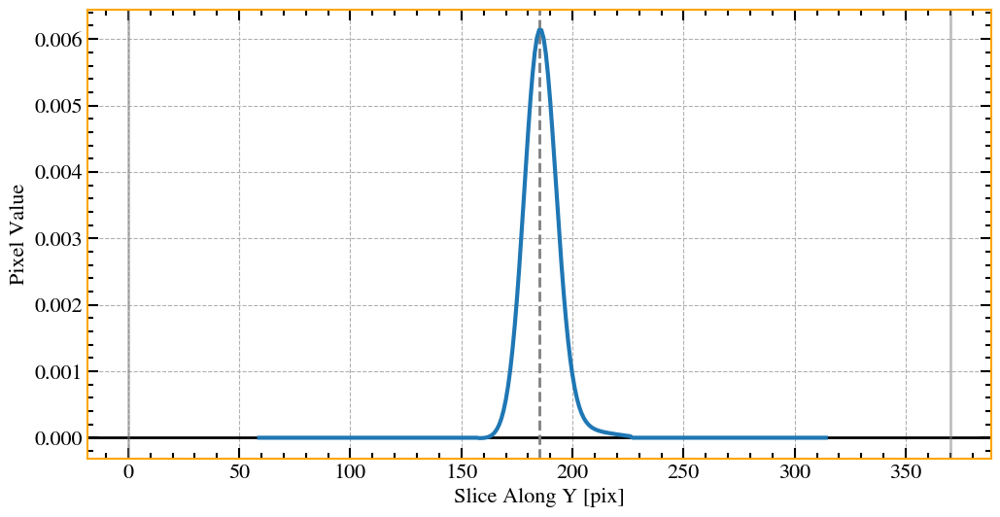

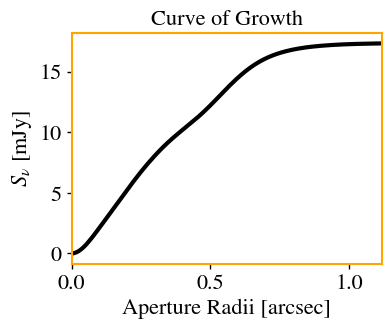

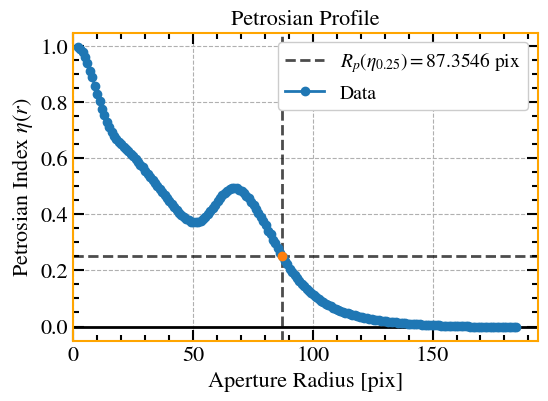

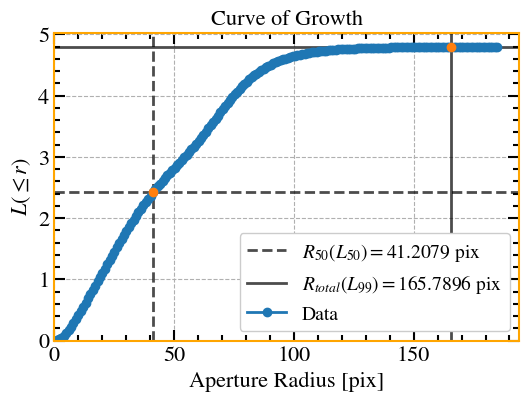

/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


--==>> Computing image statistics...


100%|██████████| 10/10 [00:00<00:00, 48.35it/s]


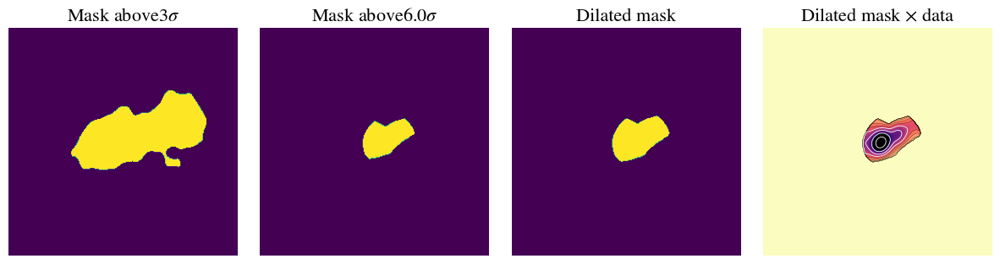

     >> CALC: Performing level statistics.
     >> CALC: Computing image properties.
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 8.93 +/- 0.04 mJy
Fractional error = 0.00
Flux Density and error (quadrature total): 
Flux Density = 8.93 +/- 0.45 mJy
Fractional error = 0.05
-----------------------------------------------------------------
32 128 96
non real ellipse


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:168: RuntimeWarning: Mean of empty slice.
  remove_indexes = np.where(np.logical_or(abs(y - y.mean()) >
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:169: RuntimeWarning: Mean of empty slice.
  abs(y - y.mean()).mean() * 1.5, \
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:170: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()) >
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:171: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()).mean() * 1.5) == True)[0]
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/

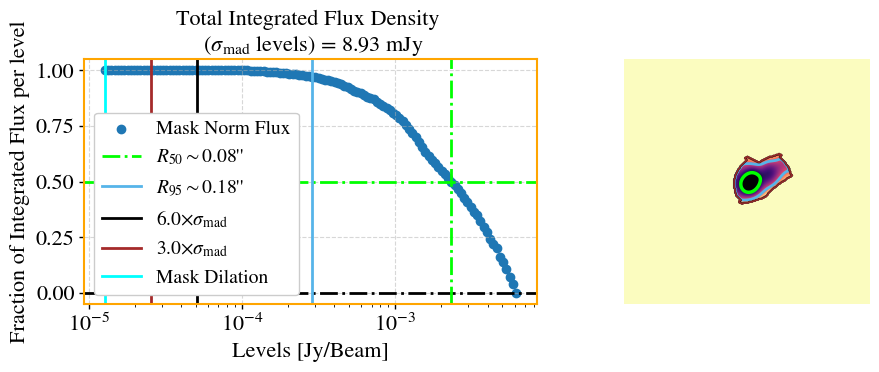

     >> CALC: Computing Petrosian properties.
1


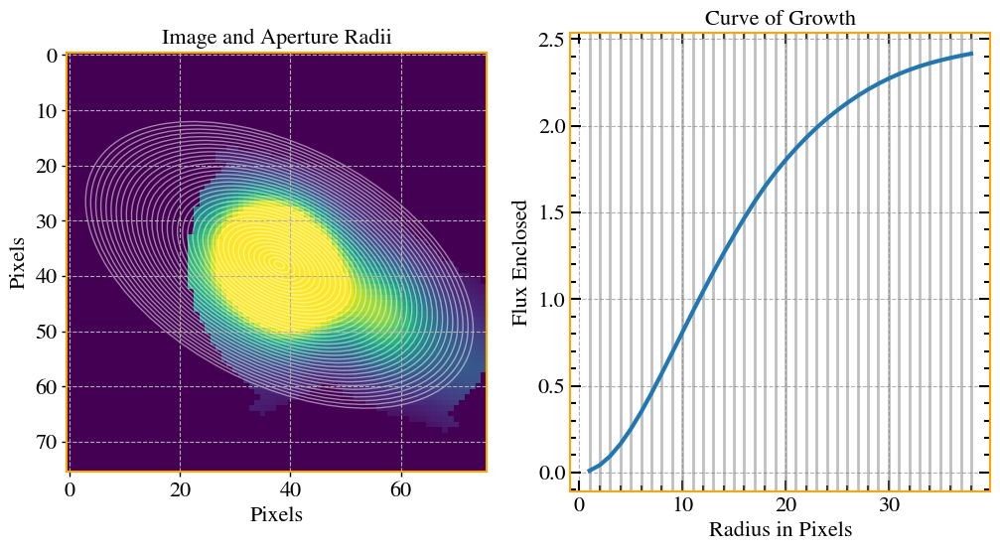

Rlast     >>  38
Rp        >>  29.98039607921584
Rtotal    >>  nan
1


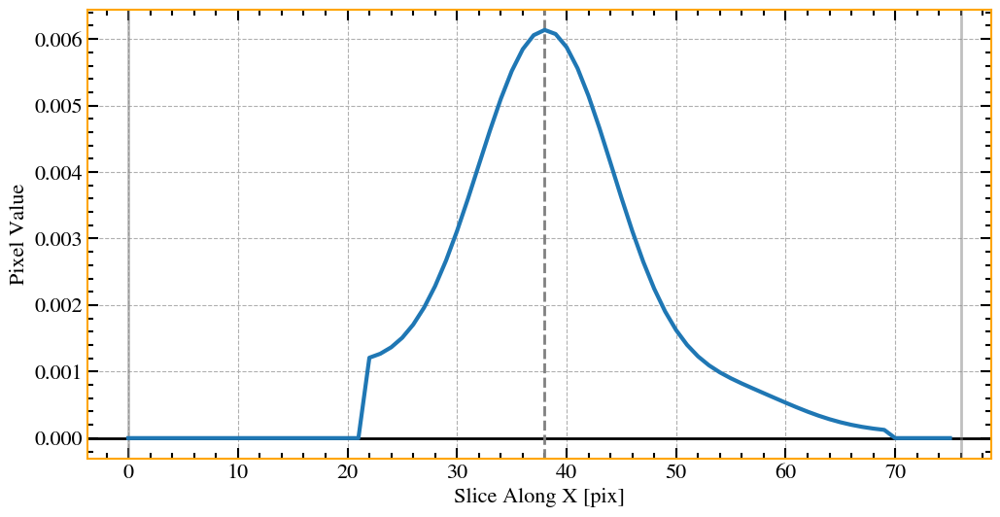

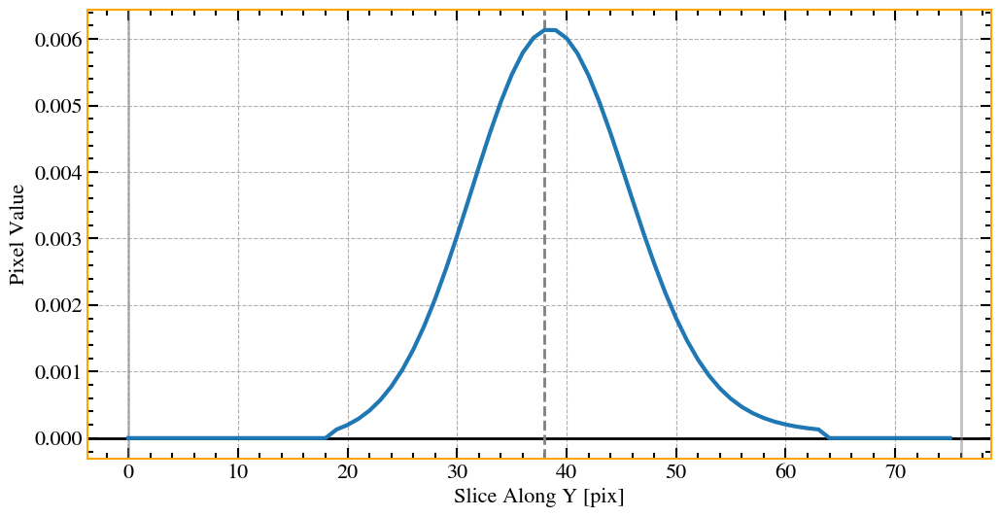

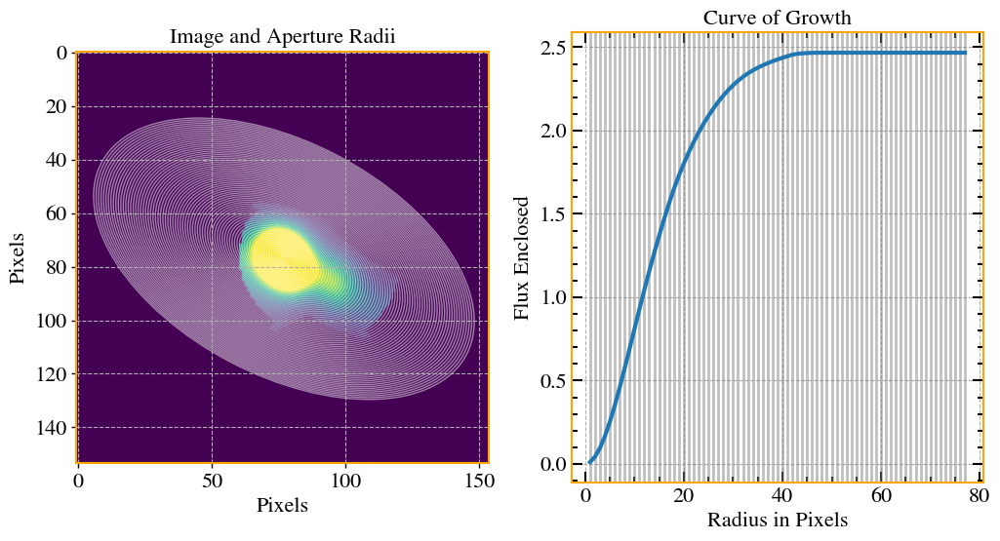

eta = 0.2
epsilon = 2
r_half_light (old vs new) = 13.83
r_total_flux (old vs new) = 49.00
R50 =  13.83136627325465
Rp= 29.989797959591918


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


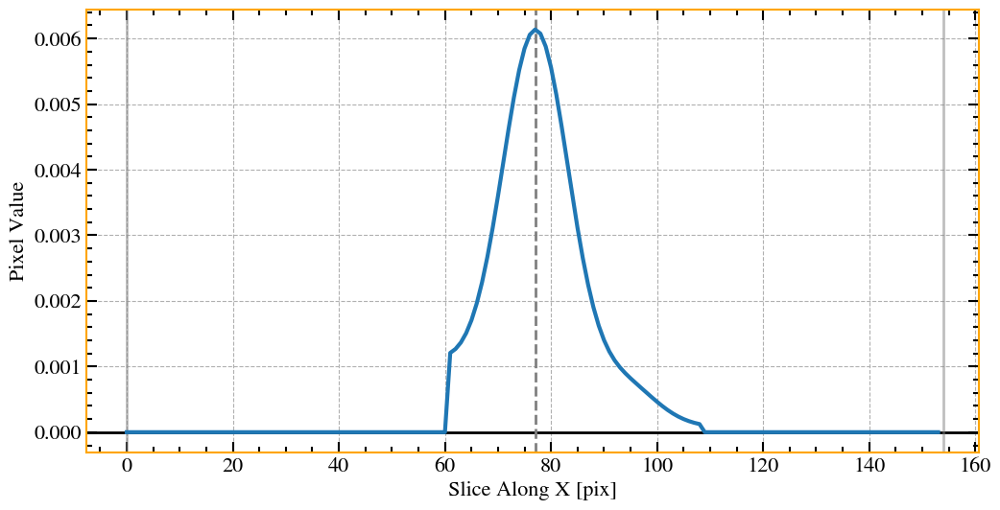

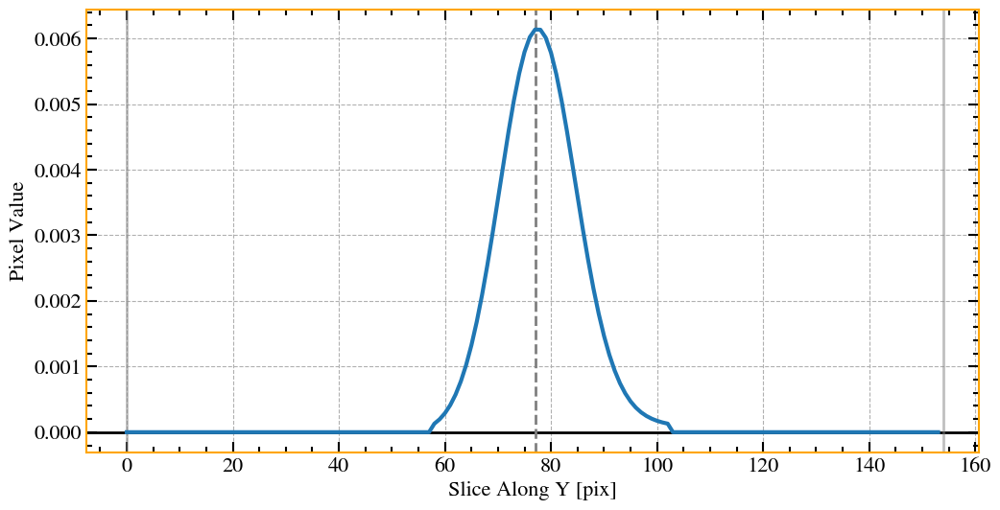

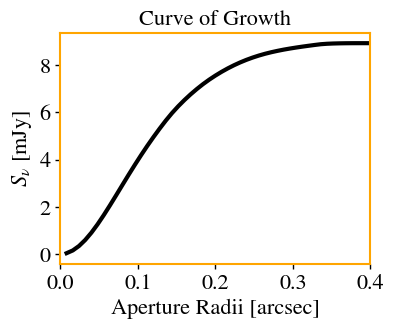

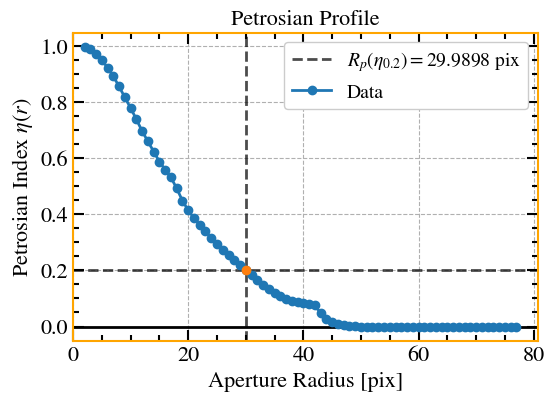

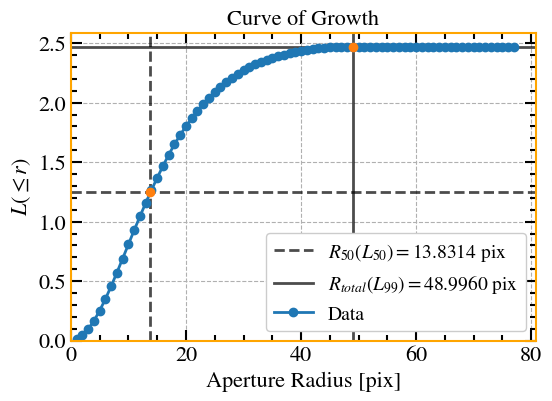

/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


--==>> Computing image statistics...


100%|██████████| 10/10 [00:00<00:00, 44.82it/s]


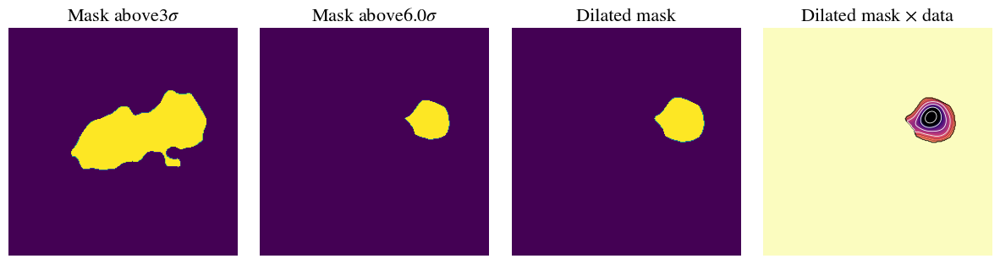

     >> CALC: Performing level statistics.
     >> CALC: Computing image properties.
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 4.64 +/- 0.03 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 4.64 +/- 0.23 mJy
Fractional error = 0.05
-----------------------------------------------------------------
32 128 96


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:4707: RuntimeWarning: invalid value encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:168: RuntimeWarning: Mean of empty slice.
  remove_indexes = np.where(np.logical_or(abs(y - y.mean()) >
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:169: RuntimeWarning: Mean of empty slice.
  abs(y - y.mean()).mean() * 1.5, \
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:170: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()) >
/media/sagauga/xfs_evo/cloud/On

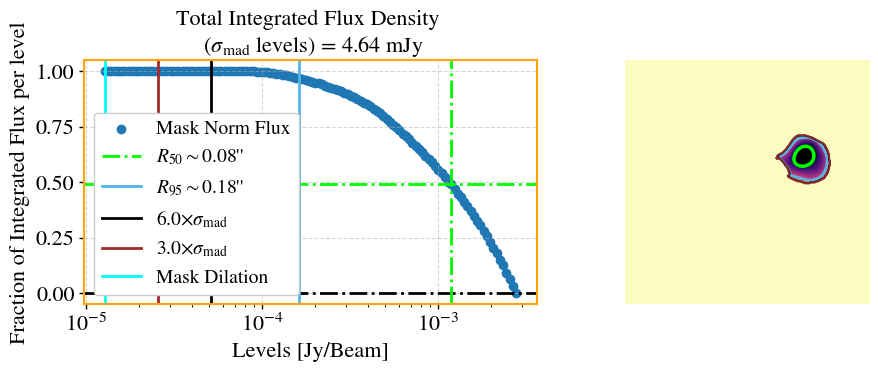

     >> CALC: Computing Petrosian properties.
1


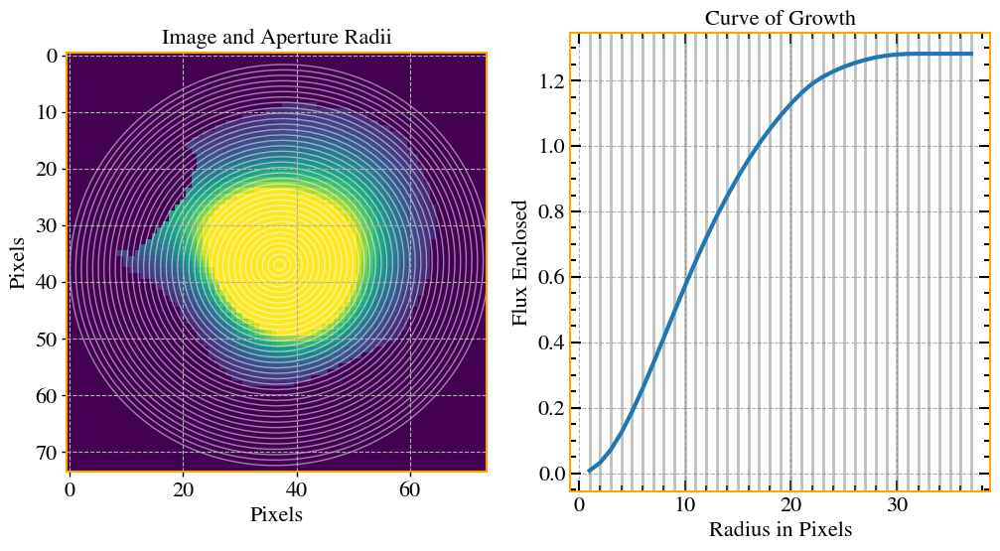

Rlast     >>  37
Rp        >>  23.070414082816566
Rtotal    >>  nan
1


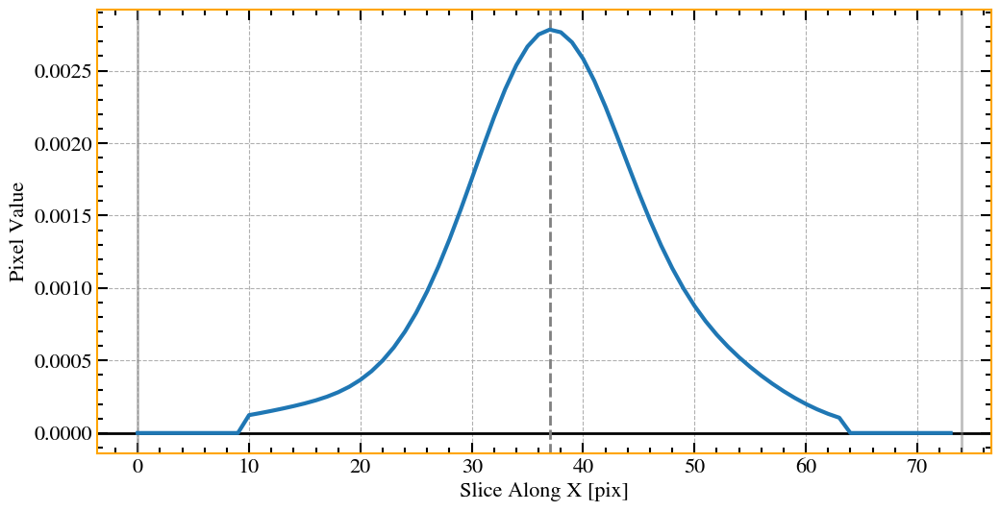

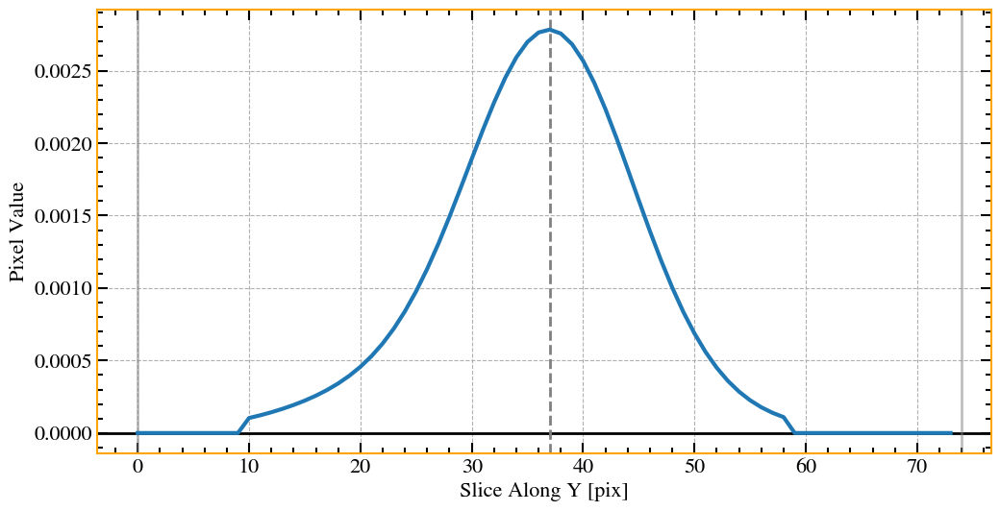

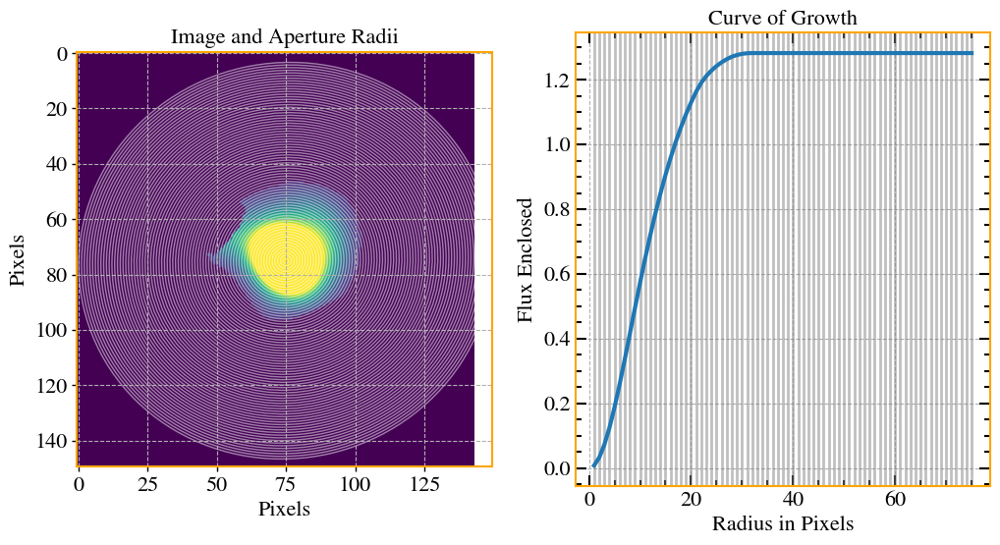

eta = 0.2
epsilon = 2
r_half_light (old vs new) = 11.01
r_total_flux (old vs new) = 32.19
R50 =  11.006801360272055
Rp= 23.074614922984598


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


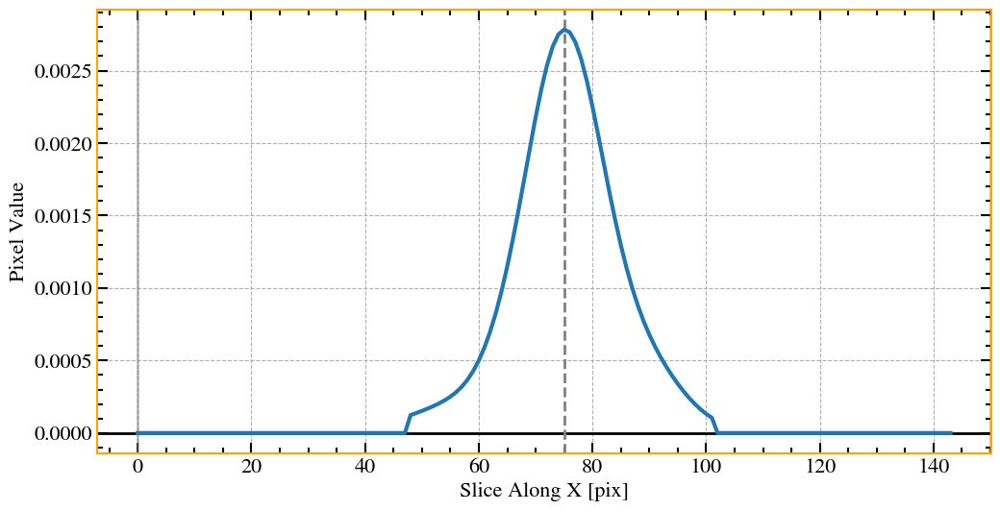

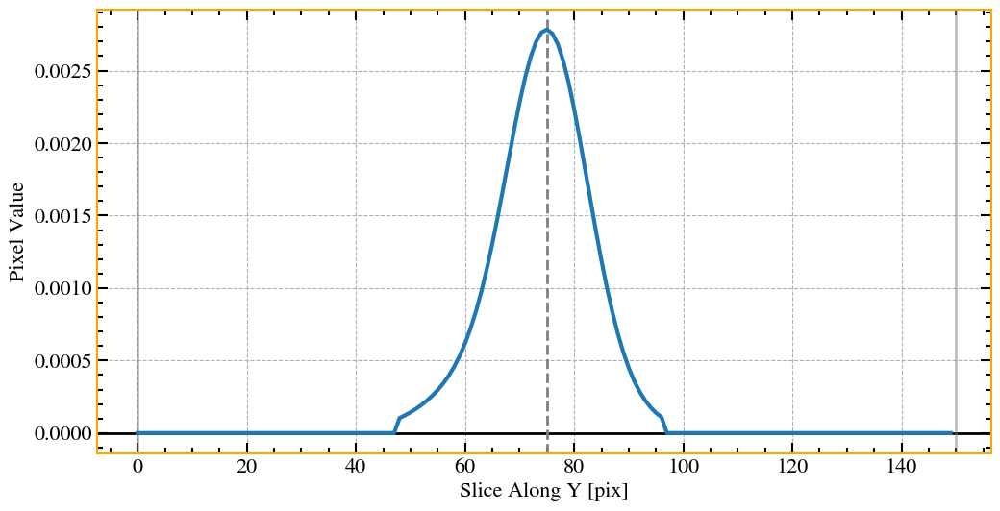

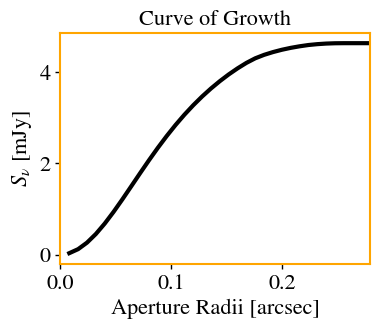

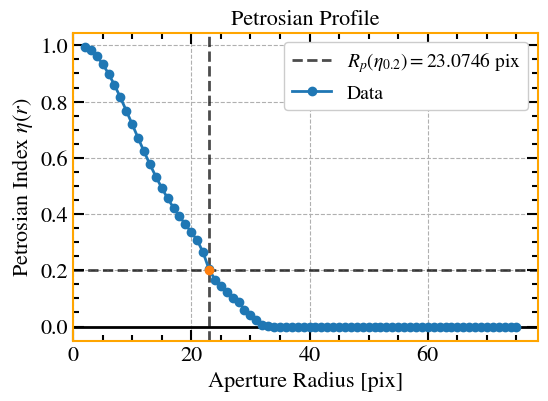

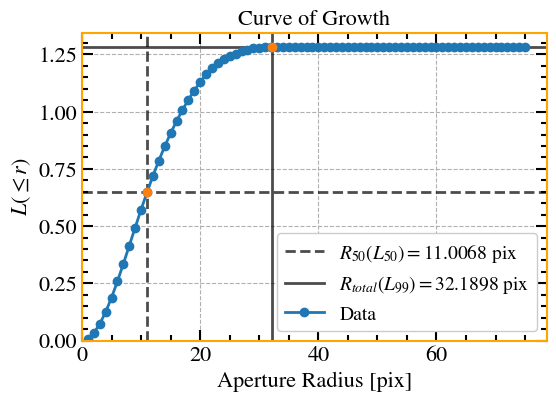

/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:2411: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


--==>> Computing image statistics...


100%|██████████| 10/10 [00:00<00:00, 48.47it/s]


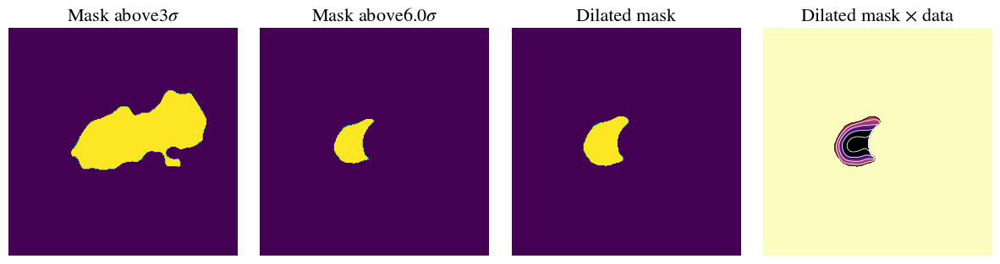

     >> CALC: Performing level statistics.
     >> CALC: Computing image properties.
-----------------------------------------------------------------
Flux Density and error (based on rms of residual x area): 
Flux Density = 3.27 +/- 0.03 mJy
Fractional error = 0.01
Flux Density and error (quadrature total): 
Flux Density = 3.27 +/- 0.17 mJy
Fractional error = 0.05
-----------------------------------------------------------------
32 128 96


/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/libs.py:4707: RuntimeWarning: invalid value encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:168: RuntimeWarning: Mean of empty slice.
  remove_indexes = np.where(np.logical_or(abs(y - y.mean()) >
/home/sagauga/miniconda3/envs/morphen_stable/lib/python3.8/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:169: RuntimeWarning: Mean of empty slice.
  abs(y - y.mean()).mean() * 1.5, \
/media/sagauga/xfs_evo/cloud/OnedriveUoM/PhD_UoM/GitHub/morphen_dev/image_analysis/../libs/fitEllipse.py:170: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()) >
/media/sagauga/xfs_evo/cloud/On

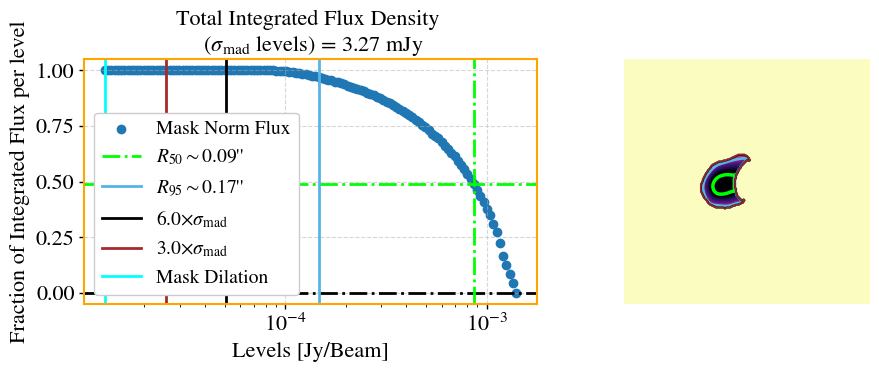

     >> CALC: Computing Petrosian properties.
1


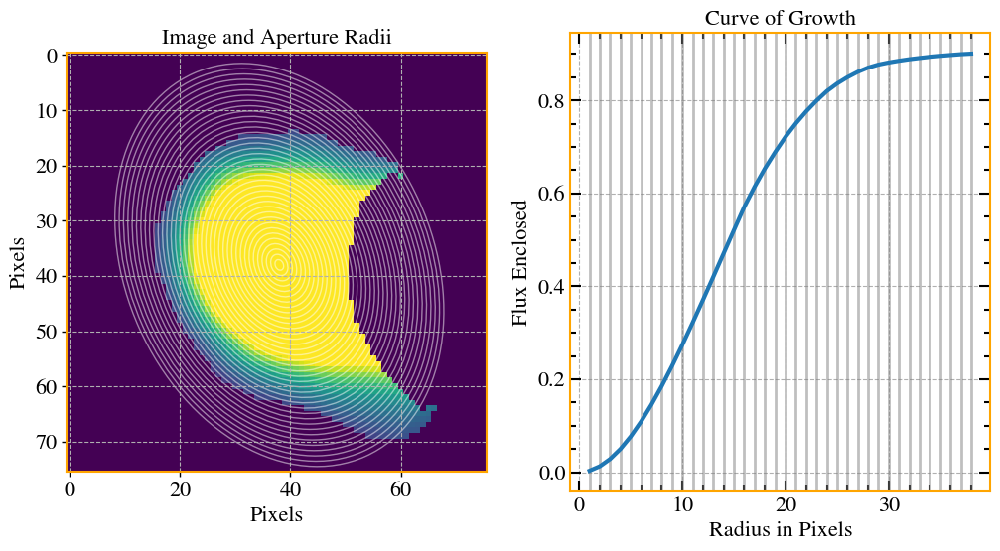

Rlast     >>  38
Rp        >>  26.445689137827564
Rtotal    >>  nan
1


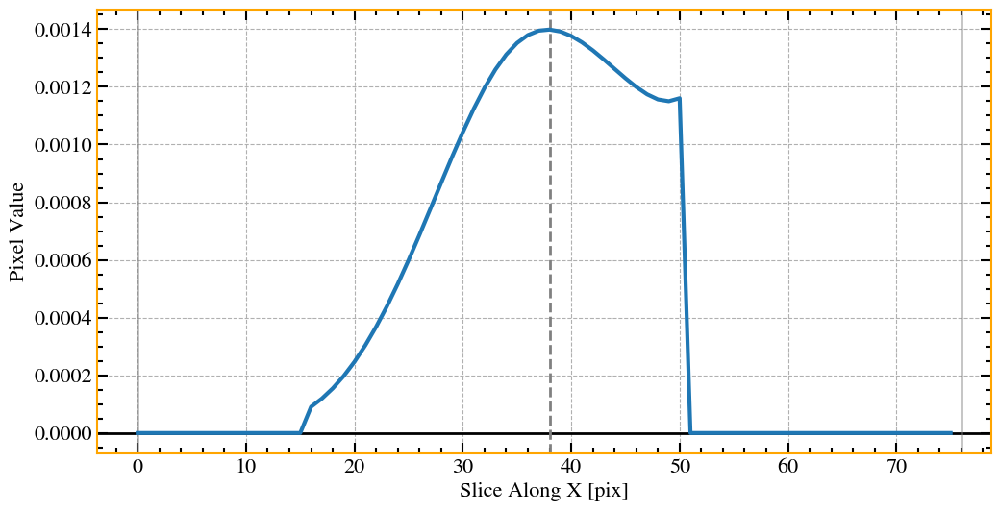

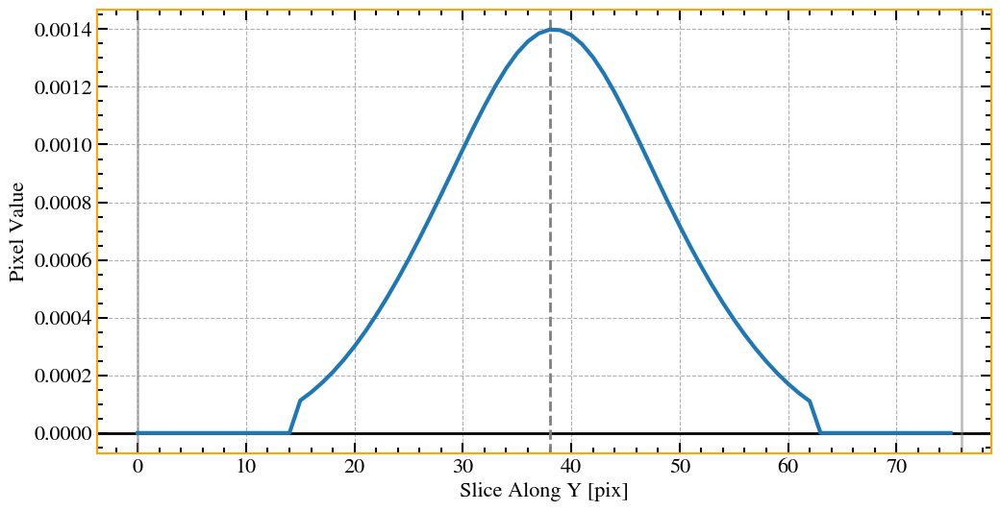

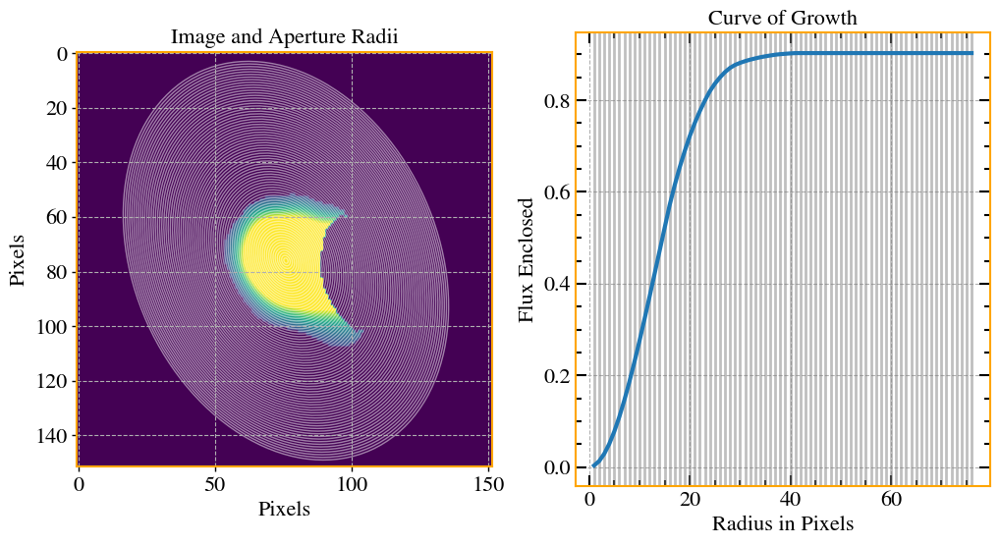

eta = 0.2
epsilon = 2
r_half_light (old vs new) = 13.71
r_total_flux (old vs new) = 41.30
R50 =  13.70754150830166
Rp= 26.453290658131625


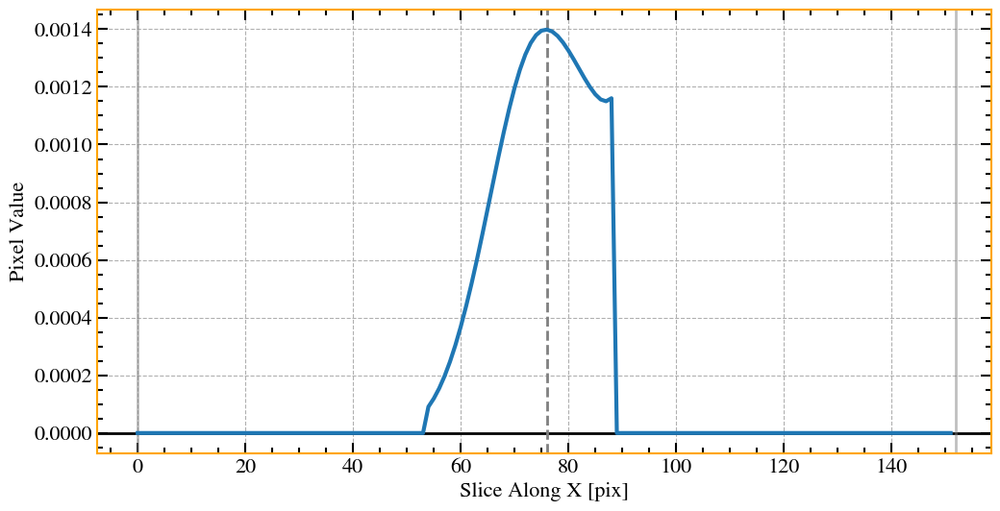

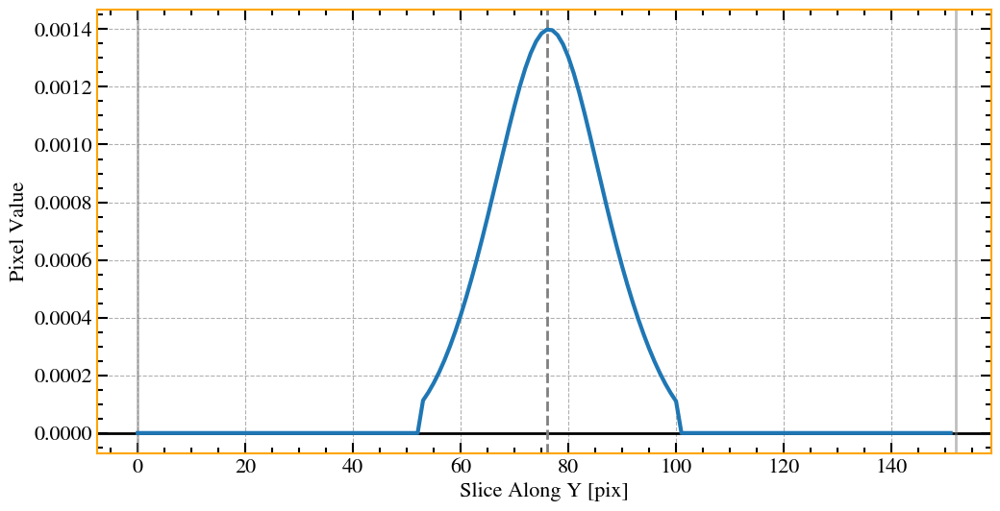

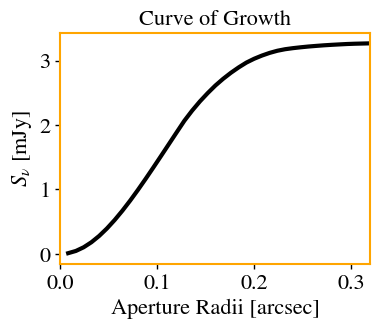

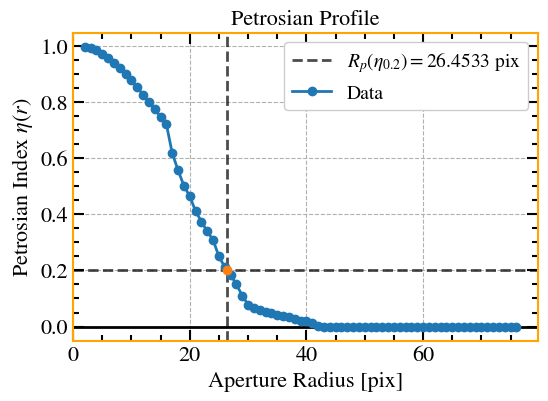

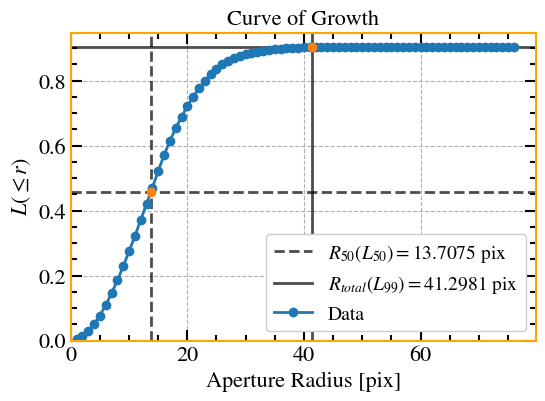

--==>> Computing image statistics...


100%|██████████| 1/1 [00:23<00:00, 23.14s/it]


In [207]:
results_conc, processing_results_source, missing_data_im = \
    mlibs.structural_morphology(imagelist = [imagelist_c[-1]], 
                                residuallist = [residuallist_c[-1]], 
                                indices=indices, 
                                masks_deblended=masks_deblended,
                                big_mask=mask,
                                zd = redshift_source)

In [208]:
df = mlibs.pd.DataFrame(results_conc)

In [209]:
df['flux_error_res_3']

0    0.000870
1    0.000447
2    0.000233
3    0.000165
Name: flux_error_res_3, dtype: float64

In [212]:
df[['total_flux_mask','flux_error_res','C50radii','C95radii']]

,total_flux_mask,flux_error_res,C50radii,C95radii
0,0.017347,0.000189,16.991382,41.658439
1,0.008935,0.000047,10.060941,22.126016
2,0.004643,0.000063,10.418429,22.539356
3,0.003270,0.000074,11.227231,21.468878


In [213]:
np.sum(df[['total_flux_mask']].iloc[1:])

total_flux_mask    0.016848
dtype: float64

In the previous dataframe, `comp_ID=0` contains the information for the full structure of the source. 
The other components are the substructures, identified by the extraction/deblending algorithm.
These components are sorted by their total flux density, and the first one is the brightest one.


In [214]:
processing_results_source

{'#imagename': 'final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutout.fits',
 'comp_ID': '0',
 'peak_of_flux': 0.006136488169431686,
 'total_flux': 0.017343038764997525,
 'inner_flux': 0.01350826610122213,
 'low_flux': 0.00019647668229518498,
 'mid_flux': 0.0034068007007586024,
 'uncertain_flux': 0.00023149528072160714,
 'inner_flux_f': 0.7788869231201339,
 'low_flux_f': 0.011328849860597831,
 'mid_flux_f': 0.19643620399640435,
 'uncertain_flux_f': 0.013348023022863847,
 'number_of_beams': 28.220620970537958,
 'n_beams_inner': 8.705552779824618,
 'n_beams_mid': 12.149388342891678,
 'n_beams_low': 2.9585842849903132,
 'n_beams_uncertain': 8.401365411478,
 'total_flux_nomask': 0.017635881901244082,
 'total_flux_mask': 0.01734693883909224,
 'max_residual': 1.402938778483076e-05,
 'min_residual': -1.4656566236226354e-05,
 'flux_residual': 6.290655706622358e-05,
 'flux_error_res': 0.00018871967119867073,
 'flux_error_res_2'

In [215]:
df_source = mlibs.pd.DataFrame.from_dict(processing_results_source, orient='index').T

In [216]:
df_source

,#imagename,comp_ID,peak_of_flux,total_flux,inner_flux,low_flux,mid_flux,uncertain_flux,inner_flux_f,low_flux_f,...,positionangle,arcsec_to_pc,bmaj_pc,bmin_pc,BA_pc,pix_to_pc,cell_size,area_beam_2Rp,area_beam_R50,ncomps
0,final_image_nc8_NGC7674.calibrated.avg6s.RR_LL...,0,0.006136,0.017343,0.013508,0.000196,0.003407,0.000231,0.778887,0.011329,...,152.177955,804.509756,112.56941,89.680063,11438.806532,6.436078,0.008,23.967208,5.459472,3


## 6. Upcoming Features
### 6.1 - Integration with PyBDSF


In [217]:
import bdsf

In [230]:
# df = pd.DataFrame({'ID': [1, 2, 1], 'x': [10, 10, 20], 'y': [10, 10, 20], 'z': [5, 6, 10]})

# define a function to aggregate rows with multiple measurements
def reduce_bdsf(df,cell_size):
    def average_rows(group):
        """
        For a PYBDSF table result (dataframe), read every duplicated 
        Source_ID and average it. 
        """
        if len(group) == 1:
            # if there's only one row in the group, return it
            return group
        else:
            # if there are multiple rows, calculate the mean of each column (except 'ID') and return a single row
            mean_values = group.drop('Source_id', axis=1).mean().to_dict()
            mean_values['Source_id'] = group['Source_id'].iloc[0]
            return mlibs.pd.DataFrame(mean_values, index=[0])
    # group by 'ID' and apply the 'average_rows' function to each group
    output_df = df.groupby('Source_id').apply(average_rows)

    # reset the index of the output dataframe
    output_df = output_df.reset_index(drop=True)
    
    # Pybdsf does not provide Maj and Min in px :(
    # So lets do it
    output_df['Maj_px'] = output_df['Maj'] * 3600/cell_size
    output_df['Min_px'] = output_df['Min'] * 3600/cell_size
    

    # display the output dataframe
    # print(output_df)
    return(output_df)

def plot_bdsf_ells(img,df,ell_size_factor=1,sort_by='flux'): 
    from matplotlib.patches import Ellipse
    from skimage.draw import ellipse
    fig, ax = mlibs.plt.subplots()
    m, s = mlibs.np.nanmean(img), mlibs.np.nanstd(img)
    im = ax.imshow(img, interpolation='nearest', cmap='gray',
                   vmin=m - s, vmax=m + s, origin='lower')

    masks_regions = []

    y, x = np.indices(img.shape[:2])
    for i in range(len(df)):
        e = Ellipse(xy=(df['Xposn'][i], df['Yposn'][i]),
                    width= ell_size_factor * df['Maj_px'][i],
                    height= ell_size_factor * df['Min_px'][i],
                    angle=df['PA'][i]+90# * (-180.) / np.pi
                   )
        print(e)
        xc = df['Xposn'][i]
        yc = df['Yposn'][i]
        a = ell_size_factor * df['Maj_px'][i]/2.35482
        b = ell_size_factor * df['Min_px'][i]/2.35482
        theta = mlibs.np.deg2rad(df['PA'][i] +90)
        # theta = df['PA'][i]#+90 / np.pi
        rx = (x - xc) * np.cos(theta) + (y - yc) * np.sin(theta)
        ry = (y - yc) * np.cos(theta) - (x - xc) * np.sin(theta)

        # print(((rx / a) ** 2 + (ry / b) ** 2))
        inside = ((rx / a) ** 2 + (ry / b) ** 2) <= 1
        mask_ell = mlibs.np.zeros_like(img)
        mask_ell[inside] = True
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
        masks_regions.append(mask_ell)
        
    mask_areas = []
    if sort_by == 'area':
        for mask_comp in masks_regions:
            area_mask = mlibs.np.nansum(mask_comp)
            mask_areas.append(area_mask)
    if sort_by == 'flux':
        for mask_comp in masks_regions:
            area_mask = mlibs.np.nansum(mask_comp*img)
            mask_areas.append(area_mask)        
    
    mask_areas = mlibs.np.asarray(mask_areas)
    sorted_indices_desc = mlibs.np.argsort(mask_areas)[::-1]
    sorted_arr_desc = mask_areas[sorted_indices_desc]
    return(masks_regions,sorted_indices_desc)

In [219]:
# minpix_isl = int(beam_area2(crop_image))
minpix_isl = int(mlibs.beam_area2(input_data.filename)/2)
print(minpix_isl)

138


In [220]:
# image = bdsf.process_image(input_data.filename,
#                            thresh_pix=10,thresh_isl=7,rms_map=True,
#                            #rms_box=(128,10),
#                            atrous_do=True,flag_bordersize=5,
#                            thresh='hard', #'fdr', None
#                            interactive=False,do_mc_errors=True,
# #                            ncores=32,
#                            group_by_isl=True,
#                            splitisl_maxsize = minpix_isl * 5,
# #                          psf_vary_do = True,#output_all=True
#                            plot_allgaus=True,#savefits_meanim =True,savefits_residim=True,#savefits_rmsim = True,
#                            verbose_fitting=False, 
#                            plot_islands=True,
#                            group_tol = 5,#1
#                            split_isl=False,
#                            minpix_isl=minpix_isl,
#                            shapelet_do=False,
#                            adaptive_rms_box=True)

image = bdsf.process_image(input_data.filename,
                           thresh_pix=10,
                           thresh_isl=10,
                           splitisl_maxsize = minpix_isl / 5,
                           group_tol = 5,#1
                           rms_map=True,
                           atrous_do=True,
                           plot_allgaus=True,
                           plot_islands=True,
                           flag_bordersize=5,
                           interactive=False,
                           ncores=64,
                           do_mc_errors=False,
                           group_by_isl=True,
                           minpix_isl=minpix_isl,
                           shapelet_do=False,
                           adaptive_rms_box=True,
                           split_isl=True)


--> Opened '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutout.fits'
Image size .............................. : (256, 256) pixels
Number of channels ...................... : 1
Number of Stokes parameters ............. : 1
Beam shape (major, minor, pos angle) .... : (3.88675e-05, 3.09644e-05, 152.2) degrees


Frequency of image ...................... : 14999.500 MHz
Number of blank pixels .................. : 0 (0.0%)
Flux from sum of (non-blank) pixels ..... : 0.018 Jy
--> Calculating background rms and mean images
--> Using adaptive scaling of rms_box
Derived rms_box (box size, step size) ... : (274, 26) pixels (small scale)
Derived rms_box (box size, step size) ... : (685, 26) pixels (large scale)
--> Size of rms_box larger than 1/4 of image size
--> Using constant background rms and mean
Value of background rms ................. : 7.29e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
--> Expected 5-sigma-clipped false detection rate < fdr_ratio
--> Using sigma-clipping ('hard') thresholding
Number of islands found ................. : 1


Fitting islands with Gaussians .......... : [|] 0/1

stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device


Fitting islands with Gaussians .......... : [] 1/1[-4G

stty: 'standard input': Inappropriate ioctl for device
Total number of Gaussians fit to image .. : 7
Total flux density in model ............. : 0.017 Jy



--> Wavelet scale #1
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 7.37e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #2
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 6.71e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #3
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 5.08e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #4
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 3.39e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #5
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 2.31e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #6
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 1.57e-06 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0



--> Wavelet scale #7
--> Calculating background rms and mean images
--> Using constant background rms
--> Using constant background mean
Value of background rms ................. : 5.78e-07 Jy/beam
Value of background mean ................ : 0.0 Jy/beam
Number of islands found ................. : 0


Checking islands for overlap ............ : [] 0/0
Checking islands for overlap ............ : [] 0/0


stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 0


Total flux density in model on all scales : 0.017 Jy
stty: 'standard input': Inappropriate ioctl for device
--> Grouping Gaussians into sources
Number of sources formed from Gaussians   : 1


NOTE -- With the mouse pointer in plot window:
  Press "i" ........ : Get integrated flux densities and mean rms
                       values for the visible portion of the image
  Press "m" ........ : Change min and max scaling values
  Press "n" ........ : Show / hide island IDs
  Press "0" ........ : Reset scaling to default
  Click Gaussian ... : Print Gaussian and source IDs (zoom_rect mode, 
                       toggled with the "zoom" button and indicated in 
                       the lower right corner, must be off)
________________________________________________________________________


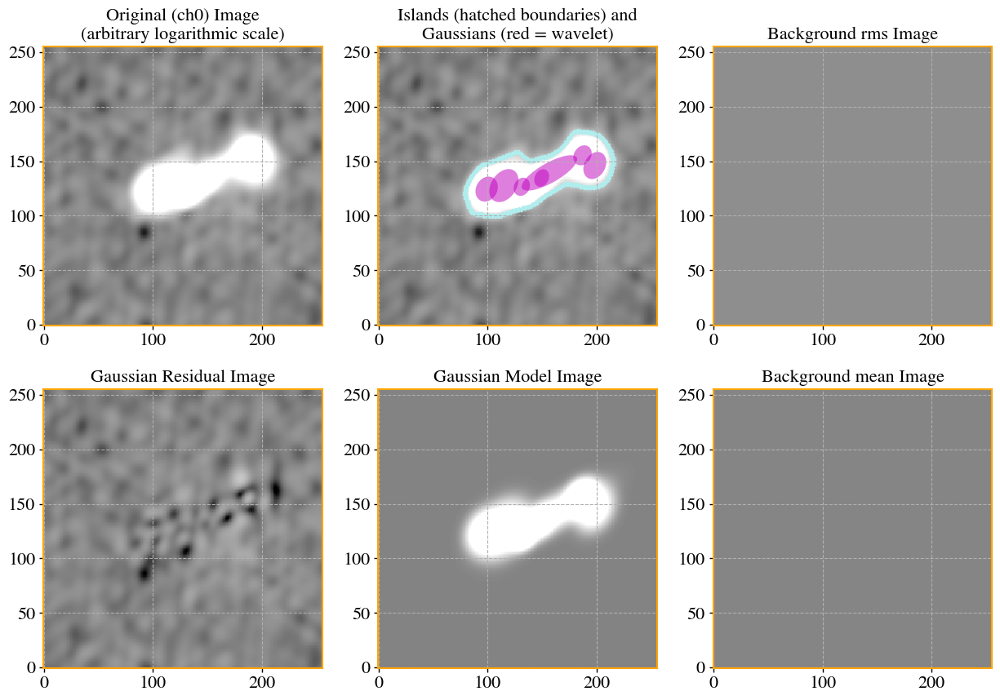

--> Wrote FITS file '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutouttest_cat.fits'
--> Saved parameters to file '../../data_examples/data_examples_general/vla_only/NGC7674_Ku/final_image_nc8_NGC7674.calibrated.avg6s.RR_LL_trial_1_1024x1024_0.008asec_100000.briggs.multiscale..0.5-MFS-image.cutout_bdsf_results'.


In [240]:
image.show_fit()
bdsf_cat_file = input_data.filename.replace('.fits','test_cat.fits')
image.write_catalog(format='fits', outfile=bdsf_cat_file, catalog_type='gaul',bbs_patches='single',clobber=True)
# image.write_catalog(format='fits', outfile=bdsf_cat_file, catalog_type='srl',bbs_patches='single',clobber=True)
image.save_pars(input_data.filename.replace('.fits','_bdsf_results'))

from astropy.table import Table
table_data = Table.read(bdsf_cat_file)


df = table_data.to_pandas()

# radi_ell = np.sqrt(df['Maj'] *df['Min'])
# pixel_scale = 0.008
# radius_arcsec = radi_ell * 3600
# radius_pixels = radius_arcsec / pixel_scale
# area_pixels = math.pi * radius_pixels ** 2
# print(area_pixels/area_pixels.sum())
output_df = reduce_bdsf(df,mlibs.get_cell_size(input_data.filename))

In [241]:
output_df

,Gaus_id,Isl_id,Wave_id,RA,E_RA,DEC,E_DEC,Total_flux,E_Total_flux,Peak_flux,...,E_DC_PA_img_plane,Isl_Total_flux,E_Isl_Total_flux,Isl_rms,Isl_mean,Resid_Isl_rms,Resid_Isl_mean,Source_id,Maj_px,Min_px
0,3.0,0.0,0.0,-8.013748,2.296244e-07,8.778948,2.140975e-07,0.002471,0.000021,0.001712,...,1.186645,0.017379,0.000032,0.000007,8.922468e-07,0.000016,0.000002,0,27.819997,17.51418


In [242]:
sorted_indices_desc

array([0])

Ellipse(xy=(148.03102289578564, 136.1897873758879), width=73.96449212851763, height=46.564614273855895, angle=235.67142484202222)


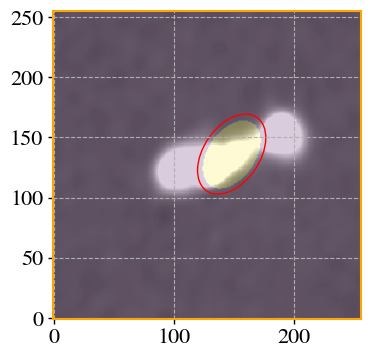

In [243]:
masks_regions,sorted_indices_desc = \
    plot_bdsf_ells(input_data.image_data_2D, 
                   output_df, 
                   ell_size_factor=1.5*np.sqrt(np.pi))
mlibs.plt.imshow(masks_regions[sorted_indices_desc[0]],origin='lower',alpha=0.2)

### 6.2 - Integration with Astrodendro

In [244]:
# sys.path.append('../../astrodendro/astrodendro/')

In [245]:
from astrodendro import Dendrogram
from astrodendro.analysis import PPStatistic
def compute_dendogram(image,imagename,min_factor=5,min_delta_factor=0.1):
    from astropy.io import fits

    from astrodendro import Dendrogram
    from astrodendro.analysis import PPStatistic

    import matplotlib.pyplot as plt
    from matplotlib.patches import Ellipse

    if isinstance(image, str) == True:
        imagedata = ctn(image)
#         hdu = fits.open(imagelist[idx])[0]
    else:
        imagedata = image

    min_value = min_factor*mad_std(imagedata)
    min_npix = beam_area2(imagename)
    d = Dendrogram.compute(imagedata, min_value=min_value, 
                           min_delta=min_value*min_delta_factor, min_npix=min_npix,verbose=False)
    p = d.plotter()

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

    ax.imshow(imagedata, origin='lower', interpolation='nearest',
              cmap=plt.cm.Blues, vmax=0.0001)
    # ax=eimshow(hdu.data)
    stats = []
    ellipses = []
    for leaf in d.leaves:

        p.plot_contour(ax, structure=leaf, lw=3, colors='red')

        s = PPStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='orange', facecolor='none')
        stats.append(s)
        ellipses.append(ellipse)
        ax.add_patch(ellipse)

    # ax.set_xlim(75., 170.)
    # ax.set_ylim(120., 260.)
    # v = d.viewer()
    # v.show()
    return(d.trunk,d.leaves,stats,ellipses)


def calculate_dendograms(imagename,sigma_level=5,min_delta_factor=0.1,mask=None):
    from astropy.io import fits

    from astrodendro import Dendrogram
    from astrodendro.analysis import PPStatistic

    import matplotlib.pyplot as plt
    from matplotlib.patches import Ellipse

    hdu = pf.open(imagename)[0]
    min_npix = int(beam_area2(imagename))
    rms = sigma_level*mad_std(hdu.data)
    if mask is not None:
        min_value = 1e-5
        data_2D = hdu.data * mask
    else:
        data_2D = hdu.data
        min_value = rms
        

    d = Dendrogram.compute(data_2D, min_value=min_value, 
                           min_delta=min_value*min_delta_factor, 
                           min_npix=min_npix,verbose=False)
    p = d.plotter()

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

#     ax.imshow(hdu.data, origin='lower', interpolation='nearest',
#               cmap=plt.cm.Blues,vmax=hdu.data.max()*0.01) #  vmin = 0.1*min_value ,
    ax.imshow(hdu.data, origin='lower', interpolation='nearest',
              cmap=plt.cm.Blues,vmax=hdu.data.max()*0.01) #  vmin = 0.1*min_value ,

    # ax=eimshow(hdu.data)
    for leaf in d.leaves:

        p.plot_contour(ax, structure=leaf, lw=3, colors='red')

        s = PPStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='orange', facecolor='none')

        ax.add_patch(ellipse)

    # ax.set_xlim(75., 170.)
    # ax.set_ylim(120., 260.)
    # v = d.viewer()
    # v.show()
    return(d)

AttributeError: module 'numpy' has no attribute 'int'.
`np.int` was a deprecated alias for the builtin `int`. To avoid this error in existing code, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

In [ ]:
d_t,d_l,d_s,d_e = compute_dendogram(input_data.image_data_2D,
                                    input_data.filename,
                                    min_factor=3,min_delta_factor=0.01)

In [ ]:
dendos = calculate_dendograms(input_data.filename,mask=None,sigma_level=1,min_delta_factor=0.001)

Not able to determine cell size. Please, provide a cell size with the parameter `cell_size`.
 ==>  Dilation size is 7 [px]
INFO: Total number of Sources/Structures (deblended) =  7


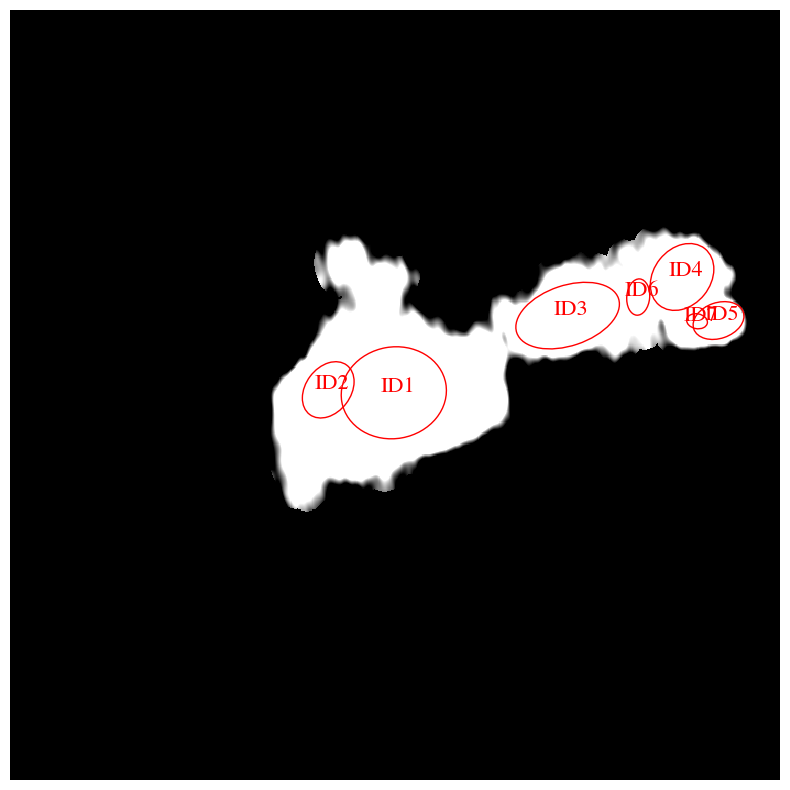

In [283]:
bwf, bhf = 2, 2
fwf, fhf = 10, 10
clean_param = 0.3
deblend_cont = 1e-5
deblend_nthresh = 15
sigma = 6
masks, indices, bkg_image, seg_maps, objects = \
    mlibs.sep_source_ext(input_data.filename, bw=13,
                   bh=13,
                   fw=41, fh=41,
                   minarea=int(mlibs.beam_area2(input_data_detection.filename)),
                   segmentation_map=True,
                   filter_type='matched', mask=None,
                   deblend_nthresh=deblend_nthresh,
                   deblend_cont=deblend_cont,
                   clean_param=clean_param,
                   clean=True,
                   sort_by='flux',
                   sigma=sigma,
                   ell_size_factor=1.7,
                   apply_mask=True,
                   show_detection=True)

In [300]:
masks_deblended = []
for k in range(len(indices)):
    # print(seg_maps[indices[k]])
    masks_deblended.append(seg_maps[indices[k]]*(seg_maps == seg_maps[indices[k]]))

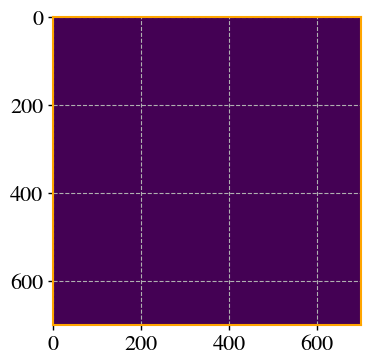

In [302]:
mlibs.plt.imshow(masks_deblended[0])

In [289]:
np.unique(seg_maps)

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int32)

## Handling multiple image files

In [ ]:
root_path_vla = '../data_examples/vla_only/VV705_C/' #only with JVLA images.
root_path_eM = '../data_examples/emerlin_only/VV705_C/' #only with e-MERLIN images.
root_path_comb = '../data_examples/combined/VV705_C/' #only with e-MERLIN images.
prefix_images = 'MFS_images/north/*MFS-image.cutout_north.fits'

In [ ]:
imagelist_vla = mlibs.glob.glob(root_path_vla+prefix_images)
imagelist_comb = mlibs.glob.glob(root_path_comb+prefix_images)
imagelist_eM = mlibs.glob.glob(root_path_eM+prefix_images)

In [ ]:
#this function is helpfull to sort the image list according to the restoring 
# beam size (from smaller beams to larger beams). 
imagelist_vla,residuallist_vla = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist_vla,return_df = False)
imagelist_eM,residuallist_eM = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist_eM,return_df = False)
imagelist_comb,residuallist_comb = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist_comb,return_df = False)

In [ ]:
residuallist_vla

In [ ]:
# imagelist_eM,residuallist_eM = \
#     mlibs.sort_list_by_beam_size(imagelist=imagelist_eM,return_df = False)


5.970821321441846
17.607777518557306


In [48]:
# mlibs.eimshow(analysis.mask)
# mlibs.eimshow(analysis.omask)

# Source Extraction

The preparations for the Sersic fitting starts a step before, by performing a simple source extraction from the image and computing basic prior information. 

We use this to construct a more physically constrained Sersic model. 

The class `source_extraction` allow us to find relevant regions of emission. 

WARNING: This is implementation is in a very early stage, so it is not completelly automated. It is required that the user interacts with it in order to check if the source detection is feasible. Only after that it should proceed to the Serscic fitting. 

To check if the source detection is good, you may pass the argument `dry_run` which will only display the regions detected, without performing any calculation. 

Parameters that are critical for the source detection are the `SEP` arguments for the source extraction `bw`, `bh`, `fw` and `fh`. 



In [13]:
idx = 2
input_data=mp.read_data(filename=imagelist_comb[idx],
                        residualname=residuallist_comb[idx])

Image File: clean_image_VV250_EVLA_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale..-0.8-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_EVLA_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale..-0.8-MFS-residual.cutout_south.fits


In [14]:
image_data = input_data.image_data_2D
residual_data = input_data.residual_data_2D

  >> Center -->  [877 893   0   0]


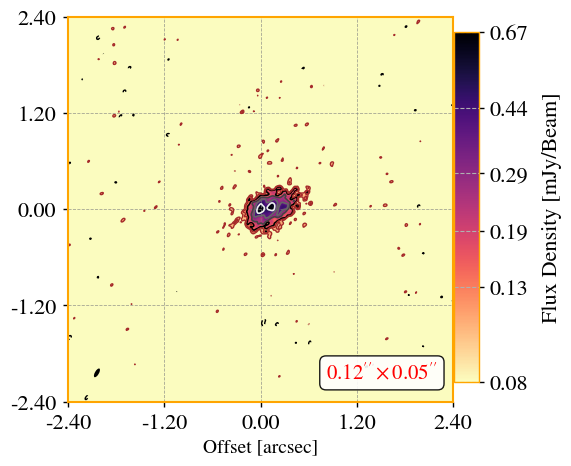

In [15]:
ax=mlibs.eimshow(input_data.filename,add_beam=True,crop=True,box_size=300,
        vmin_factor=3.0,vmax_factor=0.99, #level factor (max from peak, and min from std)
        neg_levels=np.asarray([-3]), # negative contours to draw -- which negative std level?
        CM='magma_r',
       )

In [16]:
imagelist_vla

array(['/home/sagauga/pCloudDrive/PhD/data_analysis/LIRGI_sample/analysis_results/processing_images/VLA_only/VV250a_C/wsclean_images_v3/MFS_images/cutouts/clean_image_VV250_EVLA.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale..-2.0-MFS-image.cutout_south.fits',
       '/home/sagauga/pCloudDrive/PhD/data_analysis/LIRGI_sample/analysis_results/processing_images/VLA_only/VV250a_C/wsclean_images_v3/MFS_images/cutouts/clean_image_VV250_EVLA.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale..-1.0-MFS-image.cutout_south.fits',
       '/home/sagauga/pCloudDrive/PhD/data_analysis/LIRGI_sample/analysis_results/processing_images/VLA_only/VV250a_C/wsclean_images_v3/MFS_images/cutouts/clean_image_VV250_EVLA.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale..-0.5-MFS-image.cutout_south.fits',
       '/home/sagauga/pCloudDrive/PhD/data_analysis/LIRGI_sample/analysis_results/processing_images/VLA_only/VV250a_C/

No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


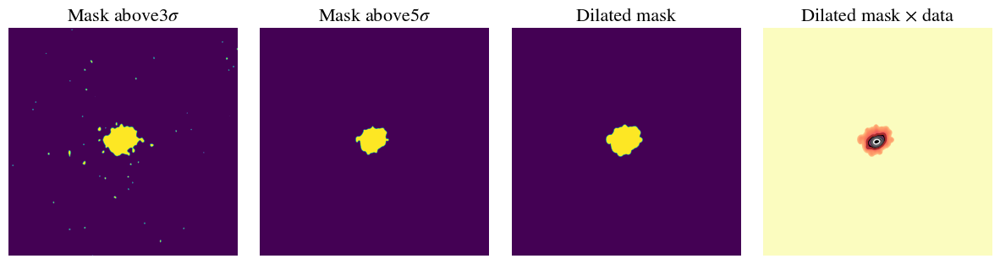

No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


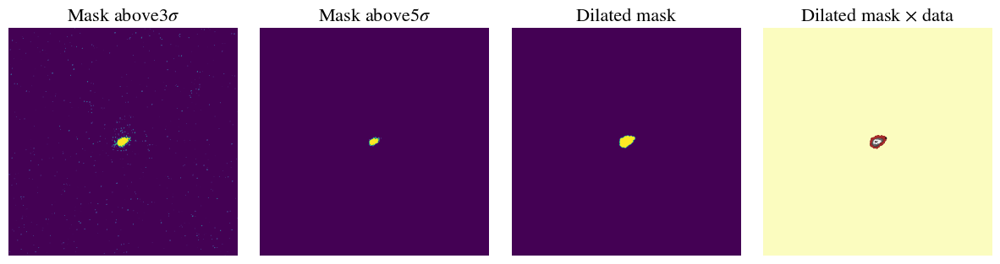

In [17]:
std = mad_std(ctn(imagelist_vla[2]))
_, mask = mask_dilation(ctn(imagelist_vla[2]), PLOT=True,dilation_type='disk',
                        sigma=5, iterations=2, dilation_size=None)
_, mask_self = mask_dilation(ctn(input_data.filename), PLOT=True,dilation_type='disk',
                        sigma=5, iterations=2, dilation_size=None)


Deblending:   0%|          | 0/1 [00:00<?, ?it/s]

0
1


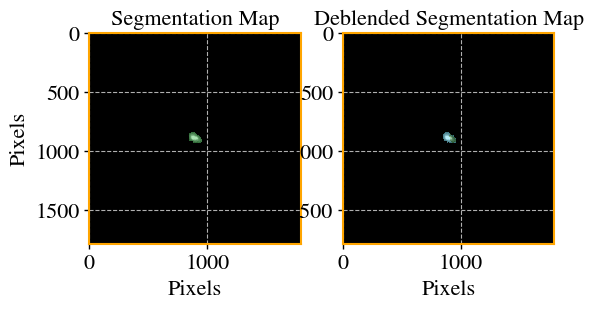

In [80]:
cat, segm, segm_deblend = make_catalog(image=(ctn(input_data.filename))*mask*mask_self,
                                       threshold=1.0 * std,
                                       deblend=True,contrast=0.0000000000001,nlevels=10,
                                       # kernel_size=7,
                                       # fwhm=3,
                                       npixels=1*int(beam_area2(input_data.filename)),
                                       plot=True, 
                                       vmax=0.1*ctn(imagelist_vla[1]).max(),
                                       vmin=1.0 * std)
indices = order_cat(cat, key='segment_flux', reverse=True)
masks_deblended = []
for k in range(len(indices)):
    print(k)
    masks_deblended.append(segm_deblend == segm_deblend.labels[indices[k]])
#         idx = sorted_idx_list[0]  # index 0 is largest

In [45]:
# def phot_source_ext(imagename, sigma=10.0, iterations=2, dilation_size=None,
#                    deblend_nthresh=100, deblend_cont=0.005, maskthresh=0.0,
#                    gain=1, filter_kernel=None, mask=None,
#                    segmentation_map=False, clean_param=1.0, clean=True,
#                    minarea=20, filter_type='matched', sort_by='flux',
#                    bw=64, bh=64, fw=3, fh=3, ell_size_factor=2,
#                    apply_mask=False,sigma_mask=6,
#                    show_bkg_map=False, show_detection=False):
#     """
#     Simple source extraction algorithm (using SEP https://sep.readthedocs.io/en/v1.1.x/).


#     """
#     import sep
#     import fitsio
#     import matplotlib.pyplot as plt
#     from matplotlib.text import Text
#     from matplotlib import rcParams

#     data_2D = ctn(imagename)
#     if len(data_2D.shape) == 4:
#         data_2D = data_2D[0][0]
#     m, s = np.mean(data_2D), mad_std(data_2D)
#     bkg = 0.0

#     bkg = 0.0#sep.Background(data_2D, mask=mask, bw=bw, bh=bh, fw=fw, fh=fh)
#     # print(bkg.globalback)
#     # print(bkg.globalrms)
#     bkg_image = 0.0#bkg.back()
#     bkg_rms = 0.0#bkg.rms()

#     data_sub = data_2D - bkg

    
#     if apply_mask:
#         if mask is not None:
#             data_sub = data_sub * mask
#         else:
#             _, mask = mask_dilation(data_2D, sigma=sigma_mask, iterations=iterations,
#                                     dilation_size=dilation_size)
#             data_sub = data_sub * mask

#     # else:
#     #     mask = None
#     if segmentation_map == True:
#         print(data_sub)
#         cat, segm, seg_maps = make_catalog(image=data_sub,
#                                                threshold=0.5 * s,
#                                                deblend=True,contrast=0.0000000000001,nlevels=10,
#                                                npixels=1*int(beam_area2(imagename)),
#                                                plot=True, vmin=1.0 * s)
#         indices = order_cat(cat, key='segment_flux', reverse=True)
#         masks_deblended = []
#         for k in range(len(indices)):
#             print(k)
#             masks_deblended.append(seg_maps == seg_maps.labels[indices[k]])
            
#     else:
#         cat, segm, seg_maps = make_catalog(image=data_sub,
#                                                threshold=1.0 * s,
#                                                deblend=True,contrast=0.0000000000001,nlevels=10,
#                                                npixels=1*int(beam_area2(imagename)),
#                                                plot=True, vmin=1.0 * s)
#         indices = order_cat(cat, key='segment_flux', reverse=True)
#         masks_deblended = []
#         for k in range(len(indices)):
#             print(k)
#             masks_deblended.append(seg_maps == seg_maps.labels[indices[k]])

#     # len(objects)
#     from matplotlib.patches import Ellipse
#     from skimage.draw import ellipse

#     m, s = np.mean(data_sub), np.std(data_sub)
#     if show_detection == True:
#         fig, ax = plt.subplots()
#         im = ax.imshow(data_sub, interpolation='nearest', cmap='gray',
#                        vmin=m - s, vmax=m + s, origin='lower')

#     masks_regions = []

#     y, x = np.indices(data_2D.shape[:2])
#     objects = cat
#     for i in range(len(cat)):
#         source = cat[i]
#         seg_mask = (seg_maps.data == i+1)
#         e = Ellipse(xy=(source.centroid[0], source.centroid[1]),
#                     width=2 * ell_size_factor *source.equivalent_radius.value,
#                     height=2 * ell_size_factor * (1-source.ellipticity.value)*source.equivalent_radius.value,
#                     angle=source.orientation.value * 180. / np.pi)

#         xc = source.centroid[0]
#         yc = source.centroid[1]
#         a = ell_size_factor * source.equivalent_radius.value
#         b = ell_size_factor * (1-source.ellipticity.value)*source.equivalent_radius.value
#         theta = source.orientation.value
#         rx = (x - xc) * np.cos(theta) + (y - yc) * np.sin(theta)
#         ry = (y - yc) * np.cos(theta) - (x - xc) * np.sin(theta)

#         inside = ((rx / a) ** 2 + (ry / b) ** 2) <= 1
#         mask_ell = np.zeros_like(data_2D)
#         mask_ell[inside] = True
#         if show_detection == True:
#             e.set_facecolor('none')
#             e.set_edgecolor('red')
#             ax.add_artist(e)
#         masks_regions.append(seg_mask)

#     #         plt.savefig('components_SEP.pdf',dpi=300, bbox_inches='tight')
#     # flux, fluxerr, flag = sep.sum_circle(data_sub, objects['x'], objects['y'],
#     #                                      3.0, err=bkg.globalrms, gain=1.0)
#     # for i in range(len(objects)):
#     #     print("object {:d}: flux = {:f} +/- {:f}".format(i, flux[i], fluxerr[i]))
#     # objects['b'] / objects['a'], np.rad2deg(objects['theta'])

#     # sort regions from largest size to smallest size.
#     mask_areas = []
#     mask_fluxes = []
#     for mask_comp in masks_regions:
#         area_mask = np.sum(mask_comp)
#         sum_mask = np.sum(mask_comp * data_2D)
#         mask_areas.append(area_mask)
#         mask_fluxes.append(sum_mask)
#     mask_areas = np.asarray(mask_areas)
#     mask_fluxes = np.asarray(mask_fluxes)
#     if sort_by == 'area':
#         sorted_indices_desc = np.argsort(mask_areas)[::-1]
#         sorted_arr_desc = mask_areas[sorted_indices_desc]
#     if sort_by == 'flux':
#         sorted_indices_desc = np.argsort(mask_fluxes)[::-1]
#         sorted_arr_desc = mask_fluxes[sorted_indices_desc]

#     objects_sorted = {}
#     objects_sorted['xc'] = np.asarray([1] * len(cat))
#     objects_sorted['yc'] = np.asarray([1] * len(cat))
#     for i in range(len(cat)):
#         source = cat[sorted_indices_desc[i]]
#         objects_sorted['xc'][i] = source.centroid[0]
#         objects_sorted['yc'][i] = source.centroid[1]

#     if show_detection == True:
#         for i in range(len(cat)):
#             source = cat[sorted_indices_desc[i]]
#             xc = source.centroid[0]
#             yc = source.centroid[1]
#             label = str('ID' + str(i + 1))
#             text = Text(xc + 10 * ell_size_factor, yc + 3 * ell_size_factor, label, ha='center', va='center', color='red')
#             ax.add_artist(text)

#         plt.axis('off')
#         # plt.show()
#         plt.savefig(imagename + '_SEP_phot.jpg', dpi=300, bbox_inches='tight')
#         plt.show()

#     if segmentation_map == True:
#         return (masks_regions, sorted_indices_desc, seg_maps, objects_sorted)
#     else:
#         return (masks_regions, sorted_indices_desc, objects_sorted)

In [81]:
masks, indices, seg_maps, objects = \
    phot_source_ext(input_data.filename, bw=51,
                   bh=51,
                   fw=51, fh=51,
                   minarea=100,
                   segmentation_map=True,
                   filter_type='matched', mask=None,
                   deblend_nthresh=deblend_nthresh,
                   deblend_cont=deblend_cont,
                   clean_param=clean_param,
                   clean=True,
                   sort_by='flux',
                   sigma=sigma,
                   ell_size_factor=1,
                   apply_mask=True,
                   show_detection=True)

NameError: name 'deblend_nthresh' is not defined

In [50]:
%matplotlib inline

Error loading fits file
Error loading fits file
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


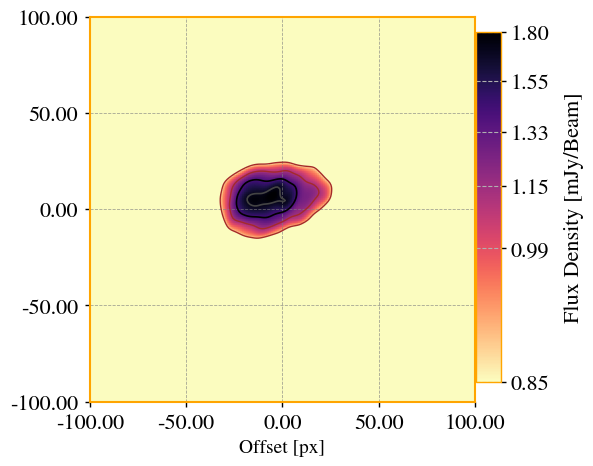

In [52]:
ax=mlibs.eimshow(ctn(input_data.filename) * (masks[0]) * segm_deblend.data,add_beam=True,crop=True,box_size=100,
        vmin_factor=3.0,vmax_factor=0.99, #level factor (max from peak, and min from std)
        neg_levels=np.asarray([-3]), # negative contours to draw -- which negative std level?
        CM='magma_r',
       )

In [53]:
seg_maps.data.shape

(1792, 1792)

In [54]:
bwf, bhf = 2, 2
fwf, fhf = 10, 10
clean_param = 0.5
deblend_cont = 1e-7
deblend_nthresh = 3
sigma = 3

object 0: flux = 0.049562 +/- 0.222624


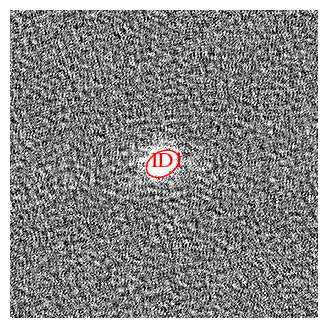

In [55]:
masks, indices, seg_maps, objects = \
    sep_source_ext(input_data.filename, bw=51,
                   bh=51,
                   fw=51, fh=51,
                   minarea=100,
                   segmentation_map=True,
                   filter_type='matched', mask=None,
                   deblend_nthresh=deblend_nthresh,
                   deblend_cont=deblend_cont,
                   clean_param=clean_param,
                   clean=True,
                   sort_by='flux',
                   sigma=sigma,
                   ell_size_factor=3,
                   apply_mask=False,
                   show_detection=True)

In [56]:
objects

{'xc': array([887]), 'yc': array([896])}

In [57]:
source_0 = cat[0]

In [58]:
source_0['segment_flux']

TypeError: A scalar 'SourceCatalog' object cannot be indexed

In [59]:
cat.ma

AttributeError: 'SourceCatalog' object has no attribute 'ma'

No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


ValueError: Geometric sequence cannot include zero

/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: divide by zero encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: invalid value encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)


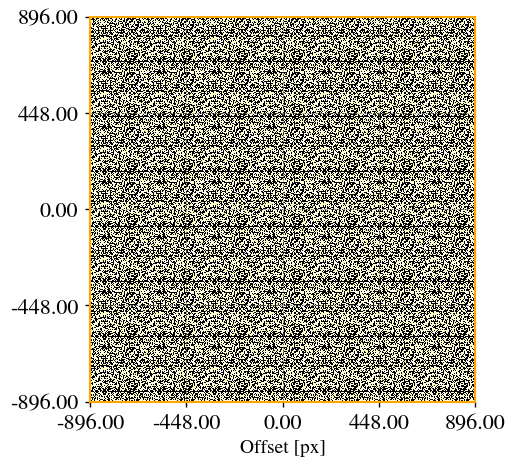

In [60]:
eimshow((seg_maps.data == 2)*ctn(input_data.filename))

In [61]:
1000*source_0.segment_flux/beam_area2(input_data.filename)

15.069243528090183

In [62]:
order_cat(cat,key='segment_flux')

[0]

Error loading fits file
Error loading fits file
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


ValueError: zero-size array to reduction operation maximum which has no identity

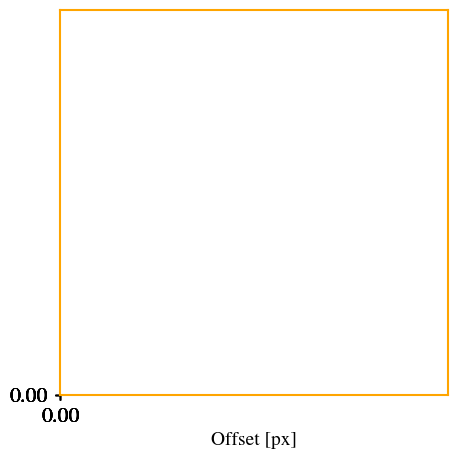

In [63]:
ax=mlibs.eimshow(ctn(input_data.filename) * (segm_deblend.data == 2) * segm_deblend.data,add_beam=True,crop=True,box_size=100,
        vmin_factor=3.0,vmax_factor=0.99, #level factor (max from peak, and min from std)
        neg_levels=np.asarray([-3]), # negative contours to draw -- which negative std level?
        CM='magma_r',
       )

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [36]:
(segm_deblend.data[segm_deblend.data==1]) * segm_deblend.data

ValueError: operands could not be broadcast together with shapes (104,) (1792,1792) 

In [27]:
segm_deblend

<photutils.segmentation.core.SegmentationImage>
shape: (1792, 1792)
nlabels: 3
labels: [1 2 3]

In [12]:
def get_ell_size_factor(psf_current, psf_large=50, ell_large=2.0, psf_small=4, ell_small=7):
    return ell_large + (ell_small - ell_large) * ((psf_current - psf_large) / (psf_small - psf_large))

In [18]:
get_ell_size_factor(psf_current = get_beam_size_px(input_data.filename)[0])

6.3735319214264825

Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-residual.cutout_south.fits
  >> Center -->  [895 896   0   0]


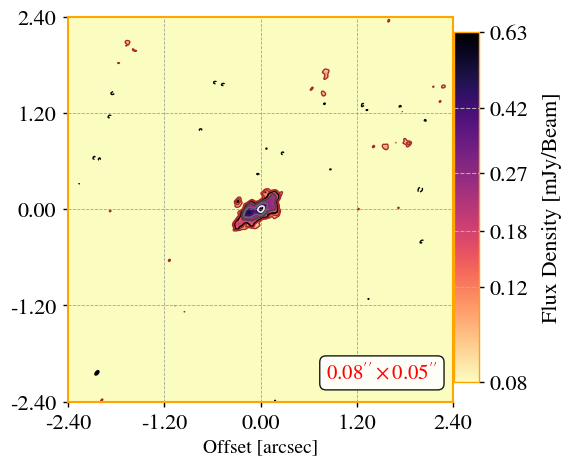

In [13]:
idx = 4
input_data=mp.read_data(filename=imagelist_eM[idx],
                        residualname=residuallist_eM[idx])
image_data = input_data.image_data_2D
residual_data = input_data.residual_data_2D

ax=mlibs.eimshow(input_data.filename,add_beam=True,crop=True,box_size=300,
        vmin_factor=3.0,vmax_factor=0.99, #level factor (max from peak, and min from std)
        neg_levels=np.asarray([-3]), # negative contours to draw -- which negative std level?
        CM='magma_r',
       )



No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


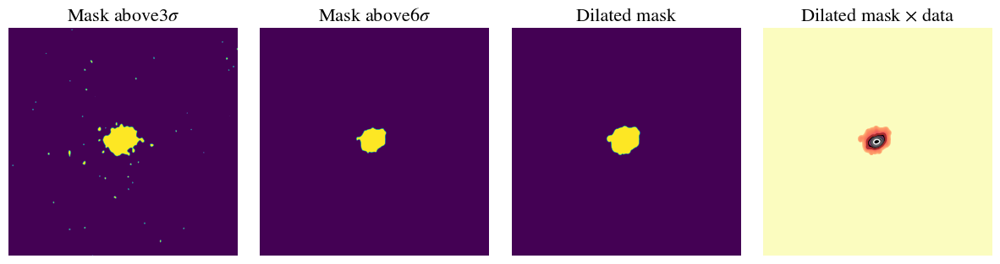

No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


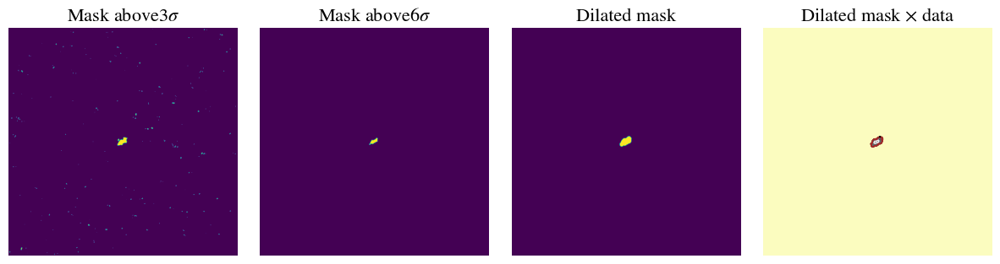

In [14]:
std = mad_std(ctn(imagelist_vla[2]))
_, mask = mask_dilation(ctn(imagelist_vla[2]), PLOT=True,dilation_type='disk',
                        sigma=6, iterations=2, dilation_size=None)
_, mask_self = mask_dilation(ctn(input_data.filename), PLOT=True,dilation_type='disk',
                        sigma=6, iterations=2, dilation_size=None)

In [15]:
input_data.filename

'/home/sagauga/pCloudDrive/PhD/data_analysis/LIRGI_sample/analysis_results/processing_images/eMERLIN_only/VV250a_C/wsclean_images_v3/MFS_images/cutouts/clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits'

In [16]:
%matplotlib inline

8.296802593879143


Deblending:   0%|          | 0/1 [00:00<?, ?it/s]

0


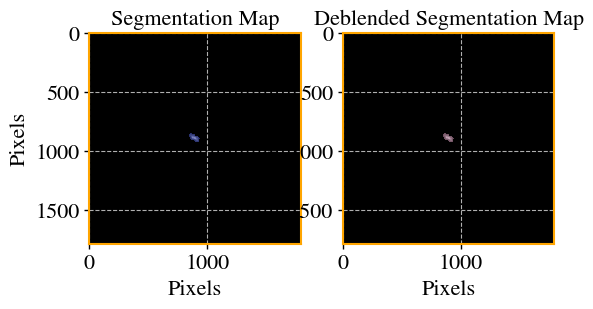

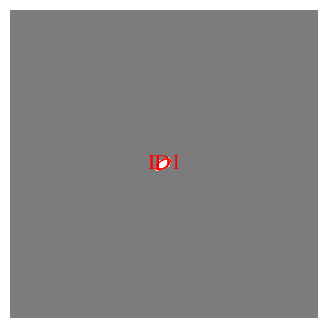

In [17]:
bwf, bhf = 2, 2
fwf, fhf = 10, 10
clean_param = 0.5
deblend_cont = 1e-3
deblend_nthresh = 3
sigma = 1.0
# ell_size_factor = 2.5
ell_size_factor = 0.2*get_ell_size_factor(psf_current = get_beam_size_px(input_data.filename)[0])
SE = mp.source_extraction(input_data, 
                          ell_size_factor = ell_size_factor, sigma = sigma,
                          bwf = bwf,bhf = bhf,fwf = fwf, fhf = fhf,
                          clean_param = clean_param, 
                          deblend_cont = deblend_cont,minarea_factor=1.0,
                          deblend_nthresh=deblend_nthresh,
                          apply_mask=True,sigma_mask=6,
                          show_petro_plots=True,
                          dry_run=True)

In [18]:
%matplotlib inline

In [19]:
SE.objects['xc'],SE.objects['yc']

(array([890]), array([893]))

Another point to consider relates to the source structure. The question: A single model component is enough to model each individual source? In the example above, two model components (one for `ID1` and the other for `ID2`) are enough to model the source emission? Lets look to the data again:

  >> Center -->  [895 896   0   0]


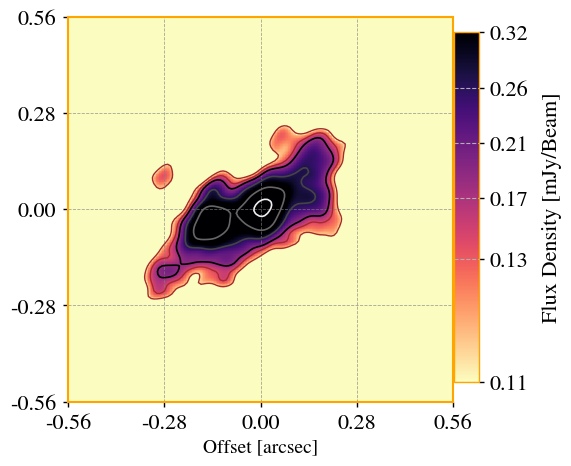

In [20]:
ax=mlibs.eimshow(input_data.filename,crop=True,box_size=70)

The answer is: probably not! So, what we can do is to specify to which source ID we may add an extra model component. The argument used for this is `ids_to_add`, which is a list. By default, the code always add an additional model component to the brightest source ID, in this case `ID1`, so `ids_to_add = [1]`. In our case, we see that we may require an additional model component to be added to `ID2`, since it contains diffuse emission around, and this extra component will try to model that. In conclusion, we may pass `ids_to_add = [1,2]`, so now we have two sources IDs (`ID1` and `ID2`) that will be modelled by four model components, `COMP_1`, `COMP_2`, `COMP_3` and `COMP_4`.

If you are happy with it, you may proceed. 

8.296802593879143


Deblending:   0%|          | 0/1 [00:00<?, ?it/s]

0
D_a =  208.10272727853354 Mpc
Linear Distance =  8.071283940867096 pc


Deblending:   0%|          | 0/1 [00:00<?, ?it/s]

0


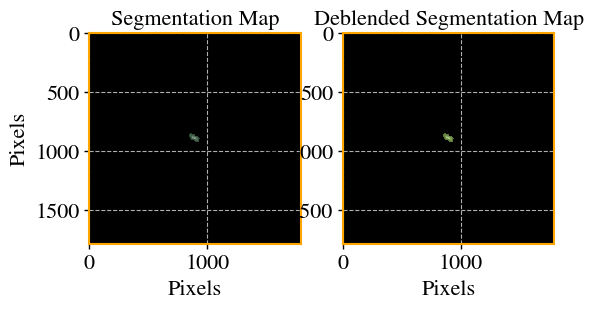

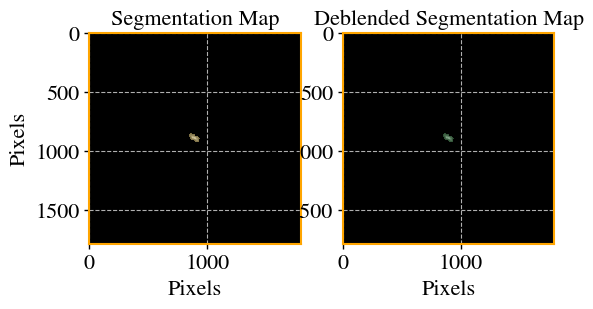

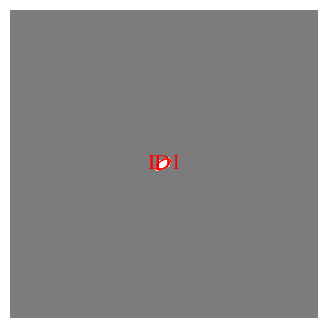

1


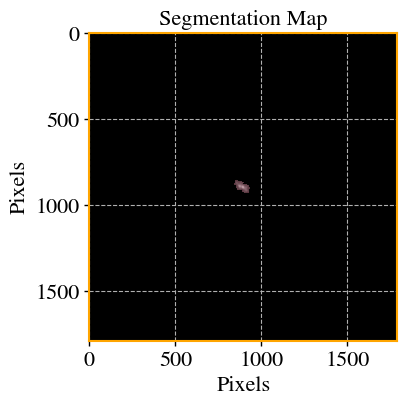

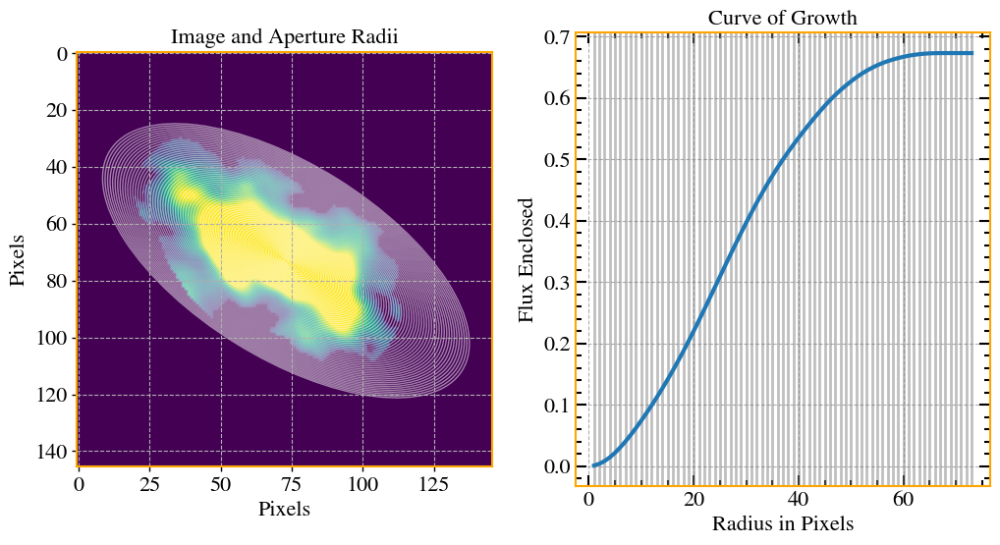

1


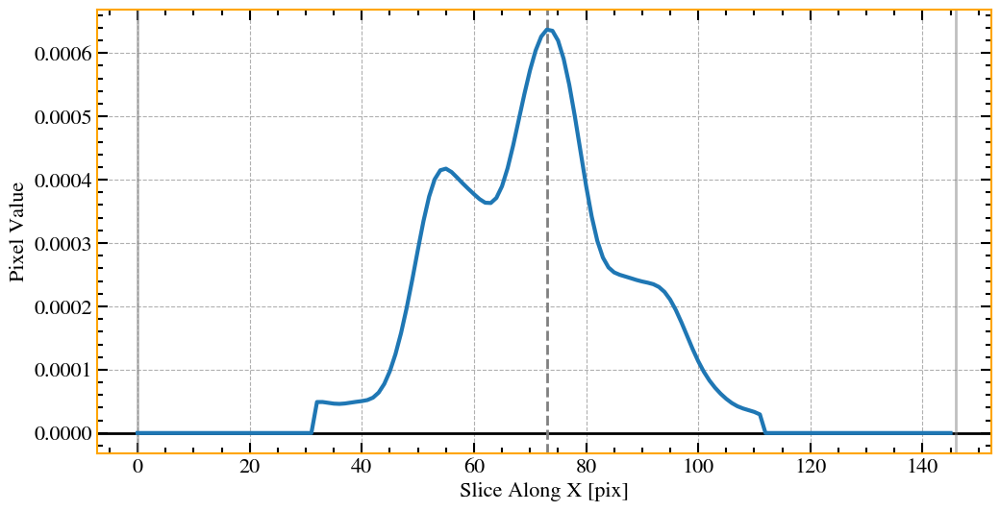

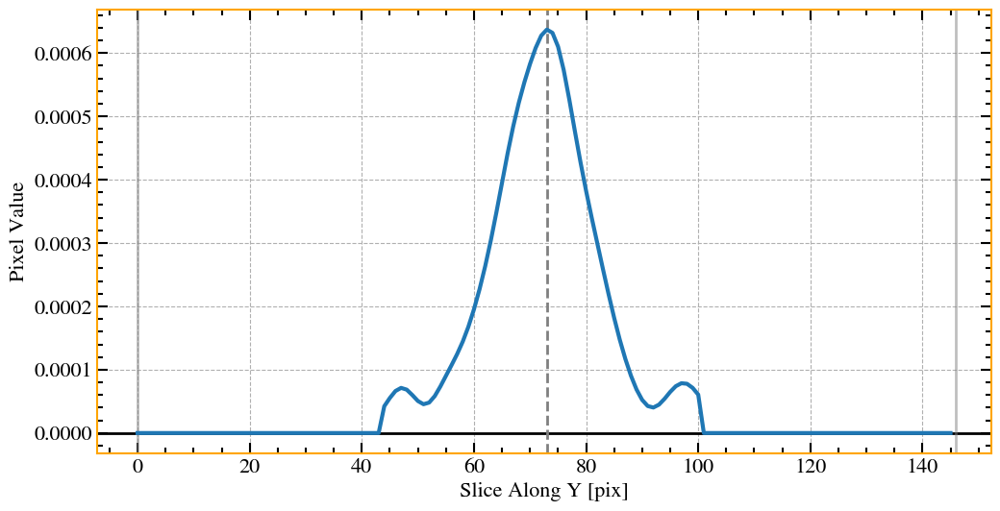

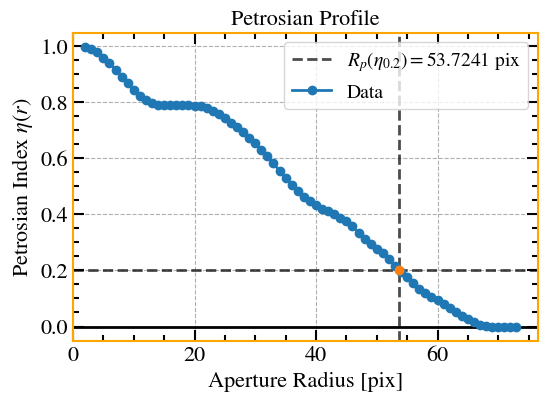

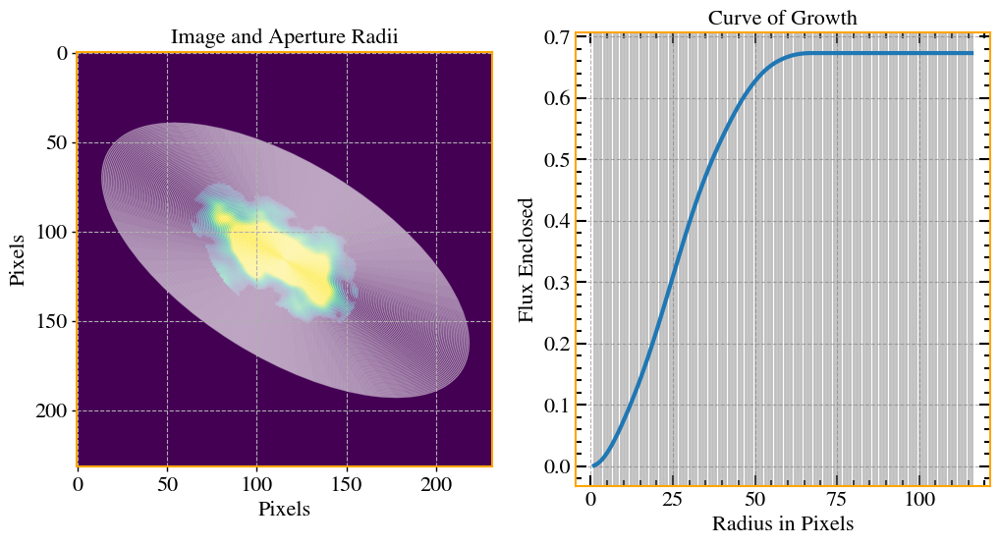

PSF SIZE is 1792


INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 03:00:47	WARN	componentlist::close	componentlist closed


# of components to be fitted = 1
# of model components to be fitted = 2


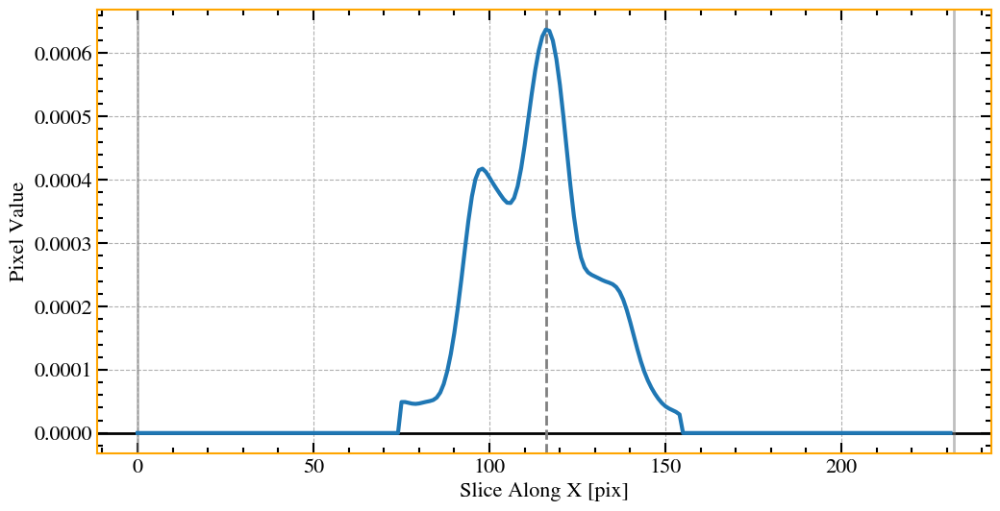

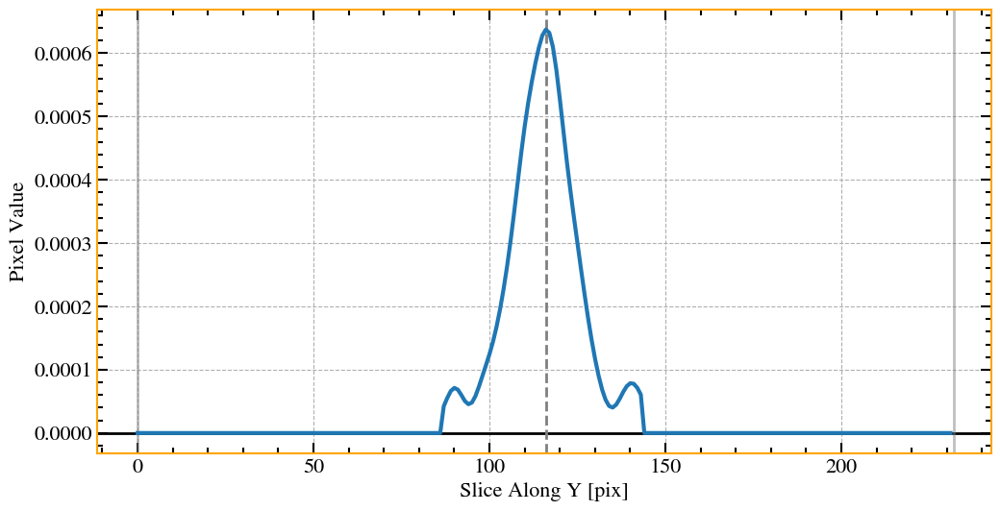

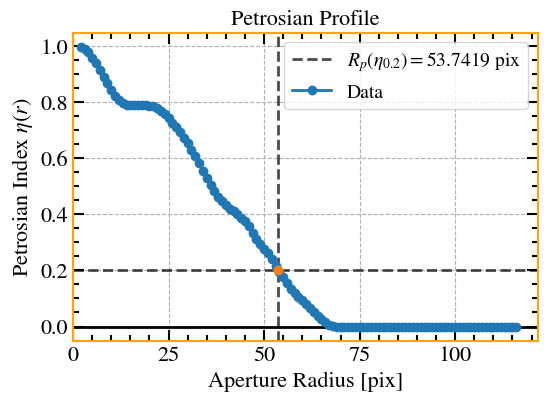

In [21]:
SE = mp.source_extraction(input_data, ids_to_add=[1],
                          ell_size_factor = ell_size_factor, sigma=sigma,
                          bwf=bwf, bhf=bhf, fwf=fwf, fhf=fhf,
                          clean_param=clean_param, 
                          deblend_cont=deblend_cont, 
                          deblend_nthresh=deblend_nthresh,
                          apply_mask=True,sigma_mask=6,
                          show_petro_plots=True,
                          dry_run=False)

In [23]:
SE.sources_photometries

{'c1_PA': 31.96485113520513,
 'c1_q': 0.4653675516424902,
 'c1_area': 4221.0,
 'c1_Re': 36.654959140364355,
 'c1_x0c': 890.3842134210754,
 'c1_y0c': 893.7421626880697,
 'c1_label': 1,
 'c1_R50': 26.742148429685937,
 'c1_R20': 14.687737547509501,
 'c1_R80': 40.797959591918385,
 'c1_C1': 0.44368353988087395,
 'c1_Snu': 0.6729420095755275,
 'c1_Rp': 53.74194838967794,
 'c1_Rpidx': 107,
 'c1_rlast': 116,
 'c1_I50': 0.00011377418961315429,
 'ncomps': 2,
 'c2_PA': 31.96485113520513,
 'c2_q': 0.4653675516424902,
 'c2_area': 4221.0,
 'c2_Re': 36.654959140364355,
 'c2_x0c': 890.3842134210754,
 'c2_y0c': 893.7421626880697,
 'c2_label': 1,
 'c2_R50': 106.96859371874375,
 'c2_R20': 14.687737547509501,
 'c2_R80': 40.797959591918385,
 'c2_C1': 0.44368353988087395,
 'c2_Snu': 0.6729420095755275,
 'c2_Rp': 53.74194838967794,
 'c2_Rpidx': 107,
 'c2_rlast': 116,
 'c2_I50': 1.137741896131543e-05}

# Sersic Multi-Fit
Now we are ready to proceed for to the fitting part. 

We can use the source extraction object `SE` to feed it into the multi-sersic fitting. 

By default, the code fixes all Sersic indeces to 0.5 for all model components. It also fixes all components to its located position during the source extraction step, but gives an interval of +/-10 px during the optimisation. 

You can modify this by passing the arguments `dr_fix = [3,3,50,50]`, meaning that `COMP_1` and `COMP_2` are very constrained, and can bary only +/- 3 pixels, while `COMP_3` and `COMP_4` are almost free, the algorithm will search in the boundary of +/- 50 pixels during opt. 


In [71]:
idx2 = 4
input_data2=mp.read_data(filename=imagelist_eM[idx2],
                        residualname=residuallist_eM[idx2])

Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-residual.cutout_south.fits


  >> Center -->  [895 896   0   0]


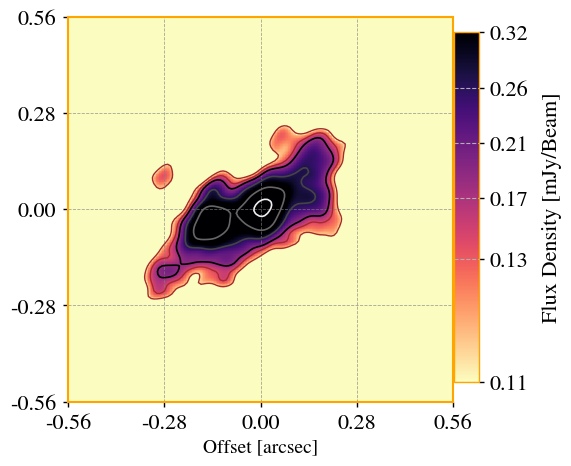

In [72]:
ax=mlibs.eimshow(input_data2.filename,crop=True,box_size=70)

#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits
rms res =  0.9969266298512375
rms data =  26.115159437877498 ; rms res =  26.03489788643095 ; ratio =  0.9969266298512375
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


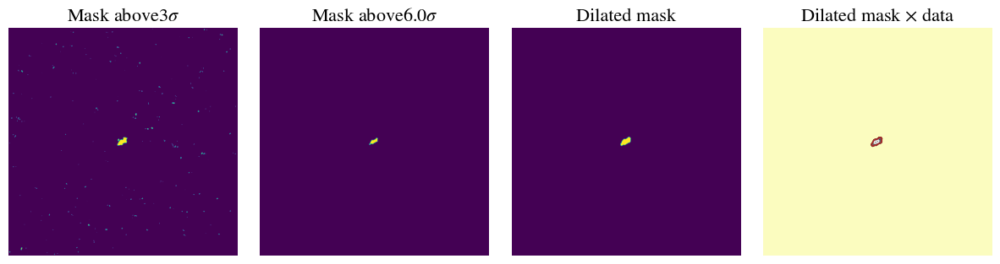

PSF BEAM SIZE is >=>  8
PSF SIZE is >=>  80
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 02:02:19	WARN	componentlist::close	componentlist closed
2023-09-25 03:02:19 - DEBUG - ---------------------------------------
2023-09-25 03:02:19 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 03:02:19 - DEBUG - ---------------------------------------
2023-09-25 03:02:19 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 887.3842134210754, 'max': 893.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 890.7421626880697, 'max': 896.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 845.3842134210754, 'max': 935.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 848.7421626880697, 'max': 938.7421626880697}, 'f2_PA': {'value': 31.

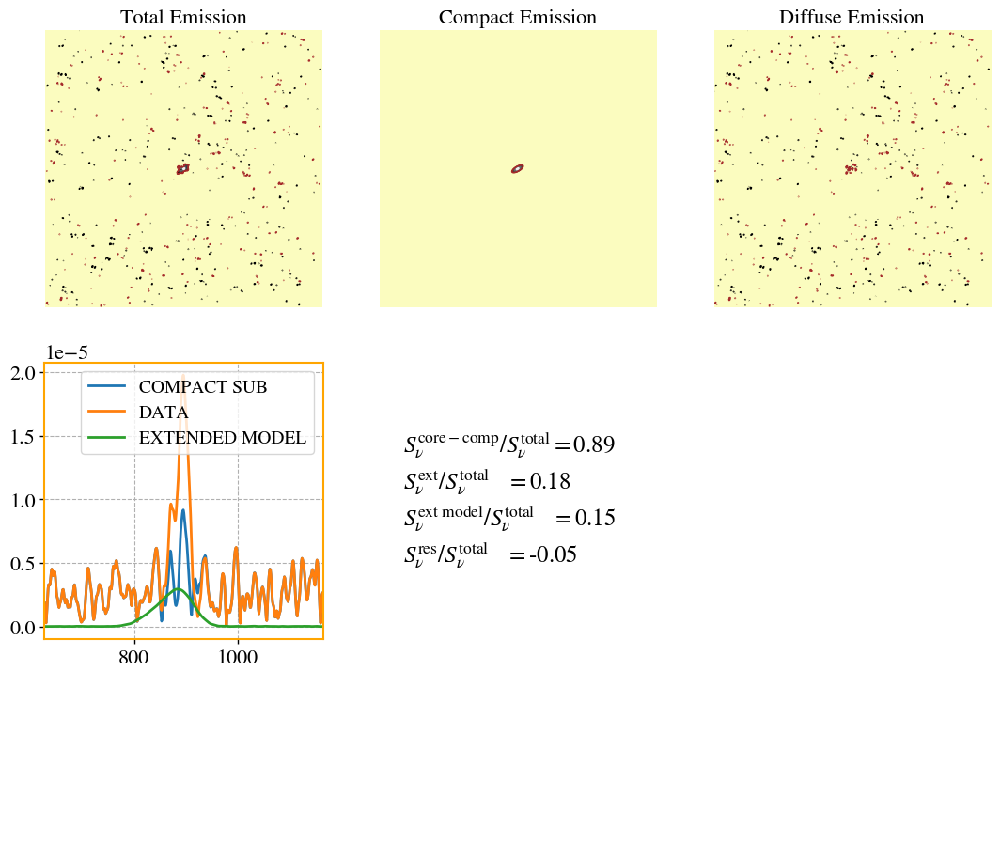

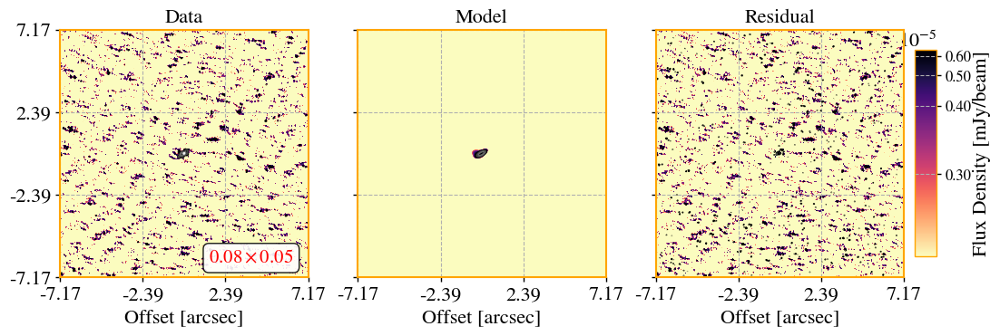

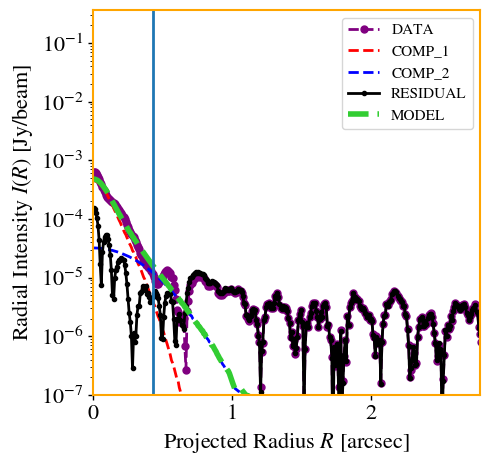

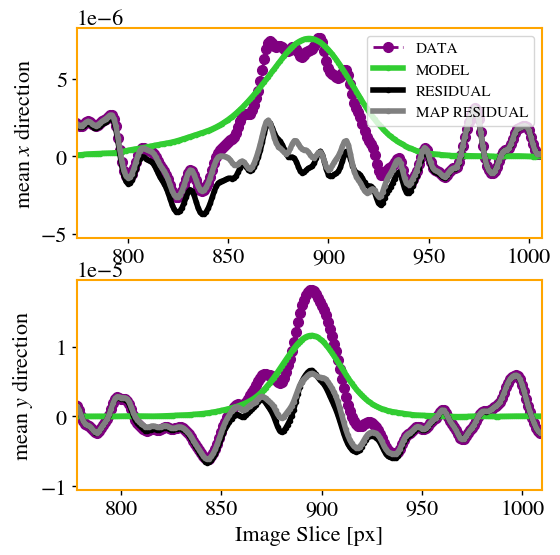

5.245936
Using rms provided...
224 896 672
8.758577656805558 15.26443044094783 22.362129397593943 26.178639860651685
Sum of fluxes =  0.006465777962234625


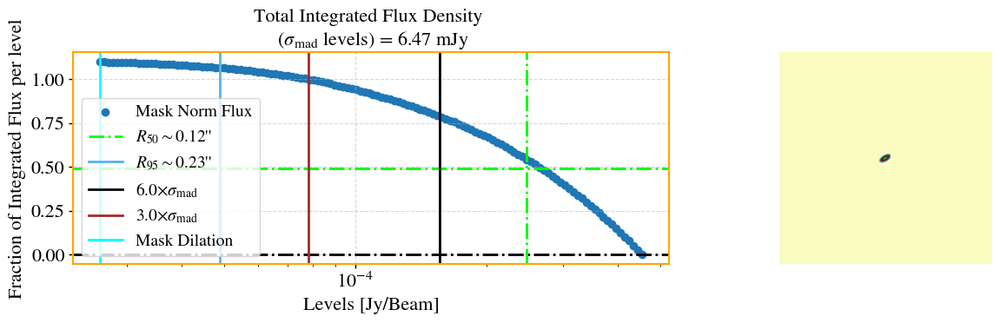

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


224 896 672
7.878478774854901 14.01417852659937 19.994929783493642 22.79912375812128
Sum of fluxes =  0.00598234076511747


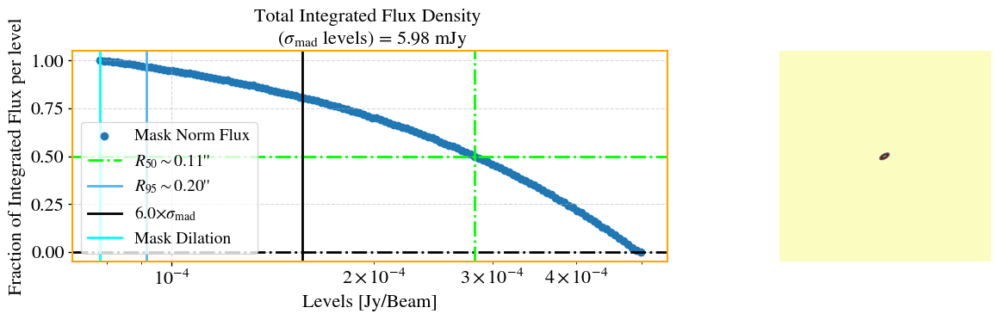

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
10.509687459947386 17.598736297155778 23.493602164050813 25.854414729132053
Sum of fluxes =  0.0011546611203165193


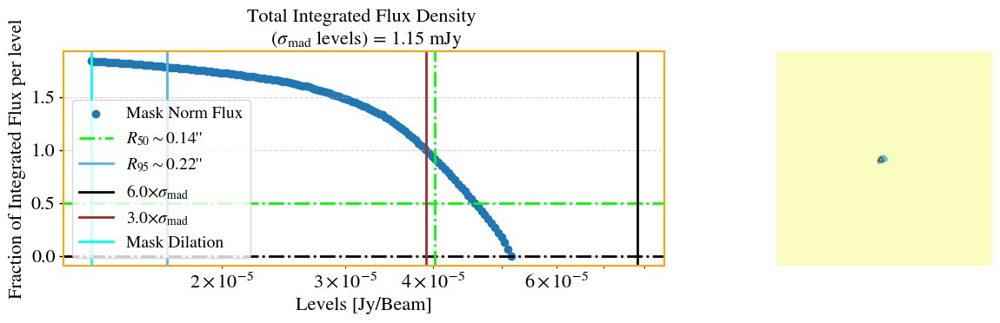

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
7.756324418739616 12.70366530947592 16.487469266111074 17.679940843579836
Sum of fluxes =  0.0006523125886823029


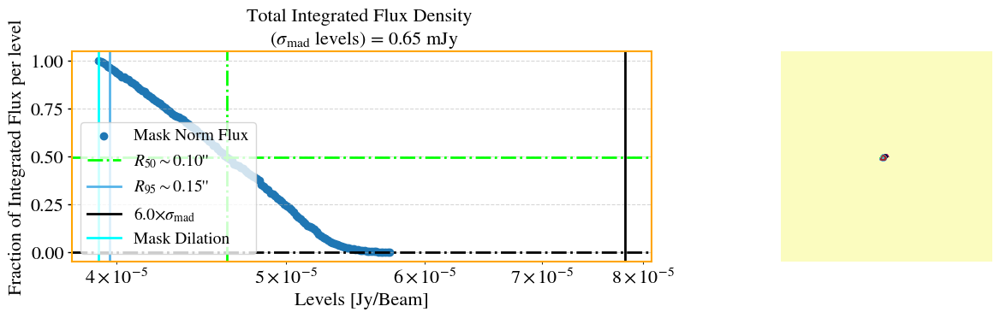

2023-09-25 03:04:19 - INFO - +--------------------------------+
2023-09-25 03:04:19 - INFO - | Core-Compact Component Sizes |
2023-09-25 03:04:19 - INFO - +--------------------------------+
2023-09-25 03:04:19 - INFO -  >=> Beam Size = 8.00 px
2023-09-25 03:04:19 - INFO -  >=> Beam Size = 41.03  pc
2023-09-25 03:04:19 - INFO -  >=> Rn Main Compact = 128.72  pc
2023-09-25 03:04:19 - INFO -  >=> C50 Compact Deconv Radii = 71.88  pc
2023-09-25 03:04:19 - INFO -  >=> C50 Compact Conv Radii = 78.29  pc
2023-09-25 03:04:19 - INFO -  >=> C95 Compact Deconv Radii = 126.27  pc
2023-09-25 03:04:19 - INFO -  >=> C95 Compact Conv Radii = 148.54  pc
2023-09-25 03:04:19 - INFO - +----------------------------+
2023-09-25 03:04:19 - INFO - | Extended Component Sizes |
2023-09-25 03:04:19 - INFO - +----------------------------+
2023-09-25 03:04:19 - INFO -  >=> C50 Extended Deconv Radii = 65.16  pc
2023-09-25 03:04:19 - INFO -  >=> C50 Extended Conv Radii = 90.26  pc
2023-09-25 03:04:19 - INFO -  >=> C

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc


In [73]:
smfr = mp.sersic_multifit_radio(input_data2,
                                SE, #source extraction object, from previous step
                                which_residual = 'shuffled',
                                fix_geometry=True,
                                comp_ids=['1'],# which component ID is compact?
                                dr_fix=[3,45,45,150,150, 150],#fix (x0,y0) positions
                                aspect=None,z = z_d['VV250'])#elliptical or circular gaussian for beam convolution? 

In [64]:
smfr.lmfit_results[0]

name,value,standard error,relative error,initial value,min,max,vary
f1_x0,901.325012,0.30157673,(0.03%),901.3250179485672,901.324995,907.324995,True
f1_y0,898.432837,0.16113188,(0.02%),898.4332512409337,898.045126,904.045126,True
f1_PA,41.7549650,0.58508693,(1.40%),41.777035516733896,-46.0390849,133.960915,True
f1_ell,0.53115151,0.00594202,(1.12%),0.531702373615401,0.05956302,0.59563022,True
f1_n,0.51000000,0.01914551,(3.75%),0.5099999999999881,0.49000000,0.51000000,True
f1_In,2.0880e-04,7.5507e-06,(3.62%),0.00020867787189317278,9.2127e-06,0.00921269,True
f1_Rn,19.0786062,2.11790413,(11.10%),19.075221645988563,0.16581916,24.8728746,True
f1_cg,-0.00999893,0.06339424,(634.01%),-0.009998729326071109,-0.01000000,0.01000000,True
f2_x0,875.175341,0.27492465,(0.03%),875.1772936126288,869.890612,875.890612,True
f2_y0,887.578034,0.12865830,(0.01%),887.5780337659379,881.578034,887.578034,True


In [39]:
smfr.C50comp_radii_deconv/smfr.pix_to_pc

0    16.803002
Name: C50radii, dtype: float64

### Check decomposition results: Compact vs Extended

In [40]:
print(f"Compact Flux Convolved Model = {smfr.results_compact_conv_morpho['total_flux_mask'][0]*1000:.2f} mJy")
print(f"Compact Flux Deconvolved Model = {smfr.results_compact_deconv_morpho['total_flux_mask'][0]*1000:.2f} mJy")
print(f"Extended Flux Convolved Model = {smfr.results_ext_conv_morpho['total_flux_mask'][0]*1000:.2f} mJy")
print(f"Extended Flux Deconvolved Model = {smfr.results_ext_deconv_morpho['total_flux_mask'][0]*1000:.2f} mJy")
# sum
print(f"Total flux in model = {smfr.results_fit['flux_density_model'][0]:.2f} mJy")
print(f"Total flux in data = {smfr.results_fit['flux_data'][0]:.2f} mJy")
print(f"Total flux in res = {smfr.results_fit['flux_res'][0]:.2f} mJy")
print(f"Total flux in compact = {smfr.results_fit['flux_density_compact'][0]:.2f} mJy")
print(f"Total flux in extended = {smfr.results_fit['flux_density_extended_model'][0] + smfr.results_fit['flux_res'][0]:.2f} mJy")


# smfr.results_fit['flux_density_extended_model']

Compact Flux Convolved Model = 7.46 mJy
Compact Flux Deconvolved Model = 7.56 mJy
Extended Flux Convolved Model = 0.96 mJy
Extended Flux Deconvolved Model = 1.00 mJy
Total flux in model = 10.66 mJy
Total flux in data = 10.29 mJy
Total flux in res = -0.37 mJy
Total flux in compact = 8.80 mJy
Total flux in extended = 1.49 mJy


In [92]:
1.2*0.008

0.0096

In [93]:
mlibs.Tb_source(0.006,6,2*smfr.results_compact_deconv_morpho['C50radii']*0.008,2*0.7*smfr.results_compact_deconv_morpho['C50radii']*0.008,0.04)

0    0.061114
Name: C50radii, dtype: float64

### Compute SFR Estimates for Diffuse Structures

In [94]:
SFR = mp.radio_star_formation(input_data,smfr,z=z_d['VV705'])

2023-09-24 19:03:57 - INFO - Using frequency of 5.95 GHz for star formation estimate.
2023-09-24 19:03:57 - INFO - +-----------------+
2023-09-24 19:03:57 - INFO - | SFR Estimates |
2023-09-24 19:03:57 - INFO - +-----------------+
2023-09-24 19:03:57 - INFO -  ==> SFR =15.15 +/- -2.56 Mo/yr
2023-09-24 19:03:57 - INFO - +------------------+
2023-09-24 19:03:57 - INFO - | sSFR Estimates |
2023-09-24 19:03:57 - INFO - +------------------+
2023-09-24 19:03:57 - INFO -  >=> Deconvolved A50 sSFR = 203.49 Mo/(yr kpc^2)
2023-09-24 19:03:57 - INFO -  >=> Convolved A50 sSFR = 155.79 Mo/(yr kpc^2)
2023-09-24 19:03:57 - INFO -  >=> Deconvolved A95 sSFR = 100.09 Mo/(yr kpc^2)
2023-09-24 19:03:57 - INFO -  >=> Convolved A95 sSFR = 71.29 Mo/(yr kpc^2)
2023-09-24 19:03:57 - INFO - +--------------------------+
2023-09-24 19:03:57 - INFO - | Brightness Temperature |
2023-09-24 19:03:57 - INFO - +--------------------------+
2023-09-24 19:03:57 - INFO -  ==> TB Rn Fit = 0.05 e5 K
2023-09-24 19:03:57 - INF

D_a =  169.24419931373572 Mpc
Linear Distance =  6.564152262058192 pc


In [41]:
SFR.SFR_ext

54.16879856954245

In [42]:
SFR = mp.radio_star_formation(input_data,smfr,z=z_d['VV705'],calibration_kind='Murphy11')

2023-09-24 06:10:24 - INFO - Using frequency of 5.95 GHz for star formation estimate.
2023-09-24 06:10:24 - INFO - +-----------------+
2023-09-24 06:10:24 - INFO - | SFR Estimates |
2023-09-24 06:10:24 - INFO - +-----------------+
2023-09-24 06:10:24 - INFO -  ==> SFR =84.17 +/- 0.42 Mo/yr
2023-09-24 06:10:24 - INFO - +------------------+
2023-09-24 06:10:24 - INFO - | sSFR Estimates |
2023-09-24 06:10:24 - INFO - +------------------+
2023-09-24 06:10:24 - INFO -  >=> Deconvolved A50 sSFR = 277.98 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Convolved A50 sSFR = 276.17 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Deconvolved A95 sSFR = 96.88 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Convolved A95 sSFR = 97.52 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO - +--------------------------+
2023-09-24 06:10:24 - INFO - | Brightness Temperature |
2023-09-24 06:10:24 - INFO - +--------------------------+
2023-09-24 06:10:24 - INFO -  ==> TB Rn Fit = 0.05 e5 K
2023-09-24 06:10:24 - INFO 

D_a =  169.24419931373572 Mpc
Linear Distance =  6.564152262058192 pc


In [43]:
84/12

7.0

In [44]:
SFR = mp.radio_star_formation(input_data,smfr,z=z_d['VV705'],calibration_kind='Murphy12')

2023-09-24 06:10:24 - INFO - Using frequency of 5.95 GHz for star formation estimate.
2023-09-24 06:10:24 - INFO - +-----------------+
2023-09-24 06:10:24 - INFO - | SFR Estimates |
2023-09-24 06:10:24 - INFO - +-----------------+
2023-09-24 06:10:24 - INFO -  ==> SFR =54.17 +/- 0.27 Mo/yr
2023-09-24 06:10:24 - INFO - +------------------+
2023-09-24 06:10:24 - INFO - | sSFR Estimates |
2023-09-24 06:10:24 - INFO - +------------------+
2023-09-24 06:10:24 - INFO -  >=> Deconvolved A50 sSFR = 178.90 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Convolved A50 sSFR = 177.74 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Deconvolved A95 sSFR = 62.35 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO -  >=> Convolved A95 sSFR = 62.76 Mo/(yr kpc^2)
2023-09-24 06:10:24 - INFO - +--------------------------+
2023-09-24 06:10:24 - INFO - | Brightness Temperature |
2023-09-24 06:10:24 - INFO - +--------------------------+
2023-09-24 06:10:24 - INFO -  ==> TB Rn Fit = 0.05 e5 K
2023-09-24 06:10:24 - INFO 

D_a =  169.24419931373572 Mpc
Linear Distance =  6.564152262058192 pc


In [45]:
SFR = mp.radio_star_formation(input_data,smfr,z=z_d['VV705'],calibration_kind='Tabatabaei2017')

2023-09-24 06:10:25 - INFO - Using frequency of 5.95 GHz for star formation estimate.
2023-09-24 06:10:25 - INFO - +-----------------+
2023-09-24 06:10:25 - INFO - | SFR Estimates |
2023-09-24 06:10:25 - INFO - +-----------------+
2023-09-24 06:10:25 - INFO -  ==> SFR =183.84 +/- 0.91 Mo/yr
2023-09-24 06:10:25 - INFO - +------------------+
2023-09-24 06:10:25 - INFO - | sSFR Estimates |
2023-09-24 06:10:25 - INFO - +------------------+
2023-09-24 06:10:25 - INFO -  >=> Deconvolved A50 sSFR = 607.16 Mo/(yr kpc^2)
2023-09-24 06:10:25 - INFO -  >=> Convolved A50 sSFR = 603.21 Mo/(yr kpc^2)
2023-09-24 06:10:25 - INFO -  >=> Deconvolved A95 sSFR = 211.61 Mo/(yr kpc^2)
2023-09-24 06:10:25 - INFO -  >=> Convolved A95 sSFR = 213.01 Mo/(yr kpc^2)
2023-09-24 06:10:25 - INFO - +--------------------------+
2023-09-24 06:10:25 - INFO - | Brightness Temperature |
2023-09-24 06:10:25 - INFO - +--------------------------+
2023-09-24 06:10:25 - INFO -  ==> TB Rn Fit = 0.05 e5 K
2023-09-24 06:10:25 - IN

D_a =  169.24419931373572 Mpc
Linear Distance =  6.564152262058192 pc


### Sizes of the components

In [46]:
print(f"Redshift of VV705 = {z_d['VV705']}")
pix_to_pc = pixsize_to_pc(z=z_d['VV705'],
                          cell_size=get_cell_size(input_data.filename))

Redshift of VV705 = 0.04019
D_a =  169.24419931373572 Mpc
Linear Distance =  6.564152262058192 pc


In [47]:
smfr.results_fit['f1_Rn'] * pix_to_pc

0    152.448693
Name: f1_Rn, dtype: float64

In [48]:
smfr.results_compact_deconv_morpho['C50radii'] * pix_to_pc

0    117.288161
Name: C50radii, dtype: float64

In [49]:
smfr.results_compact_conv_morpho['C50radii'] * pix_to_pc

0    130.935894
Name: C50radii, dtype: float64

In [50]:
smfr.results_compact_deconv_morpho['max'] / smfr.results_compact_deconv_morpho['total_flux_mask']

0    0.202533
dtype: float64

In [51]:
smfr.results_ext_deconv_morpho['max'] / smfr.results_ext_deconv_morpho['total_flux_mask']

0    0.026062
dtype: float64

In [52]:
smfr.results_compact_deconv_morpho['C50radii']

0    17.867983
Name: C50radii, dtype: float64

## Area of emission

In [53]:
A50_kpc_comp_deconv = smfr.results_compact_deconv_morpho['A50']*smfr.results_compact_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_comp_conv = smfr.results_compact_conv_morpho['A50']*smfr.results_compact_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_ext_conv = smfr.results_ext_conv_morpho['A50']*smfr.results_ext_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_ext_deconv = smfr.results_ext_deconv_morpho['A50']*smfr.results_ext_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)

A95_kpc_comp_deconv = smfr.results_compact_deconv_morpho['A95']*smfr.results_compact_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_comp_conv = smfr.results_compact_conv_morpho['A95']*smfr.results_compact_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_ext_conv = smfr.results_ext_conv_morpho['A95']*smfr.results_ext_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_ext_deconv = smfr.results_ext_deconv_morpho['A95']*smfr.results_ext_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)


print(f"Core-compact 50% Deconvolved Area ={A50_kpc_comp_deconv[0]*1000} kpc^2 x 1e3")
print(f"Core-compact 50% Convolved Area ={A50_kpc_comp_conv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 50% Deconvolved Area ={A50_kpc_ext_deconv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 50% Convolved Area ={A50_kpc_ext_conv[0]*1000} kpc^2 x 1e3")

print(f"Core-compact 95% Deconvolved Area ={A95_kpc_comp_deconv[0]*1000} kpc^2 x 1e3")
print(f"Core-compact 95% Convolved Area ={A95_kpc_comp_conv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 95% Deconvolved Area ={A95_kpc_ext_deconv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 95% Convolved Area ={A95_kpc_ext_conv[0]*1000} kpc^2 x 1e3")

Core-compact 50% Deconvolved Area =43.21735920424213 kpc^2 x 1e3
Core-compact 50% Convolved Area =53.8601186493546 kpc^2 x 1e3
Nuclear Ext 50% Deconvolved Area =302.7800429992118 kpc^2 x 1e3
Nuclear Ext 50% Convolved Area =304.76209536550806 kpc^2 x 1e3
Core-compact 95% Deconvolved Area =184.2877819706317 kpc^2 x 1e3
Core-compact 95% Convolved Area =253.87505526559784 kpc^2 x 1e3
Nuclear Ext 95% Deconvolved Area =868.7421697666299 kpc^2 x 1e3
Nuclear Ext 95% Convolved Area =863.0545412372581 kpc^2 x 1e3


In [54]:
sSFR50_deconv_ext = SFR.SFR_ext/A50_kpc_ext_deconv
sSFR50_conv_ext = SFR.SFR_ext/A50_kpc_ext_conv
sSFR95_deconv_ext = SFR.SFR_ext/A95_kpc_ext_deconv
sSFR95_conv_ext = SFR.SFR_ext/A95_kpc_ext_conv
print(f"sSFR Extended Deconv 50% {sSFR50_deconv_ext[0]:.2f}")
print(f"sSFR Extended Conv 50% {sSFR50_conv_ext[0]:.2f}")
print(f"sSFR Extended Deconv 95% {sSFR95_deconv_ext[0]:.2f}")
print(f"sSFR Extended Conv 95% {sSFR95_conv_ext[0]:.2f}")

sSFR Extended Deconv 50% 607.16
sSFR Extended Conv 50% 603.21
sSFR Extended Deconv 95% 211.61
sSFR Extended Conv 95% 213.01


In [55]:
smfr.results_compact_deconv_morpho['A50']

0    3.414246
Name: A50, dtype: float64

In [56]:
smfr.results_compact_deconv_morpho['beam_area']

0    293.769137
Name: beam_area, dtype: float64

In [46]:
smfr.results_fit.keys()

Index(['f1_x0', 'f1_y0', 'f1_PA', 'f1_ell', 'f1_n', 'f1_In', 'f1_Rn', 'f1_cg',
       'f2_x0', 'f2_y0', 'f2_PA', 'f2_ell', 'f2_n', 'f2_In', 'f2_Rn', 'f2_cg',
       's_a', '#imagename', 'residualname', 'beam_size_px', 'flux_data',
       'flux_density_ext', 'flux_density_ext2', 'flux_density_ext_self_rms',
       'flux_density_extended_model', 'flux_density_compact',
       'flux_density_model', 'flux_res'],
      dtype='object')

In [47]:
def Tb_source(Snu,freq,theta1,theta2,z):
    const = 1.8e9 * (1+z)*1000
    return(((const * Snu)/(freq*freq*(theta1*1000)*(theta2*1000)))/1e5)

In [48]:
frequency = mlibs.get_frequency(input_data.filename)
flux_density_compact = smfr.results_compact_deconv_morpho['total_flux_mask']
cell_size = get_cell_size(input_data.filename)
theta1 = 2*cell_size*smfr.results_fit['f1_Rn']
theta2 = 2*(1-smfr.results_fit['f1_ell'])*cell_size*smfr.results_fit['f1_Rn']

In [49]:
TB = Tb_source(Snu=flux_density_compact,
          freq=frequency,
          theta1=theta1, theta2=theta2,
          z=z_d['VV705'])
print(f"TB of core-compact:{TB[0]:.2f}e5 K")

TB of core-compact:7.31e5 K


# Run code on a list of image files

  >> Center -->  [895 897   0   0]


<Axes: xlabel='Offset [arcsec]'>

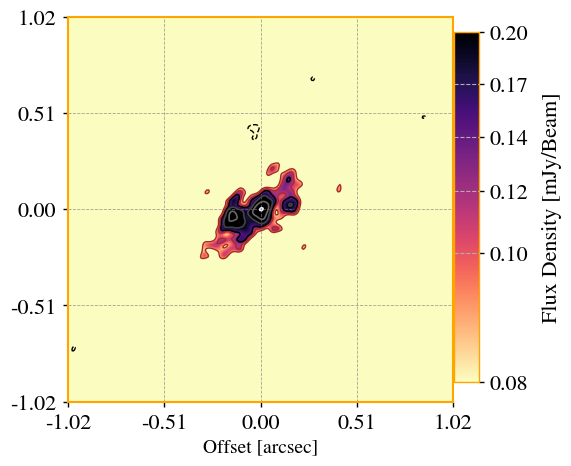

In [28]:
eimshow(imagelist_eM[3],crop=True)

In [29]:
mp.sersic_multifit_radio??

Init signature:
mp.sersic_multifit_radio(
    input_data,
    SE,
    aspect=None,
    which_residual='shuffled',
    fix_geometry=True,
    comp_ids=['1'],
    fix_n=None,
    fix_value_n=None,
    dr_fix=None,
    sigma=6.0,
    convolution_mode='GPU',
    method1='least_squares',
    method2='least_squares',
    z=0.01,
)
Source:        
class sersic_multifit_radio():
    """
    Multi-Sersic Fitting Decomposition.

    Perform a semi-automated and robust multi-sersic image decomposition.
    It supports GPU-acceleration using Jax. If no GPU is present, Jax still 
    will benefit from CPU parallel processing. Do not worry, you do not have 
    to change anything, Jax will automatically detect wheter you are runnin on
    CPU or GPU. 

    Basic principles:
        - run a source extraction, to identify relevant emission.
        - compute basic properties for each identified region, such as
          size, intensity, shape and orientation
        - uses that information to construc

Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-1.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-1.0-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-1.0-MFS-image.cutout_south.fits
rms res =  1.0
rms data =  76.51036954150722 ; rms res =  76.51036954150722 ; ratio =  1.0
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: divide by zero encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: invalid value encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)


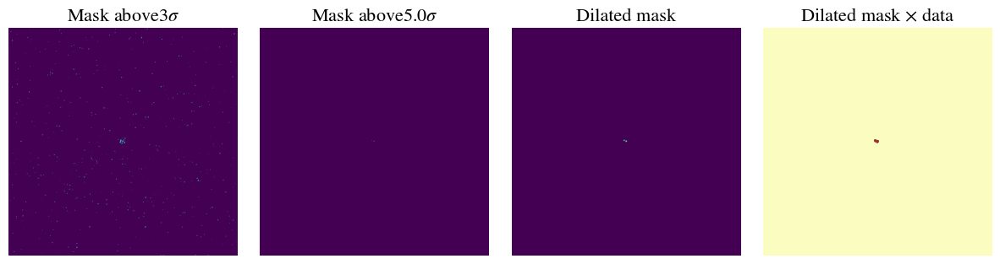

PSF BEAM SIZE is >=>  4
PSF SIZE is >=>  40
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 10:21:42	WARN	componentlist::close	componentlist closed
2023-09-25 11:21:42 - DEBUG - ---------------------------------------
2023-09-25 11:21:42 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 11:21:42 - DEBUG - ---------------------------------------
2023-09-25 11:21:42 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:9077: RuntimeWarning: divide by zero encountered in scalar divide
  ax.annotate(r"$S_\nu^{\rm core-comp}/S_\nu^{\rm total}=$"+'{:0.2f}'.format(flux_density_compact/flux_data),
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:9079: RuntimeWarning: invalid value encountered in scalar divide
  ax.annotate(r"$S_\nu^{\rm ext}/S_\nu^{\rm total}\ \ \ =$"+'{:0.2f}'.format(flux_density_ext2/flux_data),
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:9081: RuntimeWarning: invalid value encountered in scalar divide
  ax.annotate(r"$S_\nu^{\rm ext \ model}/S_\nu^{\rm total}\ \ \ =$"+'{:0.2f}'.format(flux_density_extended_model/flux_data),
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:9083: RuntimeWarning: divide by zero encountered in scalar divide
  ax.annotate(r"$S_\nu^{\rm res}/S_\nu^{\rm total}\ \ \ =$"+'{:0.2f}'.format(flux_res/flux_data),


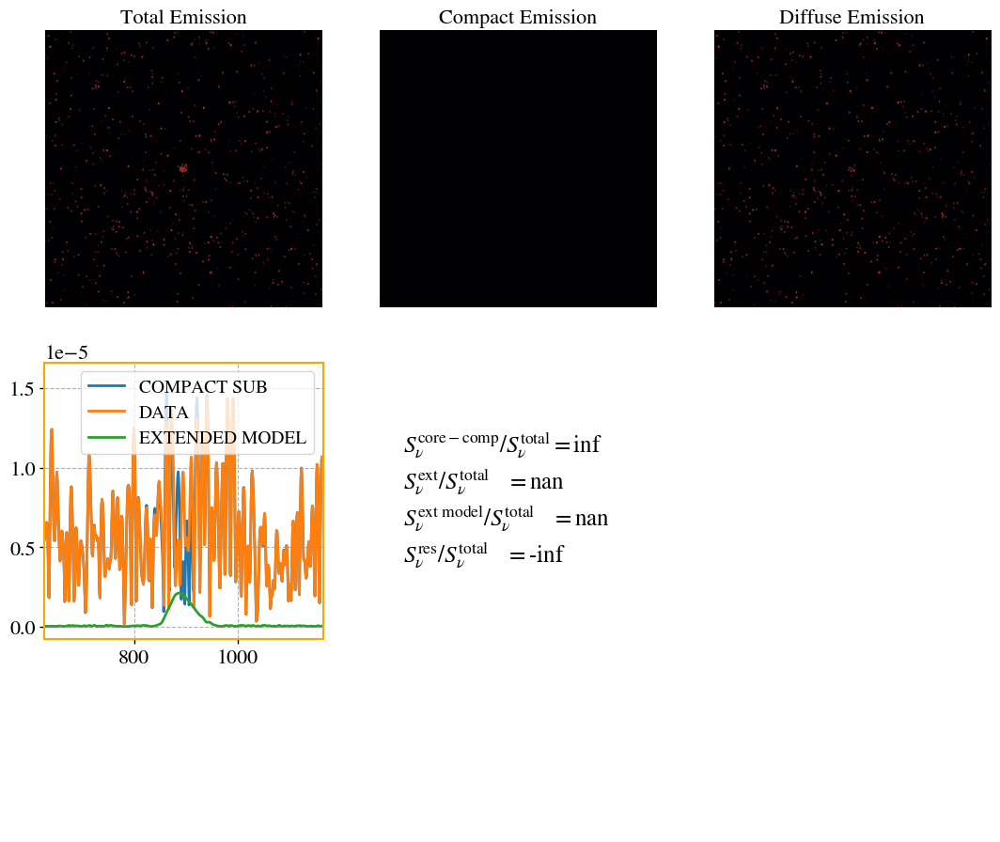

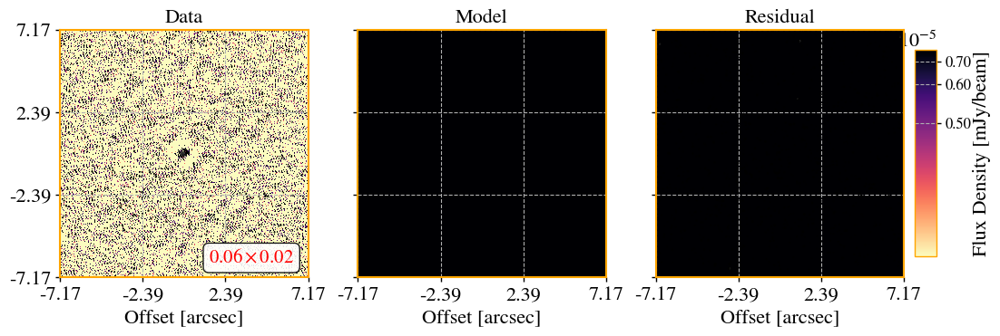

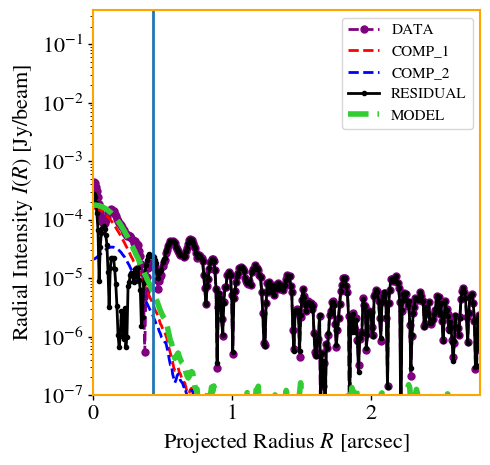

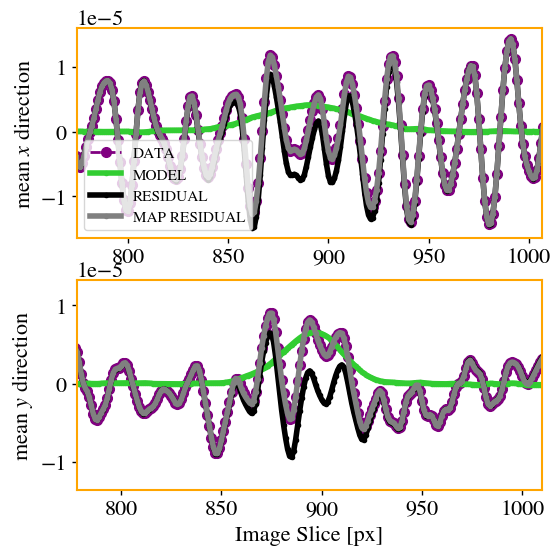

5.245936
Using rms provided...
224 896 672
non real ellipse
non real ellipse
non real ellipse
non real ellipse


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in divide
  qmedian = np.nanmedian(BB / AA)
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:264: RuntimeWarning: invalid value encountered in divide
  qmi = np.nanmedian((BB / AA)[:rsplit])
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:265: RuntimeWarning: invalid value encountered in divide
  qmo = np.nanmedian((BB / AA)[rsplit:])


2.7057581899030048 4.820437914901168 6.206085419025319 6.6755811781245455


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:3505: RuntimeWarning: divide by zero encountered in divide
  ax1.scatter(levels[:], np.cumsum(fluxes) / results['total_flux_mask'],


Sum of fluxes =  0.0008970209194199794


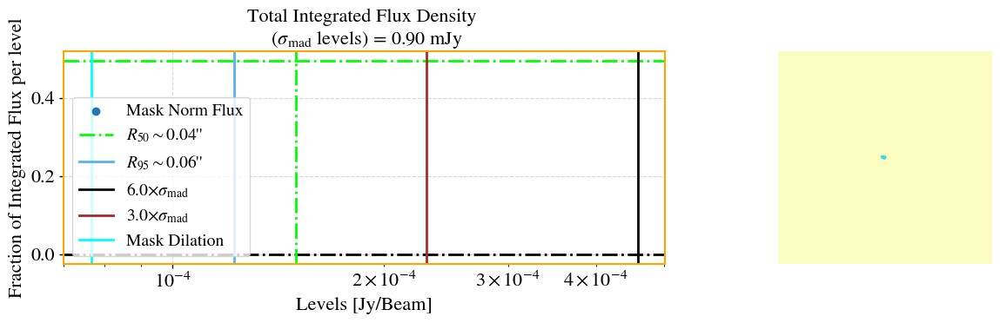

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-0.5-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-0.5-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.-0.5-MFS-image.cutout_south.fits
rms res =  0.9998656017785168
rms data =  50.40279137931087 ; rms res =  50.3960173337917 ; ratio =  0.9998656017785168
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: divide by zero encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: invalid value encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)


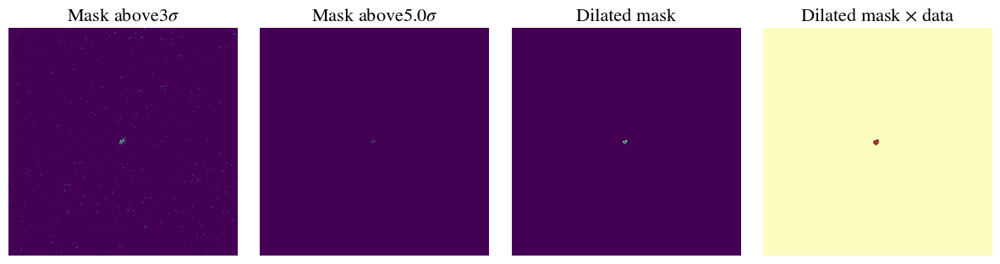

PSF BEAM SIZE is >=>  4
PSF SIZE is >=>  40
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 10:28:53	WARN	componentlist::close	componentlist closed
2023-09-25 11:28:52 - DEBUG - ---------------------------------------
2023-09-25 11:28:52 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 11:28:52 - DEBUG - ---------------------------------------
2023-09-25 11:28:52 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

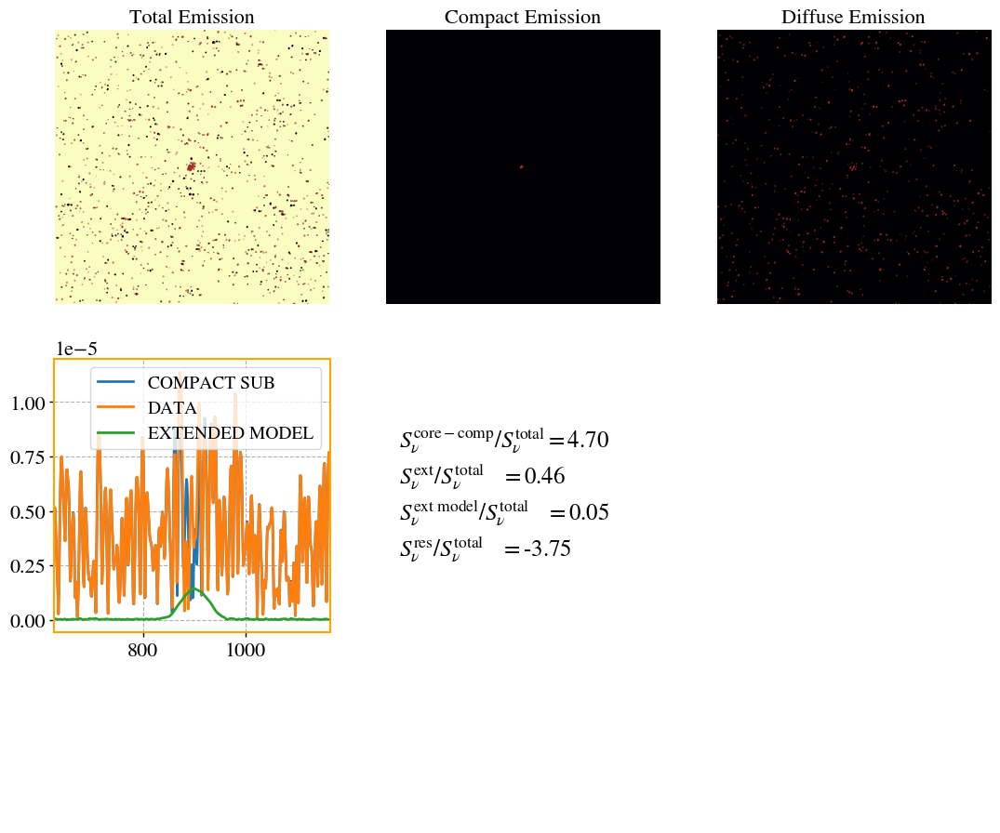

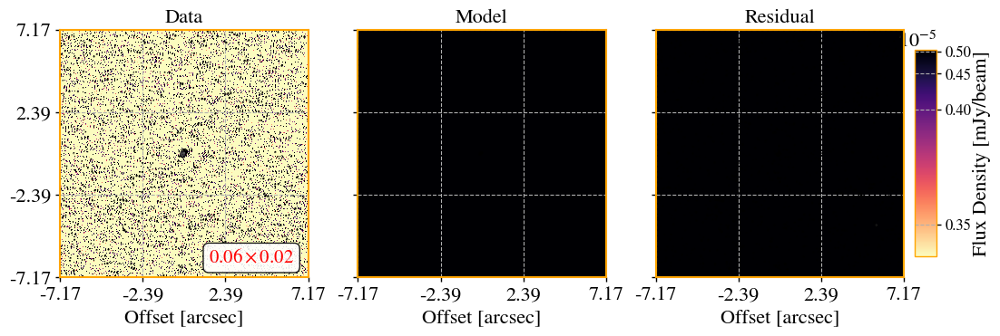

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


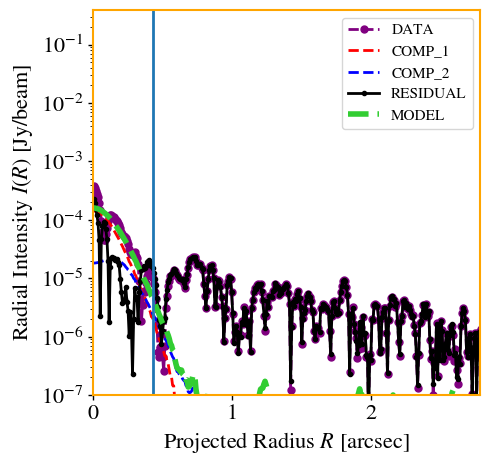

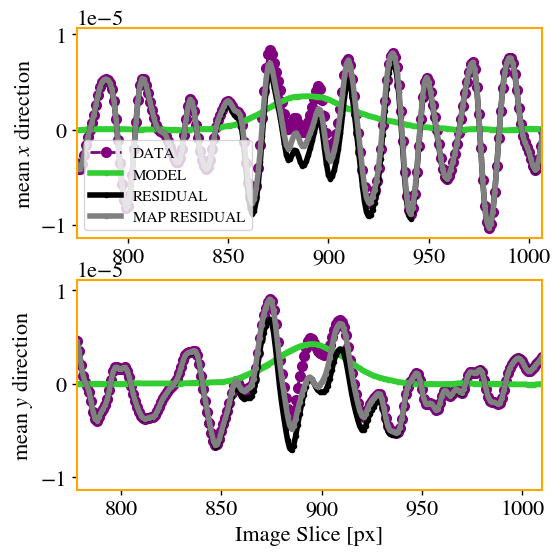

5.245936
Using rms provided...
224 896 672
non real ellipse
non real ellipse
non real ellipse
non real ellipse
non real ellipse
non real ellipse


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in divide
  qmedian = np.nanmedian(BB / AA)
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:264: RuntimeWarning: invalid value encountered in divide
  qmi = np.nanmedian((BB / AA)[:rsplit])
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:265: RuntimeWarning: invalid value encountered in divide
  qmo = np.nanmedian((BB / AA)[rsplit:])


4.652426491681278 7.527227892173502 9.981532666656284 10.954580187815921
Sum of fluxes =  0.002017993329929214


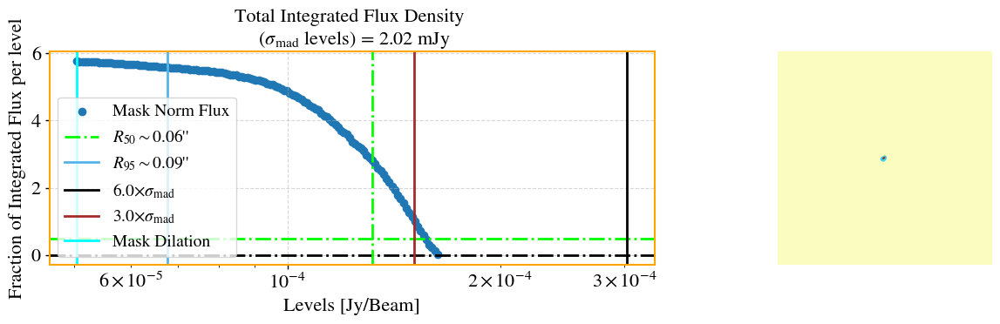

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...
224 896 672
2.111004122822376 3.431831258788849 4.918490759365935 4.918490759365935
Sum of fluxes =  0.00045337441580169417


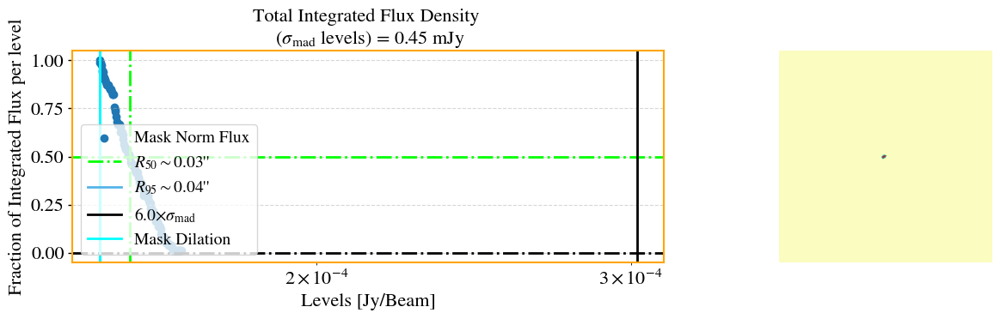

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc


D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


224 896 672
2.1850968611841584 3.5682482323055424 4.652426491681278 4.982787485166879


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:3505: RuntimeWarning: divide by zero encountered in divide
  ax1.scatter(levels[:], np.cumsum(fluxes) / results['total_flux_mask'],


Sum of fluxes =  0.00010006353844985532


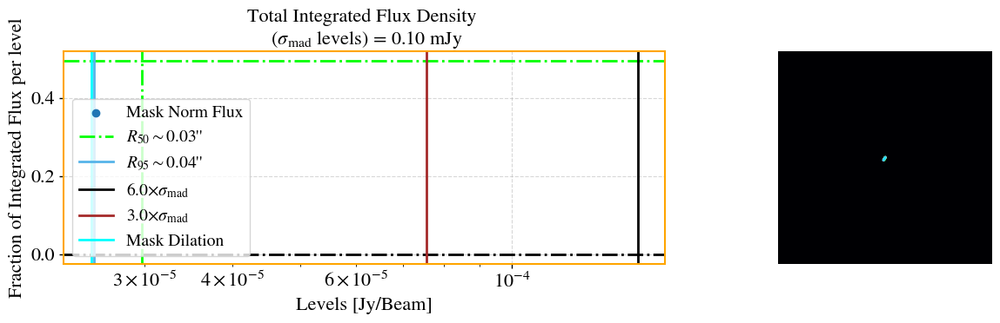

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...
Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.0-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.0-MFS-image.cutout_south.fits
rms res =  0.9997265523928766
rms data =  30.810001016106074 ; rms res =  30.801576095052752 ; ratio =  0.9997265523928766
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: divide by zero encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: invalid value encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)


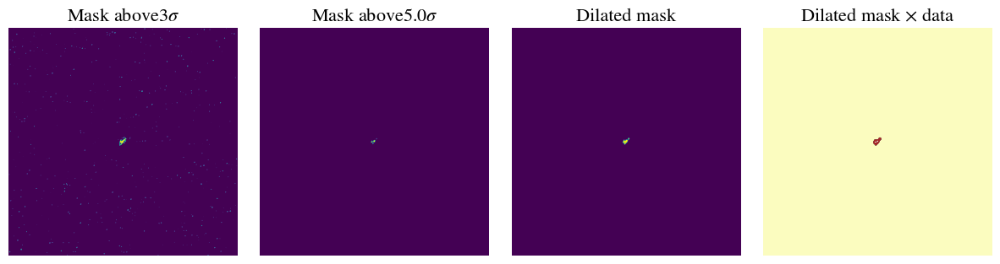

PSF BEAM SIZE is >=>  5
PSF SIZE is >=>  50
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 10:38:27	WARN	componentlist::close	componentlist closed
2023-09-25 11:38:27 - DEBUG - ---------------------------------------
2023-09-25 11:38:27 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 11:38:27 - DEBUG - ---------------------------------------
2023-09-25 11:38:27 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

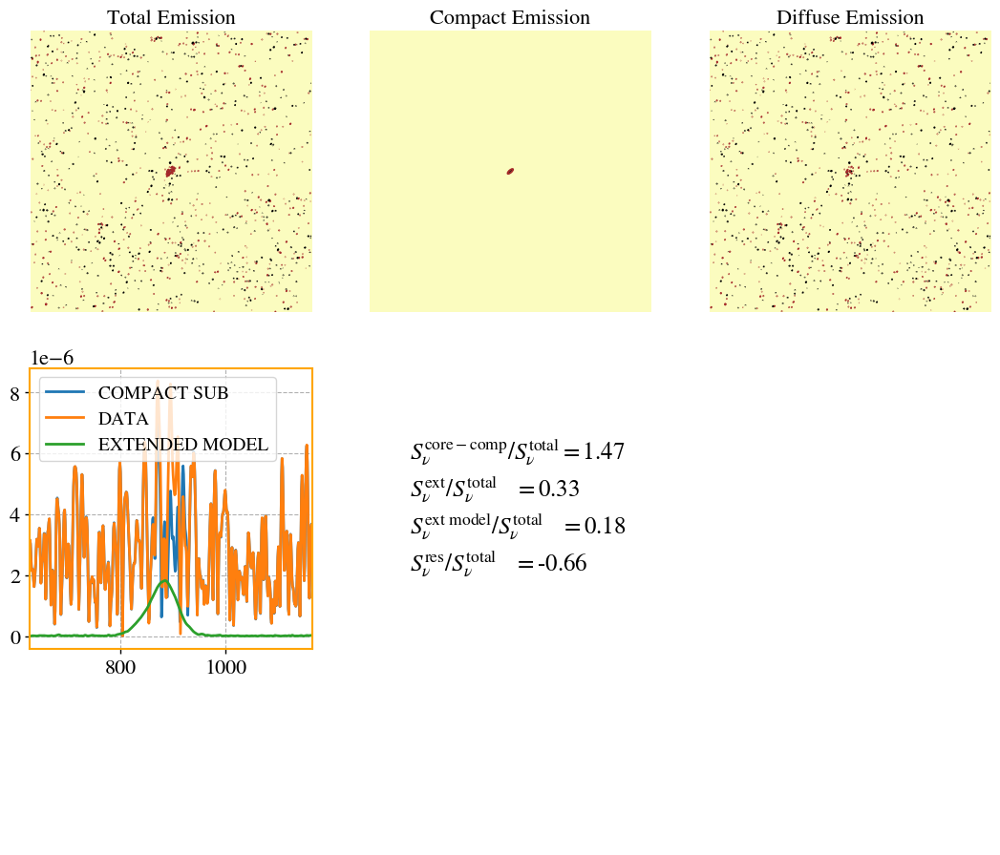

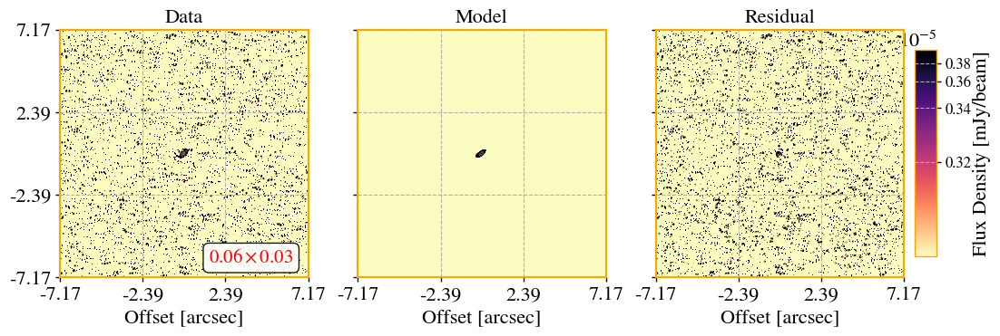

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


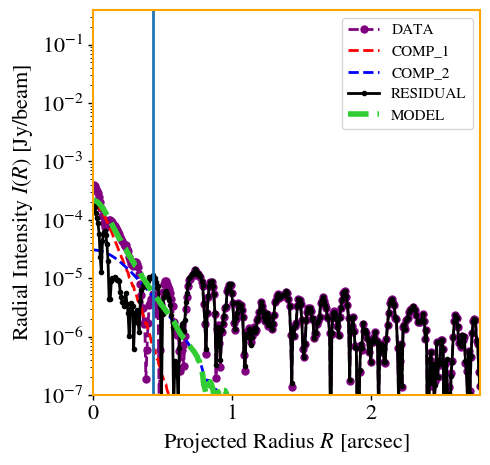

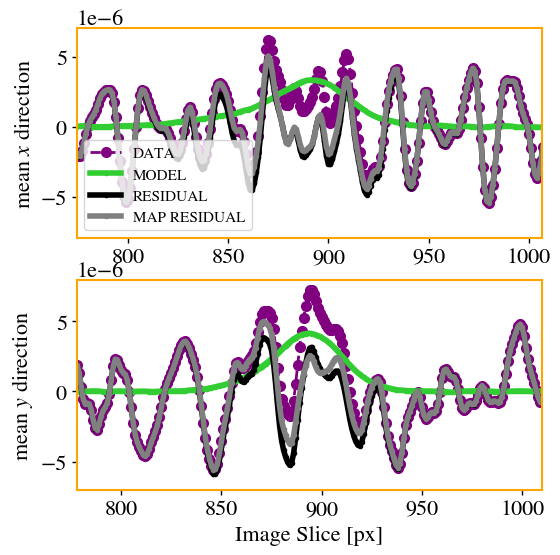

5.245936
Using rms provided...
224 896 672
5.753627391751592 9.91754782346883 13.564037533648712 15.254000354017007
Sum of fluxes =  0.003426992208925615


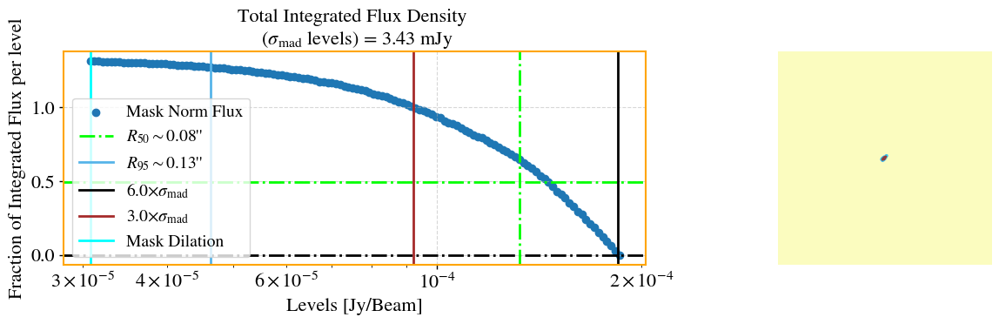

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...
224 896 672
5.077706251929807 8.500373177909337 11.311965976163641 12.360774464742066
Sum of fluxes =  0.0027113122285828267


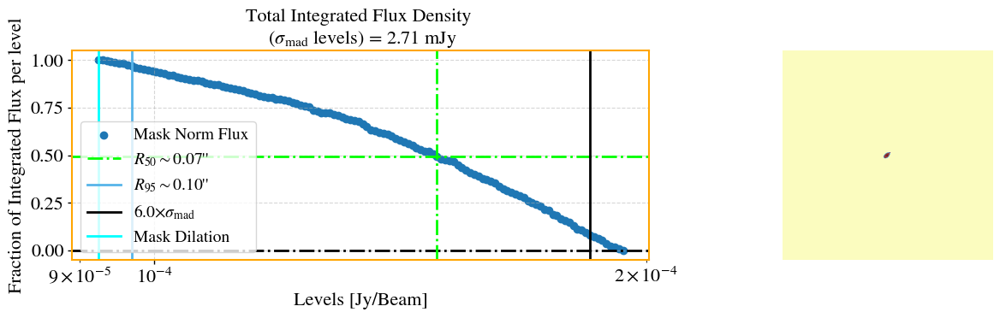

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc


D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in divide
  qmedian = np.nanmedian(BB / AA)
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:264: RuntimeWarning: invalid value encountered in divide
  qmi = np.nanmedian((BB / AA)[:rsplit])
/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:265: RuntimeWarning: invalid value encountered in divide
  qmo = np.nanmedian((BB / AA)[rsplit:])


6.651697090182843 11.026984017500345 14.57095378088162 15.827503922812443


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:3505: RuntimeWarning: divide by zero encountered in divide
  ax1.scatter(levels[:], np.cumsum(fluxes) / results['total_flux_mask'],


Sum of fluxes =  0.00096515169615519


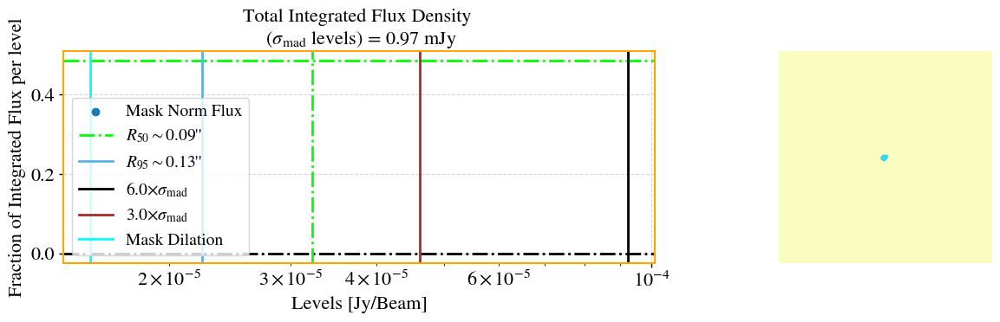

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...
Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.5-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.5-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.0.5-MFS-image.cutout_south.fits
rms res =  0.998919244353433
rms data =  24.206817749848923 ; rms res =  24.18065609488036 ; ratio =  0.998919244353433
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: divide by zero encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)
/home/sagauga/miniconda3/envs/morphen38/lib/python3.8/site-packages/astropy/visualization/mpl_normalize.py:180: RuntimeWarning: invalid value encountered in divide
  np.true_divide(values, self.vmax - self.vmin, out=values)


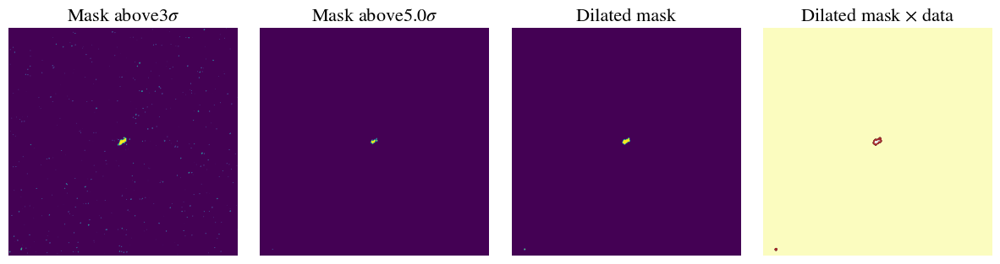

PSF BEAM SIZE is >=>  5
PSF SIZE is >=>  50
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 10:42:45	WARN	componentlist::close	componentlist closed
2023-09-25 11:42:45 - DEBUG - ---------------------------------------
2023-09-25 11:42:45 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 11:42:45 - DEBUG - ---------------------------------------
2023-09-25 11:42:45 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

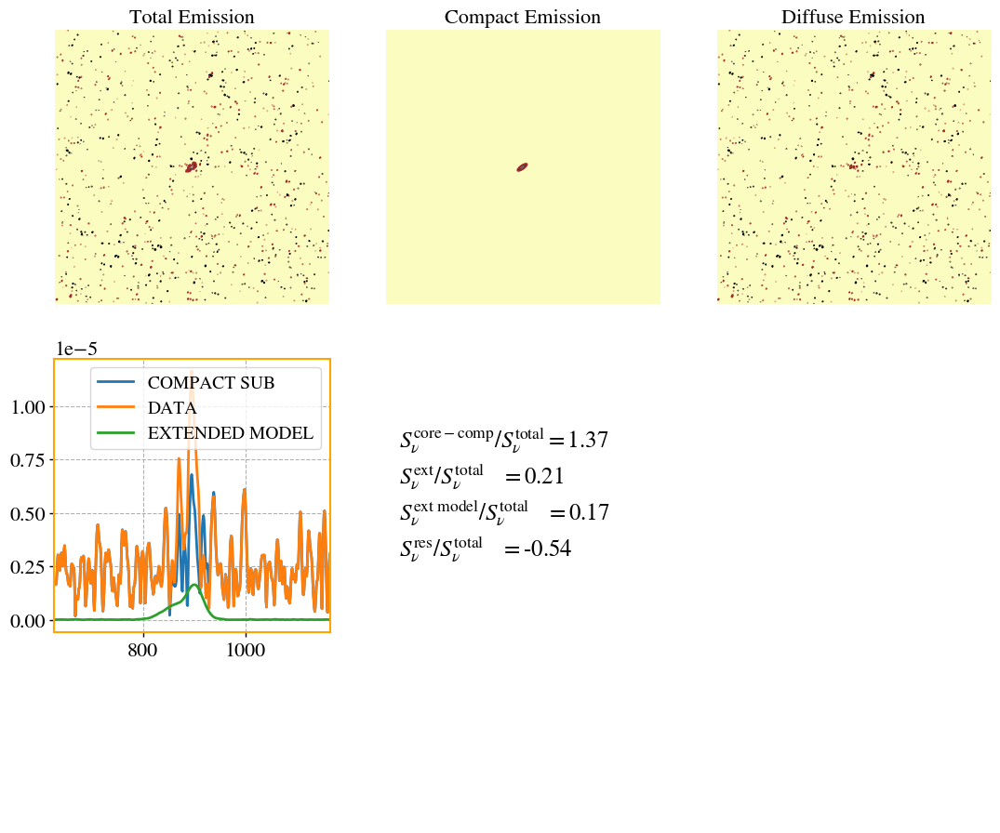

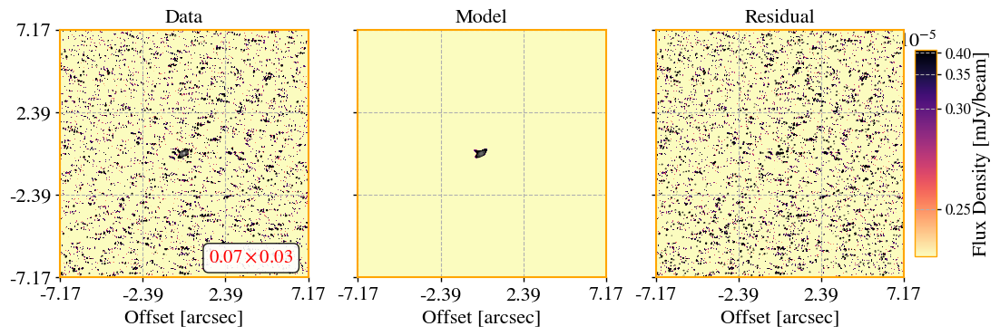

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


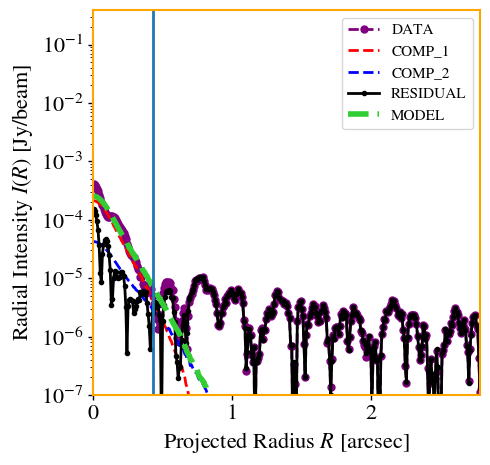

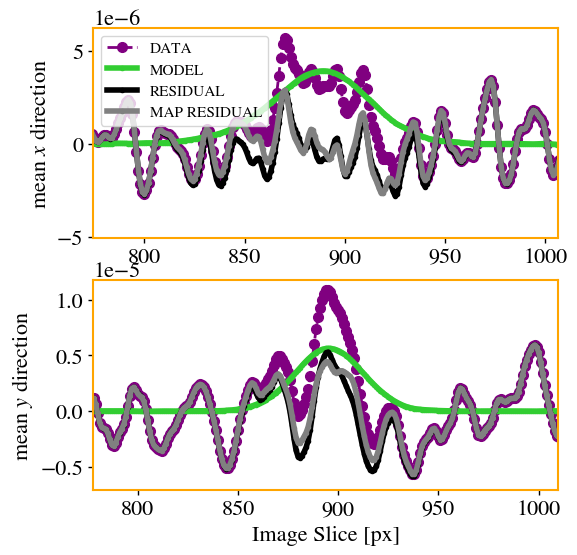

5.245936
Using rms provided...
224 896 672
7.918778161951929 13.171138446245484 18.44649745427224 20.583256751802555
Sum of fluxes =  0.00522545555307383


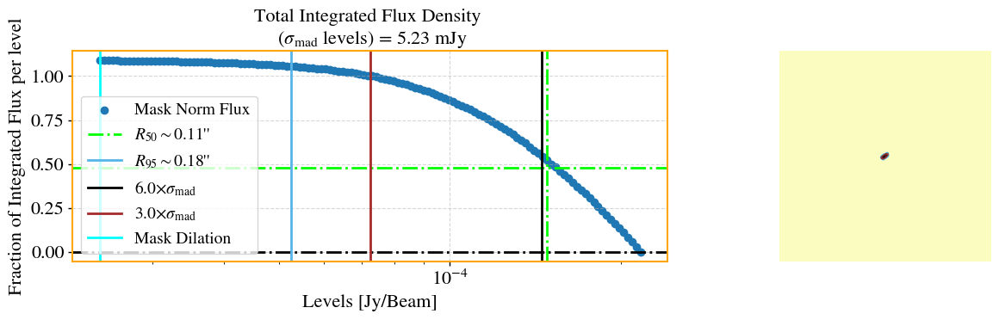

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...
224 896 672
7.442171739215616 12.640868754332628 17.214717657780774 19.015783725757565
Sum of fluxes =  0.004835303765960029


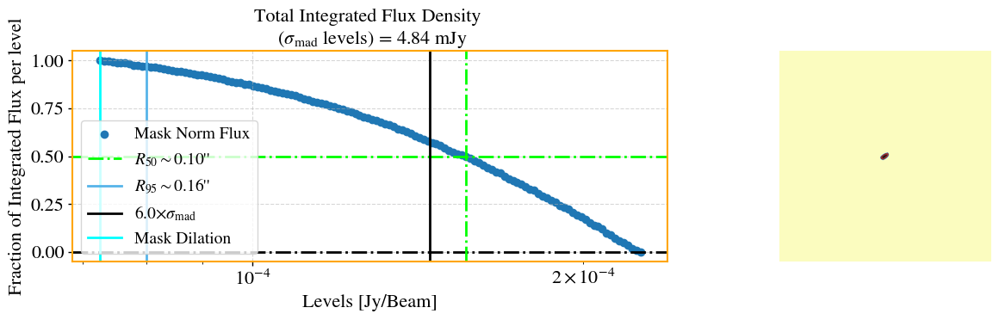

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
6.333012368467128 11.141851534268367 15.086138293858053 16.755575776860173
Sum of fluxes =  0.0009570267664799109


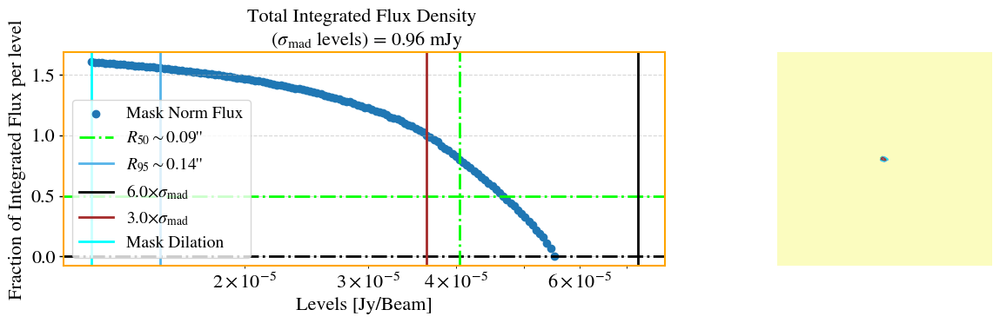

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
5.292567428401227 8.63044108762739 11.311965976163641 12.283276682185287
Sum of fluxes =  0.000663121249659857


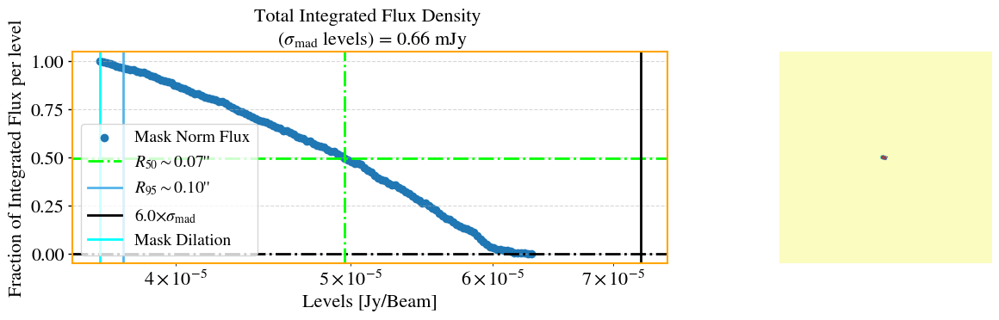

/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1983: RuntimeWarning: invalid value encountered in divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \
2023-09-25 11:59:00 - INFO - +--------------------------------+
2023-09-25 11:59:00 - INFO - | Core-Compact Component Sizes |
2023-09-25 11:59:00 - INFO - +--------------------------------+
2023-09-25 11:59:00 - INFO -  >=> Beam Size = 5.00 px
2023-09-25 11:59:00 - INFO -  >=> Beam Size = 25.64  pc
2023-09-25 11:59:00 - INFO -  >=> Rn Main Compact = 151.87  pc
2023-09-25 11:59:00 - INFO -  >=> C50 Compact Deconv Radii = 64.83  pc
2023-09-25 11:59:00 - INFO -  >=> C50 Compact Conv Radii = 67.55  pc
2023-09-25 11:59:00 - INFO -  >=> C95 Compact Deconv Radii = 103.04  pc
2023-09-25 11:59:00 - INFO -  >=> C95 Compact Conv Radii = 113.11  pc
2023-09-25 11:59:00 - INFO - +----------------------------+
2023-09-25 11:59:00 - INFO - | Extended Component Sizes |
2023-09-25 11:59:00 - INFO 

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.1.0-MFS-image.cutout_south.fits
rms res =  0.9969266298512375
rms data =  26.115159437877498 ; rms res =  26.03489788643095 ; ratio =  0.9969266298512375
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


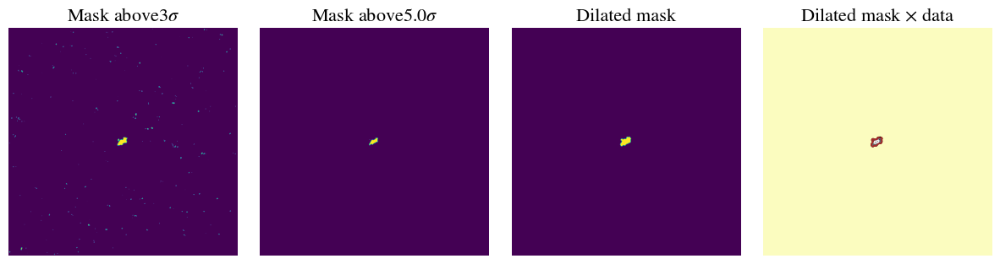

PSF BEAM SIZE is >=>  8
PSF SIZE is >=>  80
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 10:59:09	WARN	componentlist::close	componentlist closed
2023-09-25 11:59:09 - DEBUG - ---------------------------------------
2023-09-25 11:59:09 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 11:59:09 - DEBUG - ---------------------------------------
2023-09-25 11:59:09 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

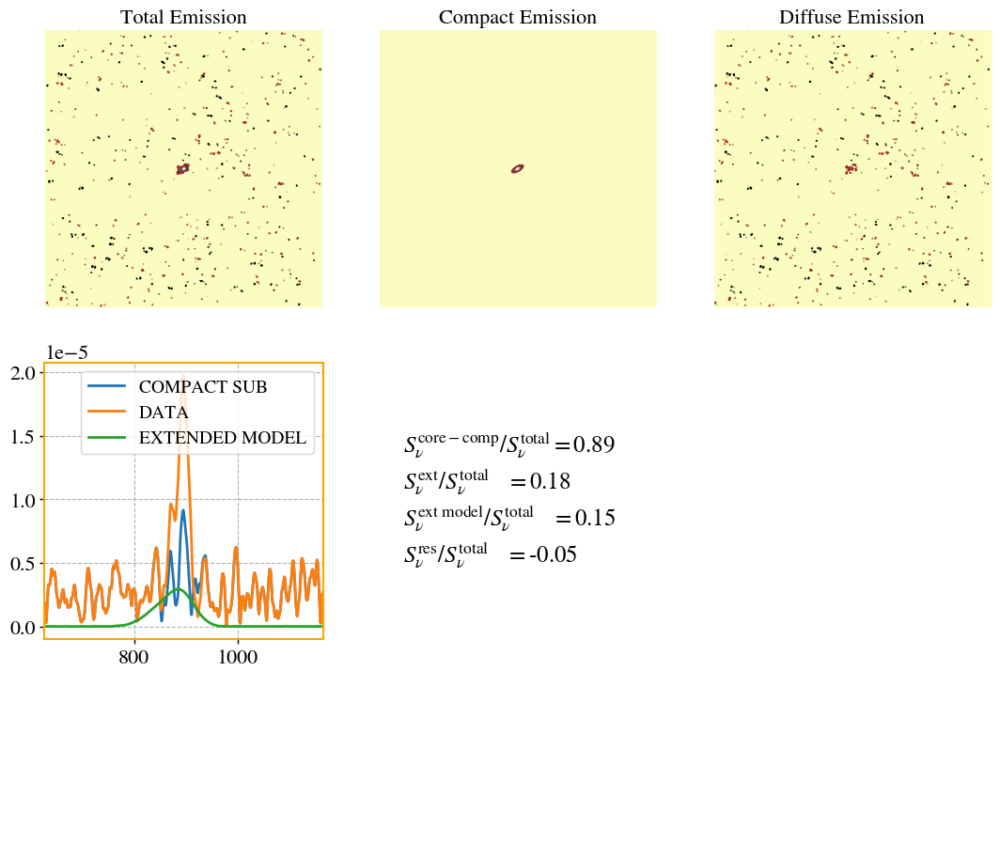

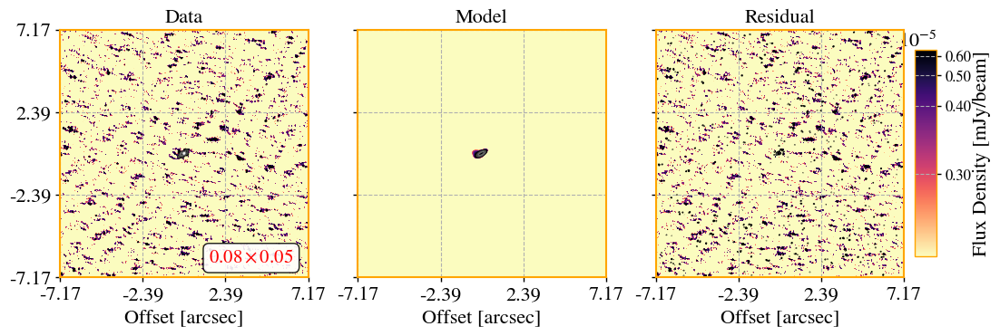

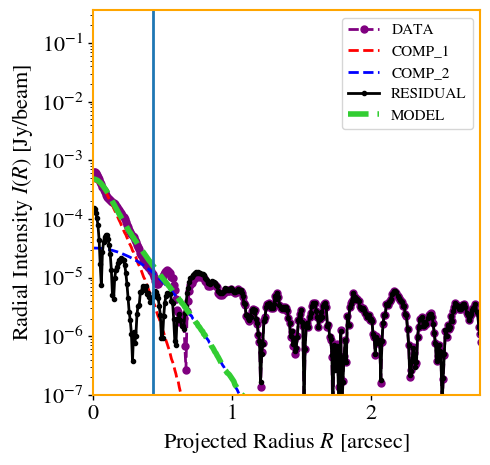

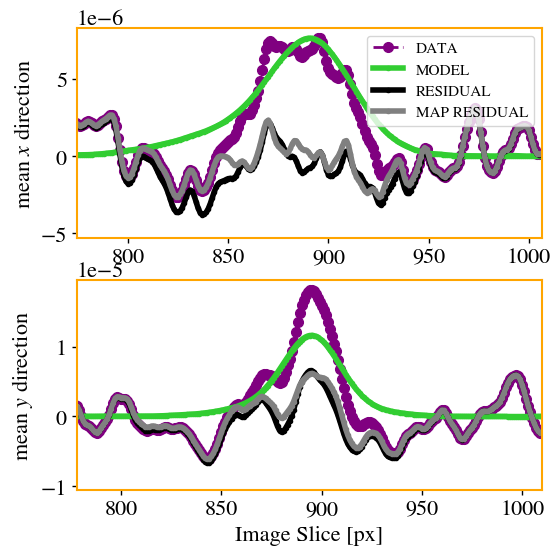

5.245936
Using rms provided...
224 896 672
8.77673016883152 15.285269263539401 22.362129397593943 26.184718727530473
Sum of fluxes =  0.006467122865329912


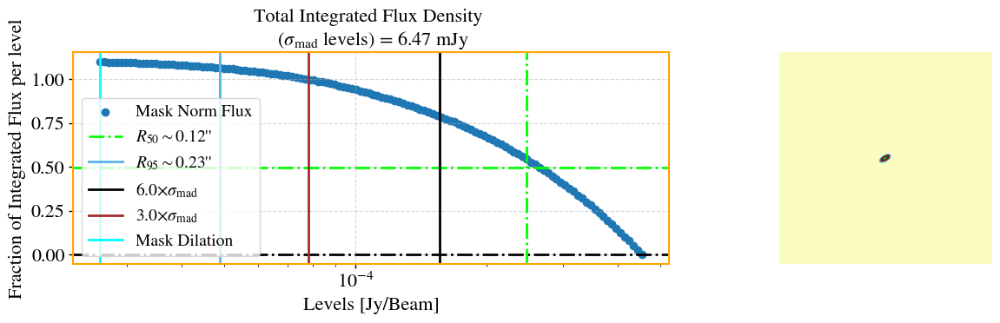

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


224 896 672
8.03846421247924 13.945871807036522 20.074369626682653 22.827029672799423
Sum of fluxes =  0.00598257388921367


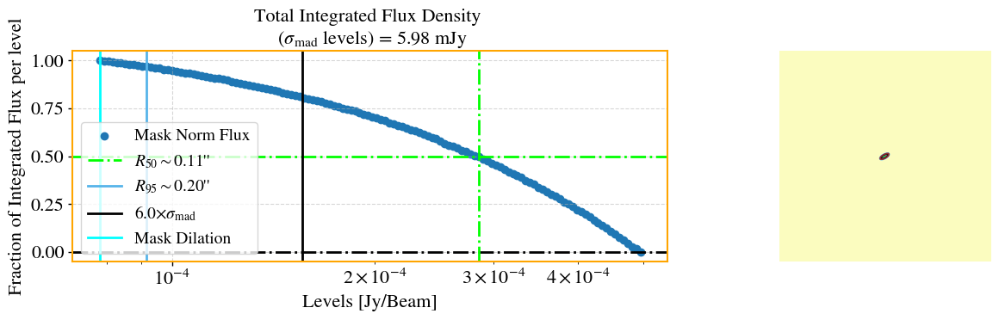

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
10.734438914006276 17.371176474327626 23.500375582719457 25.866723425249052
Sum of fluxes =  0.001153143896997816


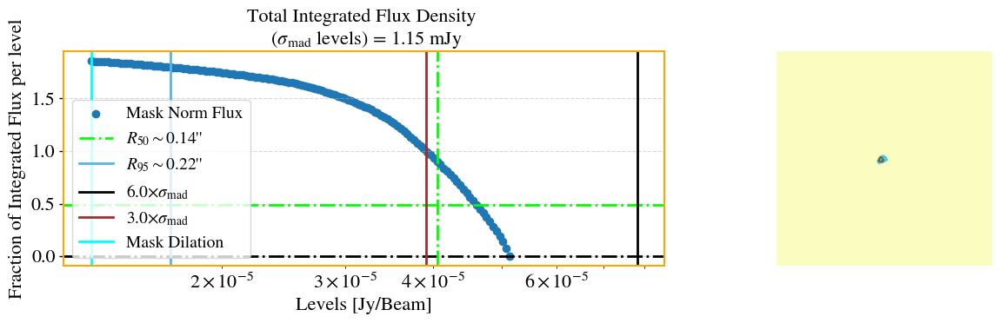

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
5.245936
Using rms provided...


/media/sagauga/xfs_evo/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:4059: RuntimeWarning: divide by zero encountered in divide
  y0peak, x0peak = nd.maximum_position((image / rr2))


224 896 672
7.715176518808164 12.590406002966217 16.39065416446578 17.5625248672306
Sum of fluxes =  0.0006441053192583262


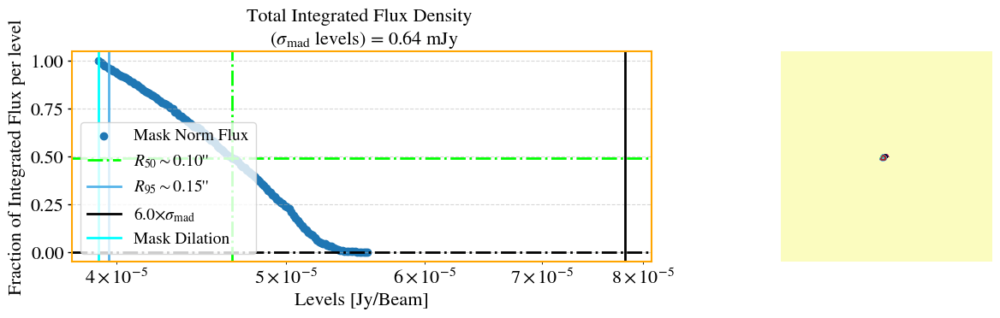

2023-09-25 12:04:39 - INFO - +--------------------------------+
2023-09-25 12:04:39 - INFO - | Core-Compact Component Sizes |
2023-09-25 12:04:39 - INFO - +--------------------------------+
2023-09-25 12:04:39 - INFO -  >=> Beam Size = 8.00 px
2023-09-25 12:04:39 - INFO -  >=> Beam Size = 41.03  pc
2023-09-25 12:04:39 - INFO -  >=> Rn Main Compact = 128.79  pc
2023-09-25 12:04:39 - INFO -  >=> C50 Compact Deconv Radii = 71.53  pc
2023-09-25 12:04:39 - INFO -  >=> C50 Compact Conv Radii = 78.40  pc
2023-09-25 12:04:39 - INFO -  >=> C95 Compact Deconv Radii = 126.37  pc
2023-09-25 12:04:39 - INFO -  >=> C95 Compact Conv Radii = 148.57  pc
2023-09-25 12:04:39 - INFO - +----------------------------+
2023-09-25 12:04:39 - INFO - | Extended Component Sizes |
2023-09-25 12:04:39 - INFO - +----------------------------+
2023-09-25 12:04:39 - INFO -  >=> C50 Extended Deconv Radii = 64.58  pc
2023-09-25 12:04:39 - INFO -  >=> C50 Extended Conv Radii = 89.10  pc
2023-09-25 12:04:39 - INFO -  >=> C

D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  641.1165490202446 pc
D_a =  132.2397807654678 Mpc
Linear Distance =  5.128932392161905 pc
Image File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.2.0-MFS-image.cutout_south.fits
Residual File: clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.2.0-MFS-residual.cutout_south.fits
#######################
['2'] ['1' '2']
Fitting clean_image_VV250_eM.avg12s.selfcalibrated_p-ap-p-ap_13840x11048_0.008arcsec_25000.briggs.multiscale.taper_0.025asec.2.0-MFS-image.cutout_south.fits
rms res =  0.9903986838329244
rms data =  25.884005744116738 ; rms res =  25.635485221297074 ; ratio =  0.9903986838329244
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


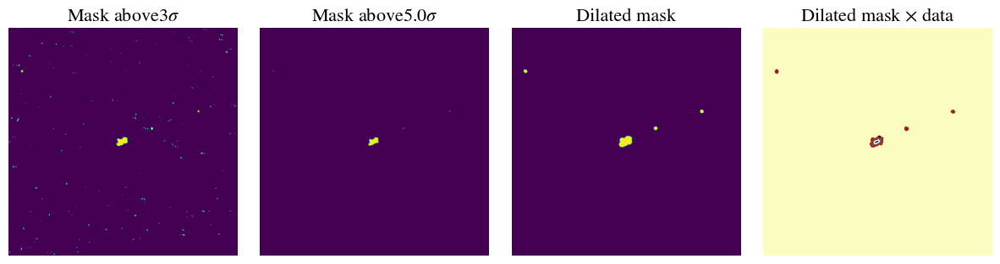

PSF BEAM SIZE is >=>  12
PSF SIZE is >=>  120
INFO: Using Elliptical Gaussian for Gaussian beam convolution.


2023-09-25 11:04:48	WARN	componentlist::close	componentlist closed
2023-09-25 12:04:48 - DEBUG - ---------------------------------------
2023-09-25 12:04:48 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-25 12:04:48 - DEBUG - ---------------------------------------
2023-09-25 12:04:48 - DEBUG -  ==> Using clean shuffled background for optmization... 


Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
{'f1_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f1_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f1_PA': {'value': 31.96485113520513, 'min': -58.03514886479487, 'max': 121.96485113520512}, 'f1_ell': {'value': 0.5346324483575098, 'min': 0.10692648967150196, 'max': 0.75}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.00011377418961315429, 'min': 1.137741896131543e-05, 'max': 0.011377418961315429}, 'f1_Rn': {'value': 26.742148429685937, 'min': 0.26742148429685936, 'max': 40.1132226445289}, 'f1_cg': {'value': 0.0, 'min': -0.01, 'max': 0.01}, 'f2_x0': {'value': 890.3842134210754, 'min': 860.3842134210754, 'max': 920.3842134210754}, 'f2_y0': {'value': 893.7421626880697, 'min': 863.7421626880697, 'max': 923.7421626880697}, 'f2_PA': {'value': 31.

In [31]:
results_fit = []
results_compact_conv_morpho = []
results_compact_deconv_morpho = []
results_ext_conv_morpho = []
results_ext_deconv_morpho = []

for idx in range(len(imagelist_eM)):
    try:
        input_data_idx=mp.read_data(filename=imagelist_eM[idx],
                                residualname=residuallist_eM[idx])
        smfr = mp.sersic_multifit_radio(input_data_idx, 
                                    SE, #source extraction object, from previous step
                                    comp_ids=['1'],# which component ID is compact?
                                    dr_fix=[30,30,150,150,150],#fix (x0,y0) positions
                                    aspect=None,z = z_d['VV250'],sigma=5.0)#elliptical or circular gaussian for beam convolution? 
        results_fit.append(smfr.results_fit)
        results_compact_conv_morpho.append(smfr.results_compact_conv_morpho)
        results_compact_deconv_morpho.append(smfr.results_compact_deconv_morpho)
        results_ext_conv_morpho.append(smfr.results_ext_conv_morpho)
        results_ext_deconv_morpho.append(smfr.results_ext_deconv_morpho)
    except:
        pass
    

Now, we can ispect the aggreded results and compute statistics., such as mean, std, etc. 

In [ ]:
_results_fit = pd.concat(results_fit, ignore_index=True)
_results_compact_conv_morpho = pd.concat(results_compact_conv_morpho, ignore_index=True)
_results_compact_deconv_morpho = pd.concat(results_compact_deconv_morpho, ignore_index=True)
_results_ext_conv_morpho = pd.concat(results_ext_conv_morpho, ignore_index=True)
_results_ext_deconv_morpho = pd.concat(results_ext_deconv_morpho, ignore_index=True)

In [ ]:
print(f"Redshift of VV705 = {z_d['VV705']}")
pix_to_pc = pixsize_to_pc(z=z_d['VV705'],
                          cell_size=get_cell_size(input_data.filename))

def print_stats(quantity,label):
    q_avg = np.nanmean(quantity)
    q_err = np.nanstd(quantity)
    q_min = np.nanmin(quantity)
    q_max = np.nanmax(quantity)
    print(label+' = ',q_avg,'+/-',q_err)
    print('min = ',q_min,', max = ',q_max)
    print('---------------------------------------')

In [ ]:
print_stats(_results_fit['f1_Rn']*pix_to_pc,'Rn Core-compact')

In [ ]:
print_stats(_results_fit['f2_Rn']*pix_to_pc,'Rn Nuclear-Extended')

In [ ]:
print_stats(_results_compact_deconv_morpho['C50radii']*pix_to_pc,'C50radii Deconv Core-Compact')

In [ ]:
print_stats(_results_compact_conv_morpho['C50radii']*pix_to_pc,'C50radii Conv Core-Compact')


In [ ]:
print_stats(_results_ext_deconv_morpho['C50radii']*pix_to_pc,'C50radii Deconv Nuclear-Extended')

In [ ]:
print_stats(_results_ext_conv_morpho['C50radii']*pix_to_pc,'C50radii Conv Nuclear-Extended')

In [ ]:
print_stats(_results_ext_deconv_morpho['C95radii']*pix_to_pc,'C95radii Deconv Nuclear-Extended')

In [ ]:
print_stats(_results_ext_conv_morpho['C95radii']*pix_to_pc,'C95radii Conv Nuclear-Extended')

Second attempt: Add an extra component. 

In [ ]:
SE_5 = mp.source_extraction(input_data,ell_size_factor=2,sigma=12,deblend_nthresh=3,
                          ids_to_add=[1,2,3],
                          bwf=2,bhf=2,fwf = 10, fhf = 10,clean_param=0.5,
                          dry_run=False,show_petro_plots=False)

In [ ]:
smfr2 = mp.sersic_multifit_radio(input_data, SE_5, comp_ids=['1','2'],
                                dr_fix=[3,3,150,150,200],
                                fix_value_n=[0.5,0.5,0.5,0.5,0.5],
                                fix_n = [True,True,True,True,True])

## The nuclear region of UGC8696

In [11]:
root_path_eM = 'data_examples/vla_only/UGC8696_C/' #only with e-MERLIN images.
prefix_images = 'MFS_images/*MFS-image.cutout.fits'
imagelist_eM = glob.glob(root_path_eM+prefix_images)
imagelist_eM,residuallist_eM = \
    mlibs.sort_list_by_beam_size(imagelist=imagelist_eM,return_df = False)

100%|██████████| 1/1 [00:00<00:00, 76.59it/s]

0 >> clean_image_UGC08696_AL746_combined_avg4s_3072_0.006arcsec_10000.briggs.-multiscale..0.5-MFS-image.cutout.fits


Image File: clean_image_UGC08696_AL746_combined_avg4s_3072_0.006arcsec_10000.briggs.-multiscale..0.5-MFS-image.cutout.fits
Residual File: clean_image_UGC08696_AL746_combined_avg4s_3072_0.006arcsec_10000.briggs.-multiscale..0.5-MFS-residual.cutout.fits
  >> Center -->  [505 512   0   0]


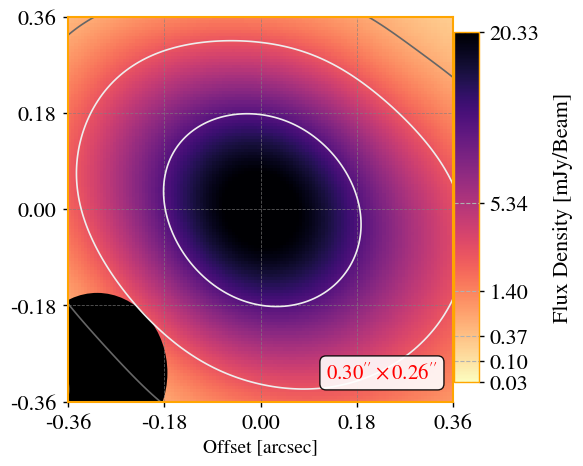

In [18]:
idx = 0
input_data=mp.read_data(filename=imagelist_eM[idx],
                        residualname=residuallist_eM[idx])

image_data = input_data.image_data_2D
residual_data = input_data.residual_data_2D


ax=mlibs.eimshow(input_data.filename,add_beam=True,crop=True,box_size=60,rms=mad_std(residual_data),
        vmin_factor=3.0,vmax_factor=0.9, #level factor (max from peak, and min from std)
        neg_levels=np.asarray([-3]), # negative contours to draw -- which negative std level?
        CM='magma_r',
       )

In [ ]:
analysis = mp.radio_image_analysis(input_data,z=z_d['VV705'],crop=True,box_size=100)

6.892962407916796
-2.9131248879821214e-07
2.2368431018549018e-05
object 0: flux = 0.034648 +/- 0.186140
object 1: flux = 0.018070 +/- 0.134426
object 2: flux = 0.052935 +/- 0.230077
object 3: flux = 0.009665 +/- 0.098309


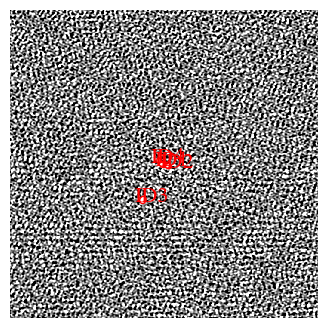

In [81]:
bwf, bhf = 1, 1
fwf, fhf = 3, 3
clean_param = 0.1
deblend_cont = 1e-7
deblend_nthresh = 10
sigma = 5
# ell_size_factor = 2.5
ell_size_factor = 3
SE = mp.source_extraction(input_data, 
                          ell_size_factor = ell_size_factor, sigma = sigma,
                          bwf = bwf,bhf = bhf,fwf = fwf, fhf = fhf,
                          clean_param = clean_param, 
                          deblend_cont = deblend_cont, 
                          deblend_nthresh=deblend_nthresh,
                          apply_mask=False,sigma_mask=6,
                          show_petro_plots=True,
                          dry_run=True)

In [82]:
%matplotlib inline

6.892962407916796
-2.9131248879821214e-07
2.2368431018549018e-05
object 0: flux = 0.034648 +/- 0.186140
object 1: flux = 0.018070 +/- 0.134426
object 2: flux = 0.052935 +/- 0.230077
object 3: flux = 0.009665 +/- 0.098309
D_a =  208.10272727853354 Mpc
Linear Distance =  6.053462955650503 pc
-2.9131248879821214e-07
2.2368431018549018e-05
object 0: flux = 0.034648 +/- 0.186140
object 1: flux = 0.018070 +/- 0.134426
object 2: flux = 0.052935 +/- 0.230077
object 3: flux = 0.009665 +/- 0.098309


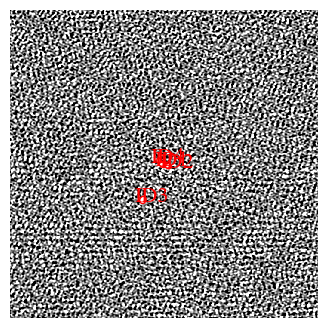

1


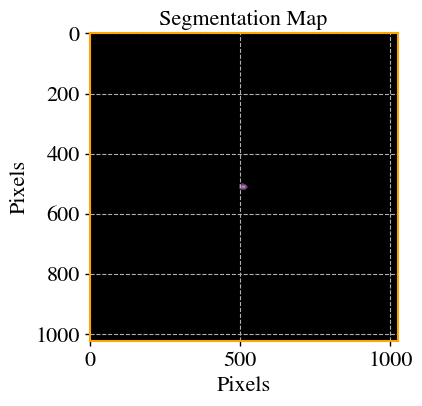

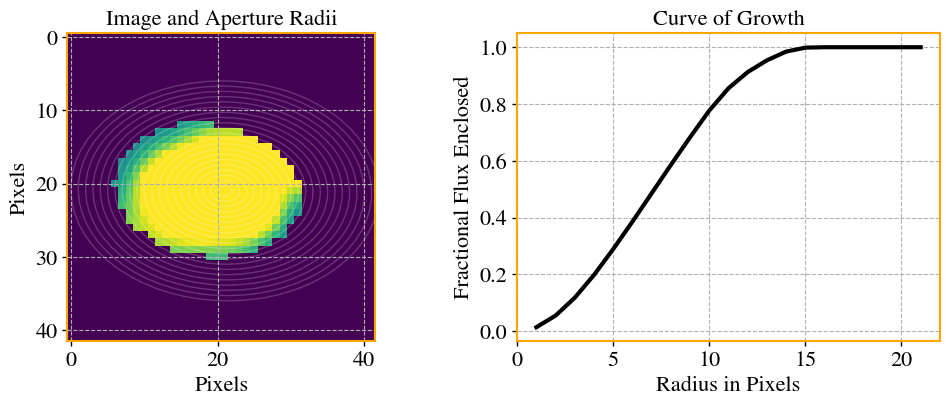

1


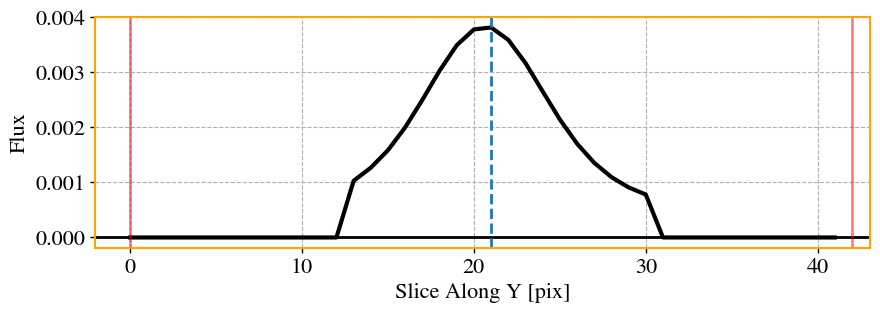

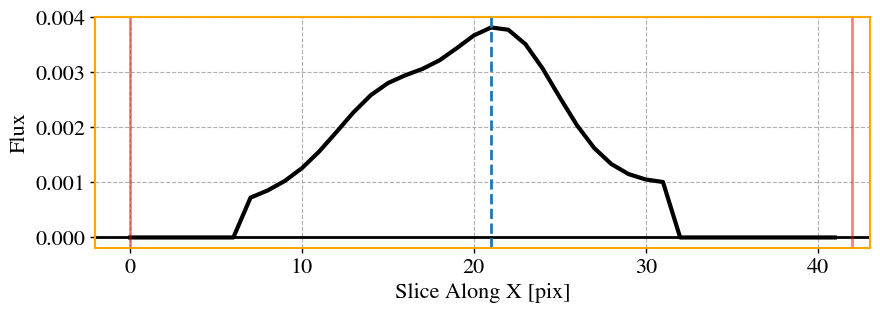

<Figure size 600x400 with 0 Axes>

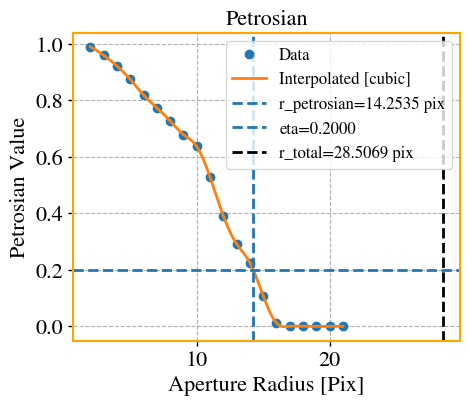

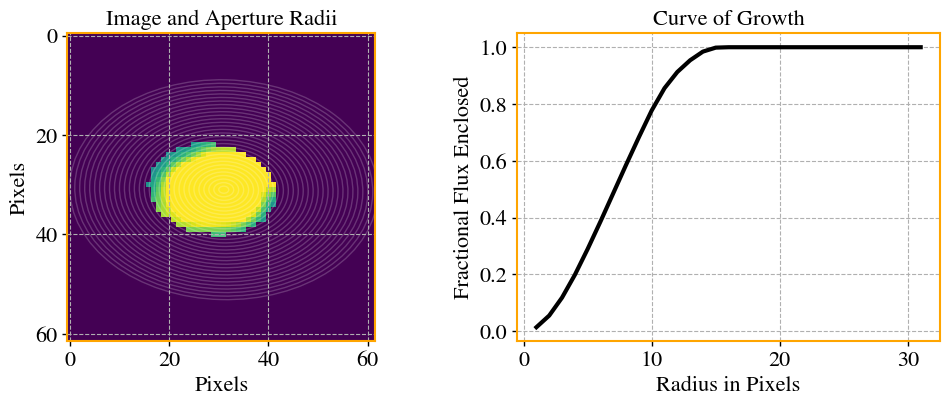

1


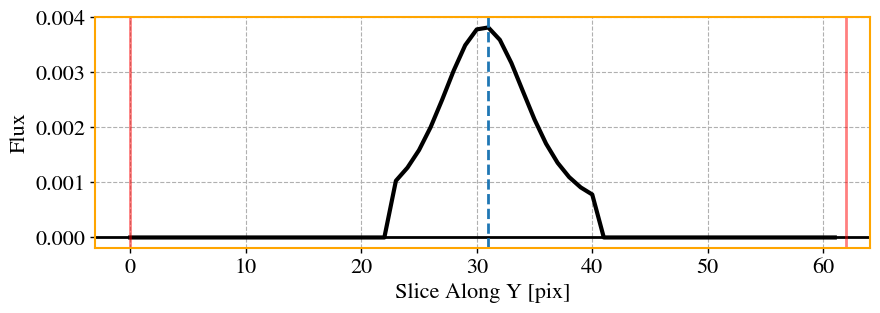

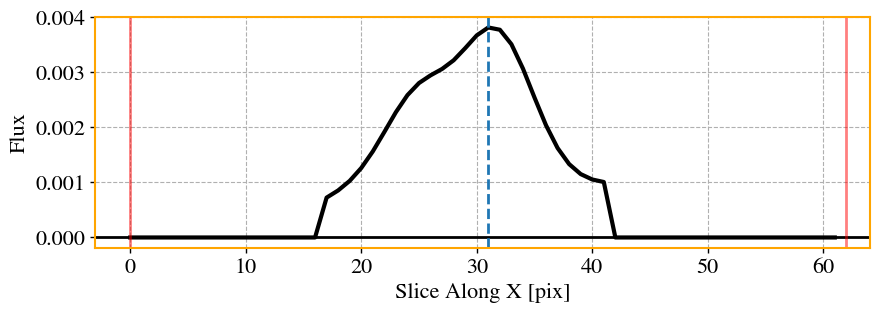

<Figure size 600x400 with 0 Axes>

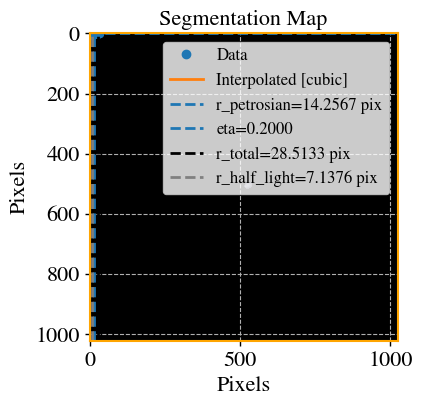

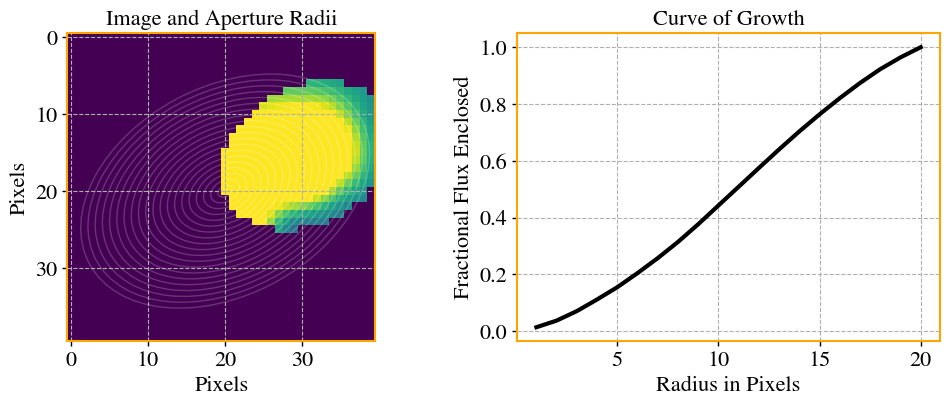

1


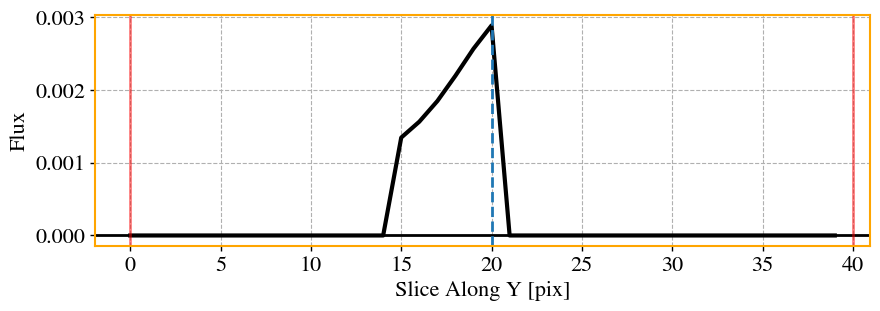

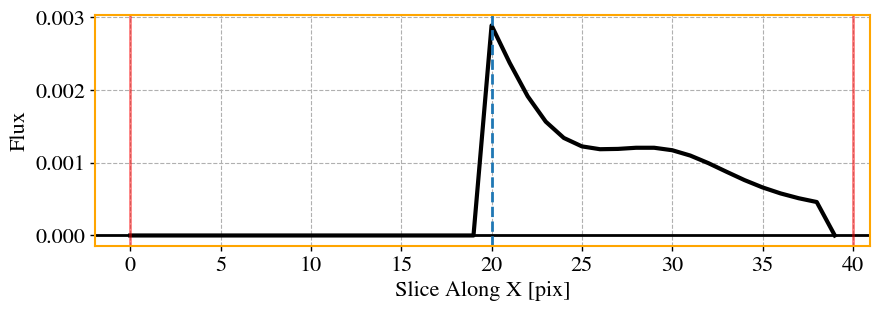

<Figure size 600x400 with 0 Axes>

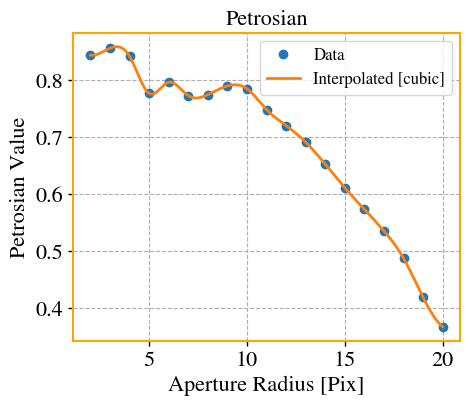

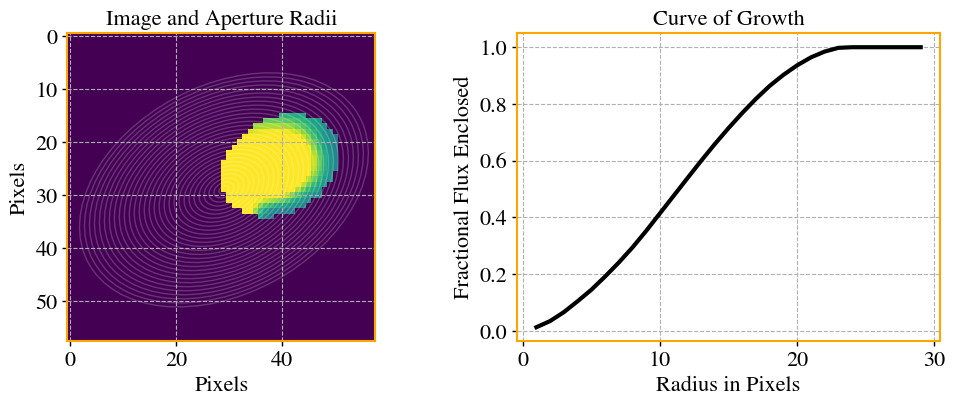

1


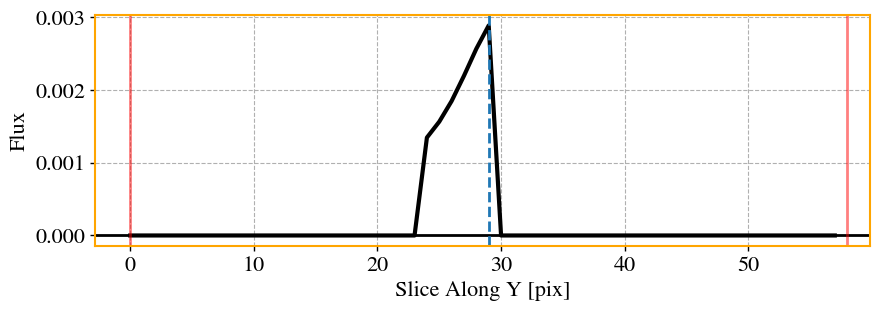

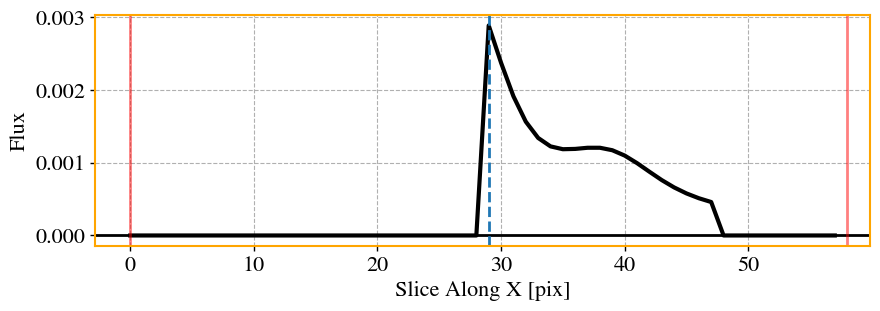

<Figure size 600x400 with 0 Axes>

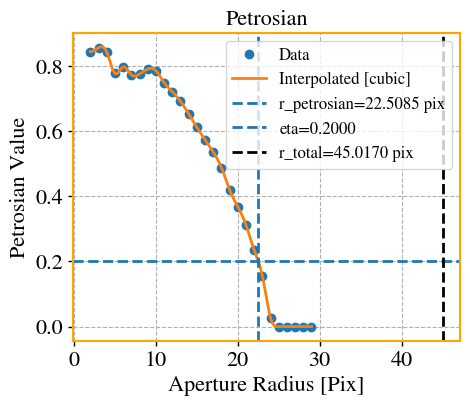

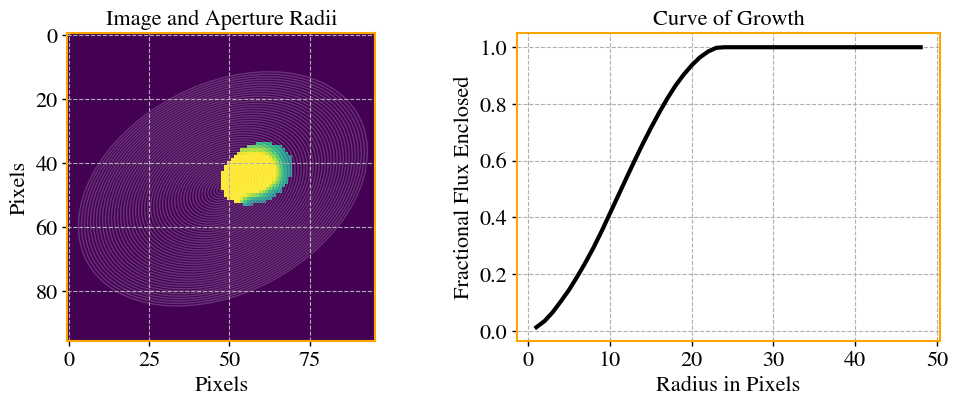

1


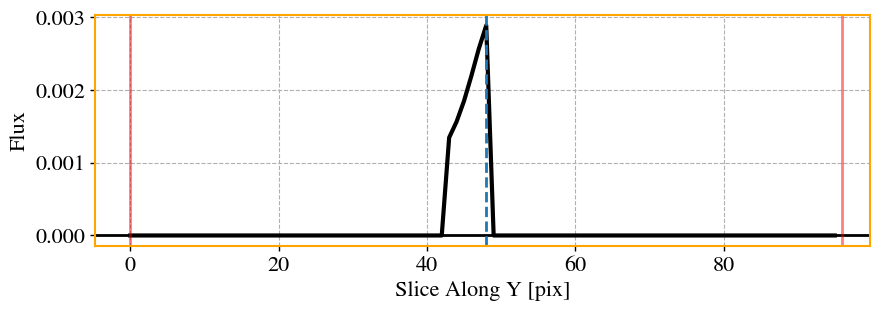

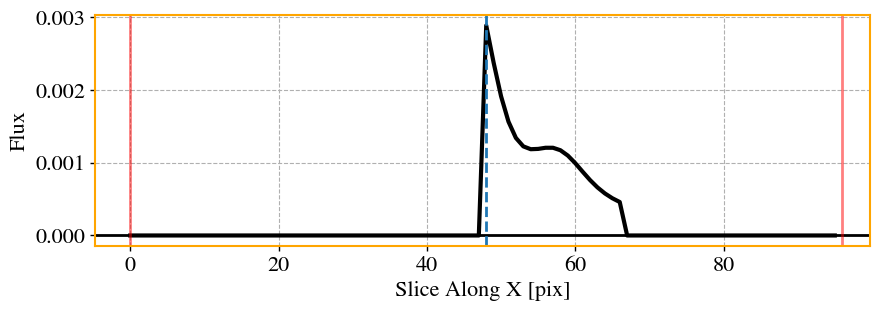

<Figure size 600x400 with 0 Axes>

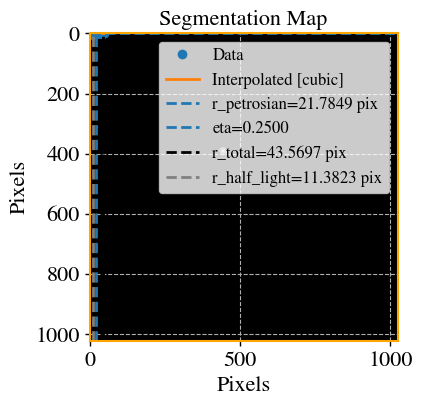

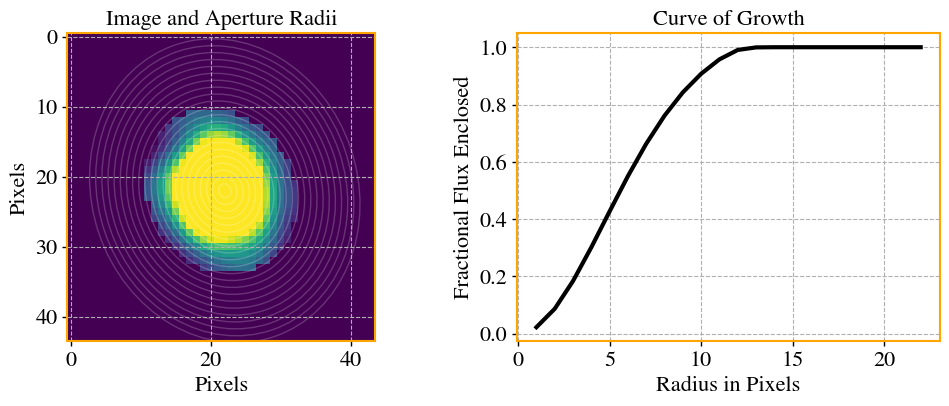

1


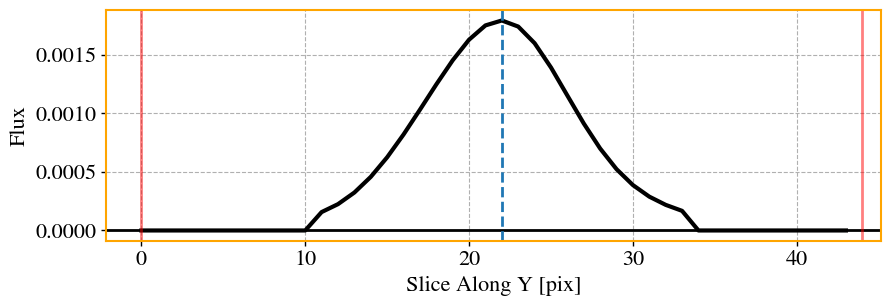

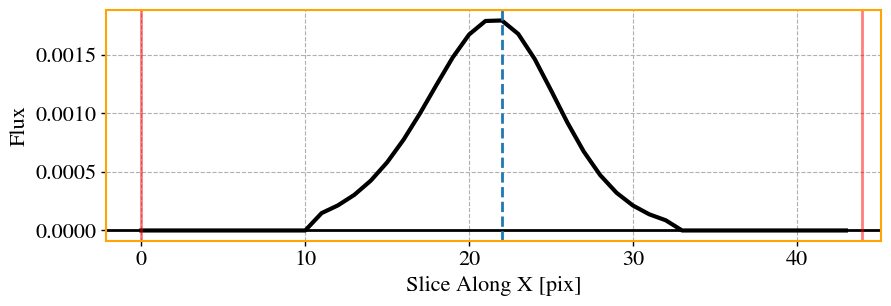

<Figure size 600x400 with 0 Axes>

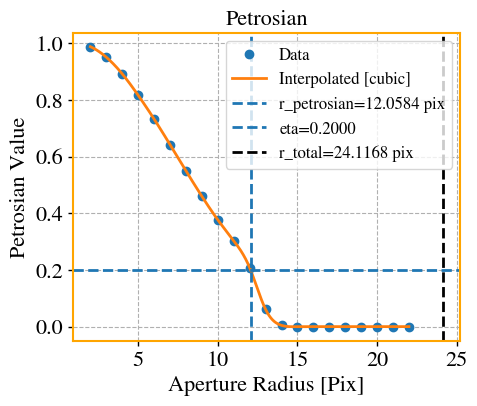

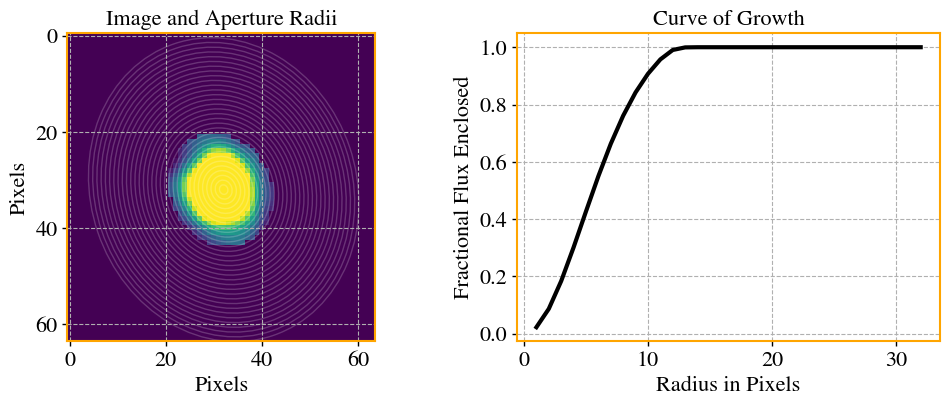

1


/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1980: RuntimeWarning: invalid value encountered in true_divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


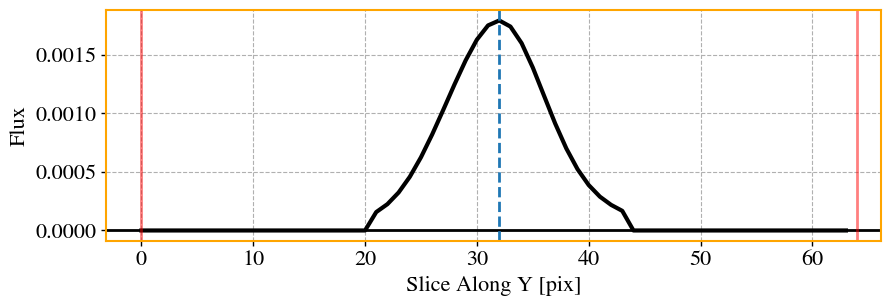

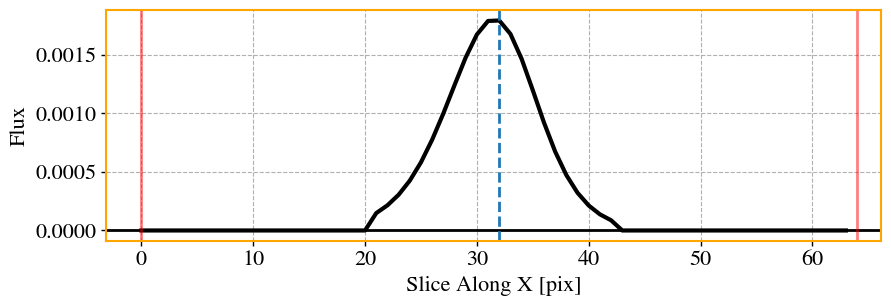

<Figure size 600x400 with 0 Axes>

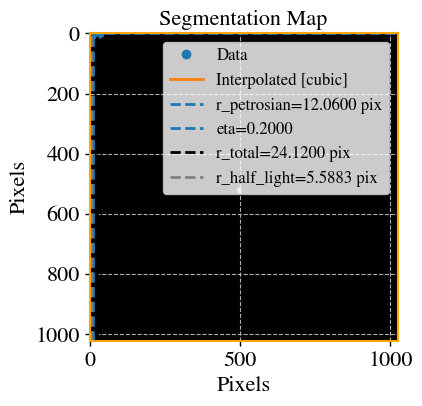

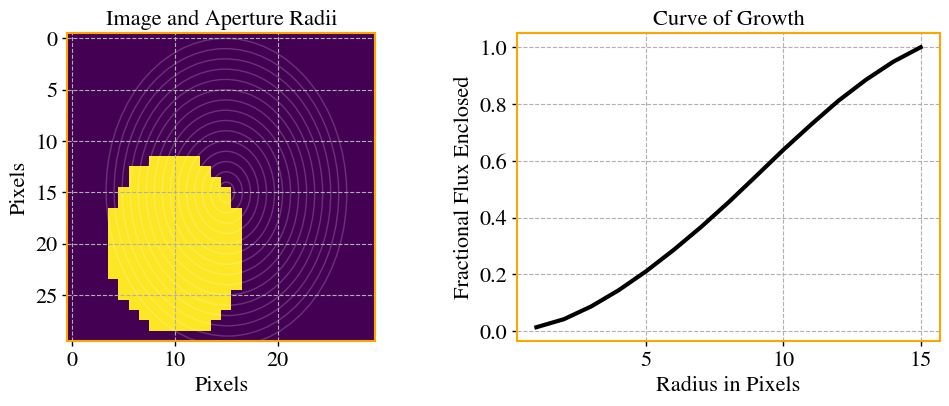

1


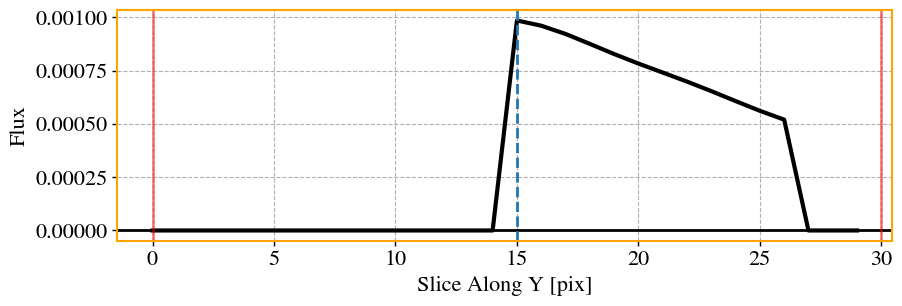

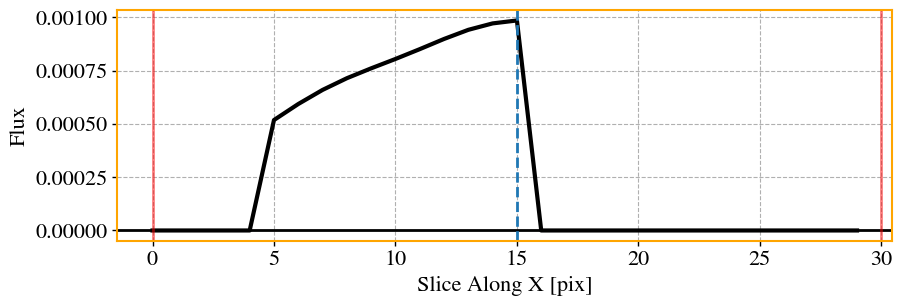

<Figure size 600x400 with 0 Axes>

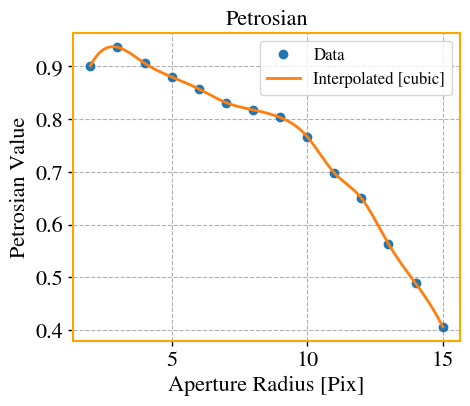

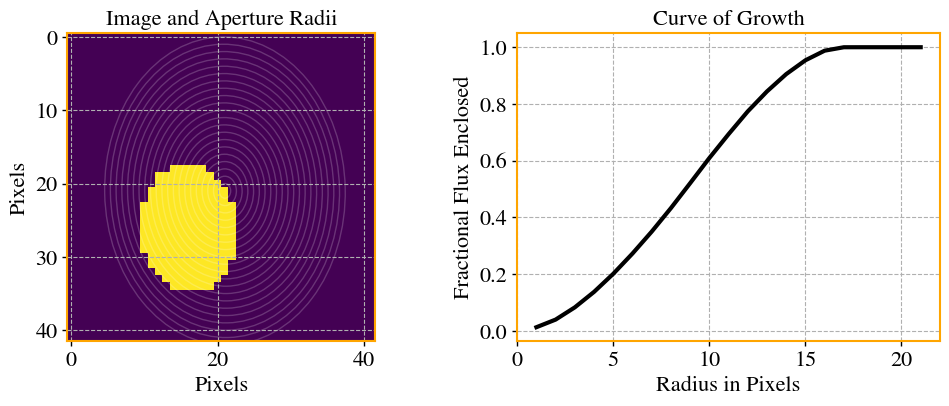

1


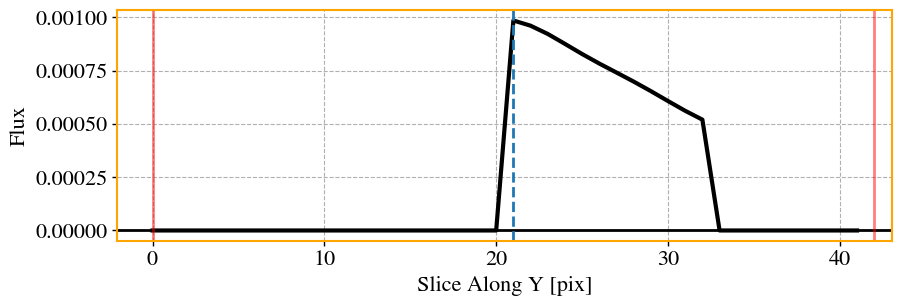

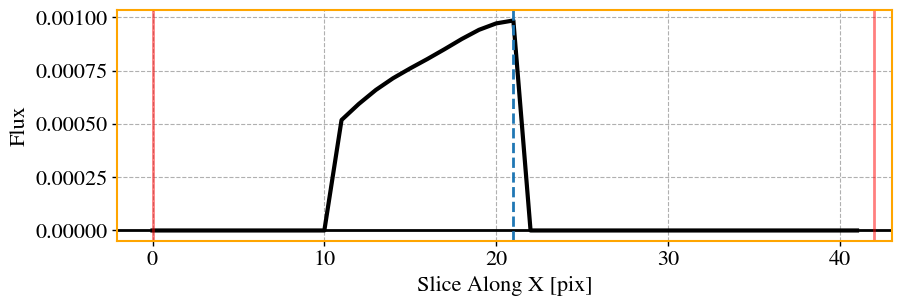

<Figure size 600x400 with 0 Axes>

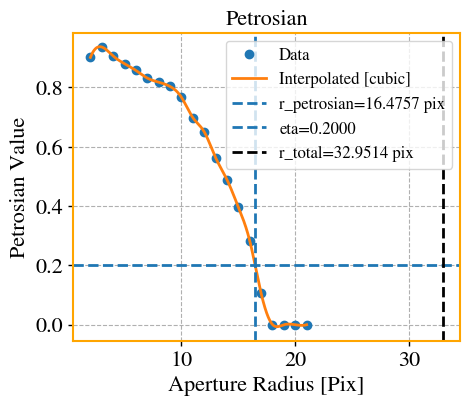

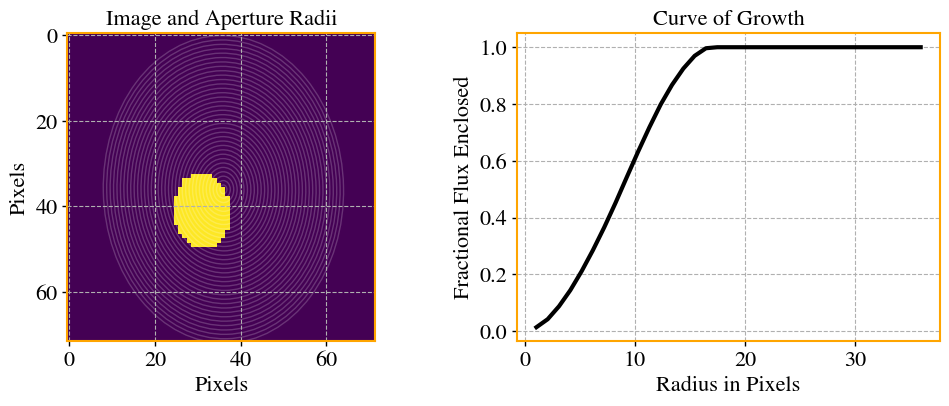

/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/libs.py:1980: RuntimeWarning: invalid value encountered in true_divide
  radial_prof = np.histogram(r, bins, weights=(image * weights * mask))[0] / \


PSF SIZE is 1024
INFO: Using Elliptical Gaussian for Gaussian beam convolution.
# of components to be fitted = 4
# of model components to be fitted = 5


2023-09-11 01:38:44	WARN	componentlist::close	componentlist closed


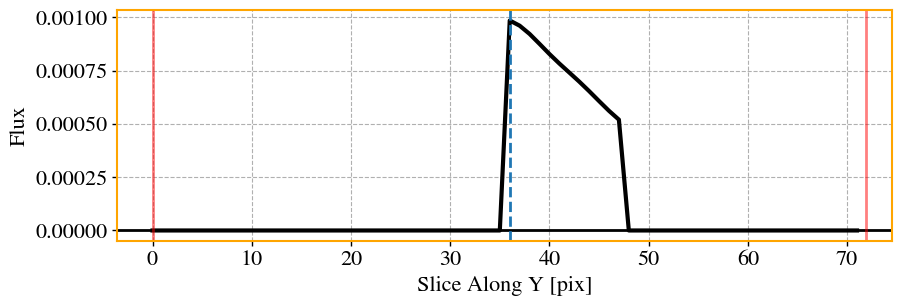

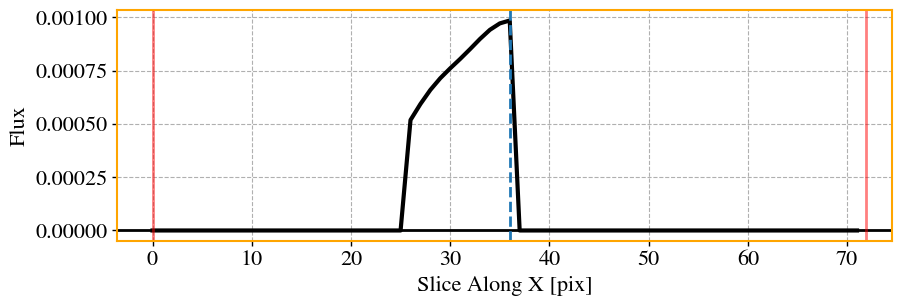

<Figure size 600x400 with 0 Axes>

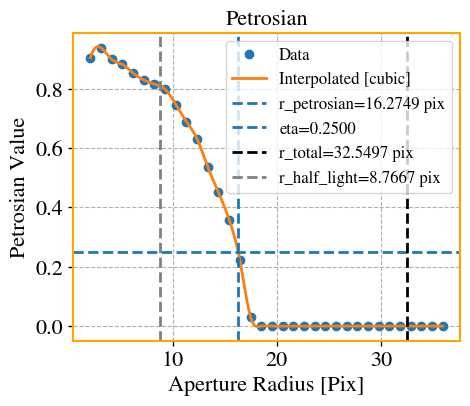

In [83]:
SE = mp.source_extraction(input_data, ids_to_add=[1],
                          ell_size_factor = ell_size_factor, sigma=sigma,
                          bwf=bwf, bhf=bhf, fwf=fwf, fhf=fhf,
                          clean_param=clean_param, 
                          deblend_cont=deblend_cont, 
                          deblend_nthresh=deblend_nthresh,
                          apply_mask=False,sigma_mask=6,
                          show_petro_plots=True,
                          dry_run=False)

In [88]:
idx = 1
input_data2=mp.read_data(filename=imagelist_eM[idx],
                        residualname=residuallist_eM[idx])

Image File: clean_image_UGC8696_1344_5553_emerlin_combined_selfcalibrated_3072_0.006arcsec_50000.briggs.-multiscale.taper_0.025asec.0.0-MFS-image.cutout.fits
Residual File: clean_image_UGC8696_1344_5553_emerlin_combined_selfcalibrated_3072_0.006arcsec_50000.briggs.-multiscale.taper_0.025asec.0.0-MFS-residual.cutout.fits


#######################
['5'] ['1' '2' '3' '4' '5']
Fitting clean_image_UGC8696_1344_5553_emerlin_combined_selfcalibrated_3072_0.006arcsec_50000.briggs.-multiscale.taper_0.025asec.0.0-MFS-image.cutout.fits
rms res =  0.977284346463515
rms data =  16.066636354824304 ; rms res =  15.701672209891424 ; ratio =  0.977284346463515
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


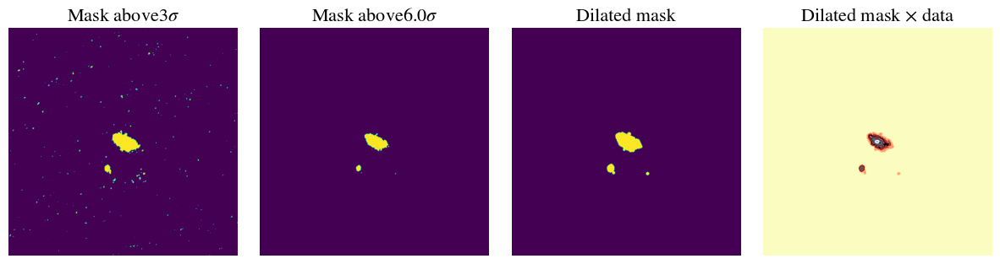

2023-09-11 01:43:49	WARN	componentlist::close	componentlist closed
2023-09-11 02:43:49 - DEBUG - ---------------------------------------
2023-09-11 02:43:49 - DEBUG -  <<< PERFORMING CONVOLUTION WITH GPU >>> 
2023-09-11 02:43:49 - DEBUG - ---------------------------------------
2023-09-11 02:43:49 - DEBUG -  ==> Using clean shuffled background for optmization... 


PSF BEAM SIZE is >=>  6
PSF SIZE is >=>  60
INFO: Using Elliptical Gaussian for Gaussian beam convolution.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 0  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 1  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 2  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 3  to 0.5.
Limiting  x0
Limiting  y0
Fixing Sersic Index of component 4  to 0.5.
{'f1_x0': {'value': 509.22584190241764, 'min': 506.22584190241764, 'max': 512.2258419024176}, 'f1_y0': {'value': 510.9686756400108, 'min': 507.9686756400108, 'max': 513.9686756400108}, 'f1_PA': {'value': 1.5284799230320554, 'min': -88.47152007696795, 'max': 91.52847992303205}, 'f1_ell': {'value': 0.2863347784469774, 'min': 0.057266955689395486, 'max': 0.5726695568939548}, 'f1_n': {'value': 0.5, 'min': 0.49, 'max': 0.51}, 'f1_In': {'value': 0.0014364385691199761, 'min': 0.00014364385691199762, 'max': 0.1436438569119976}, 'f1_Rn': {'value'

No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.
Flux on compact (self rms) =  16.325715454829822
Flux on compact (data rms) =  15.805764040989697
Flux on extended (self rms) =  28.34689923238706
Flux on extended (data rms) =  28.42473937736017
Flux on extended2 (data rms) =  28.534207137008156
Flux on extended model (data rms) =  27.27785479195904
Flux on data =  44.338325532667774
Flux on residual =  1.254706699719037


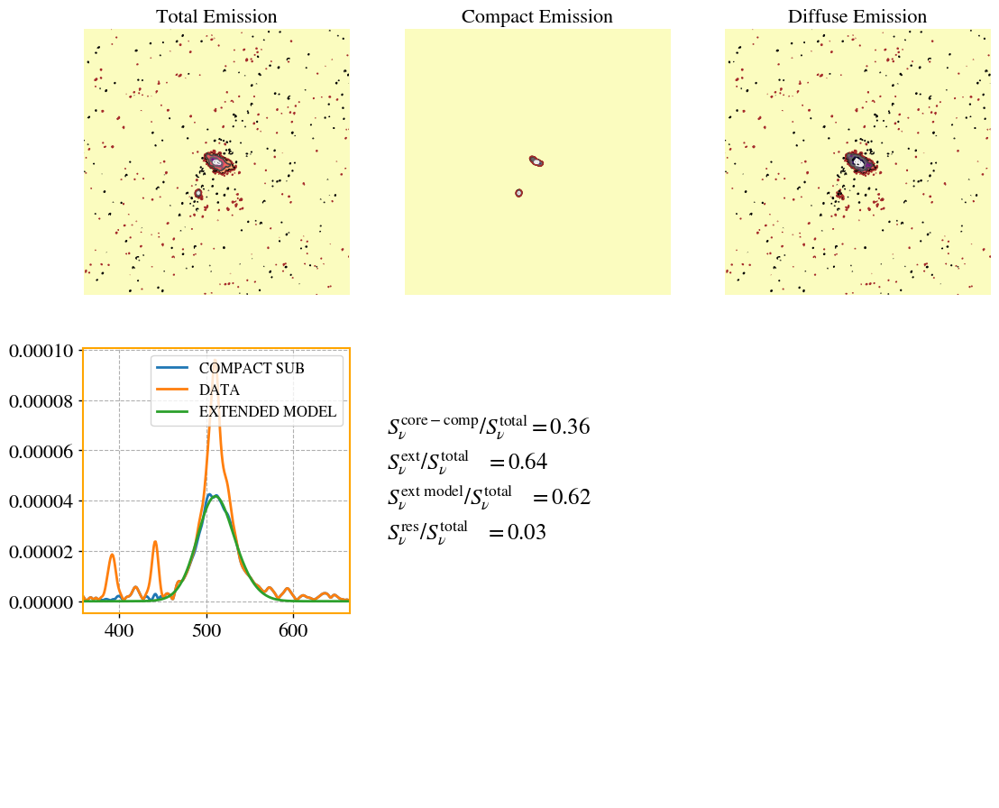

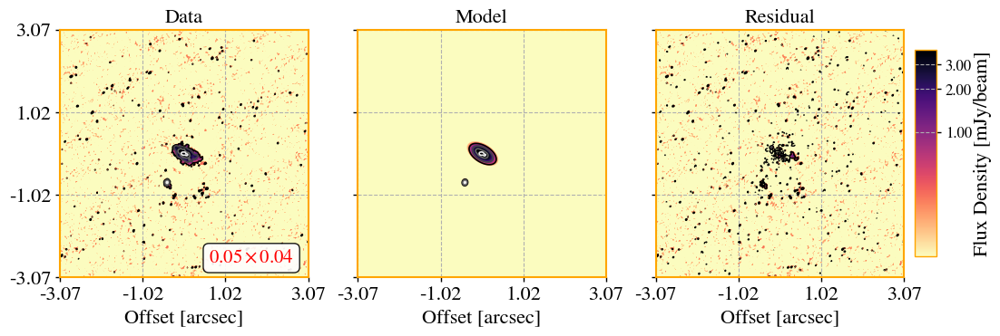

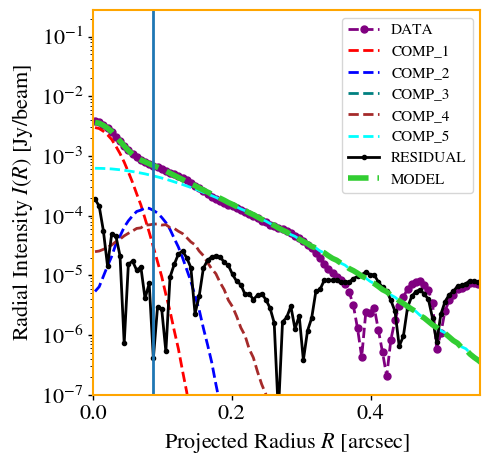

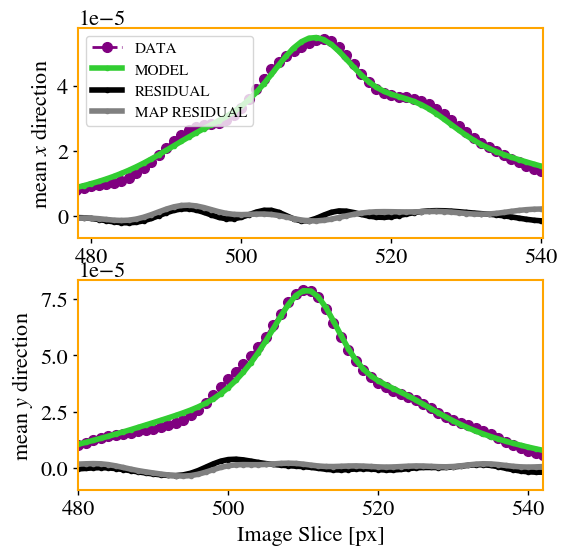

5.214656
Using rms provided...
128 512 384
4.753945931439391 9.18434101276213 14.99088988838742 18.255696394123913
Sum of fluxes =  0.015686668498700658


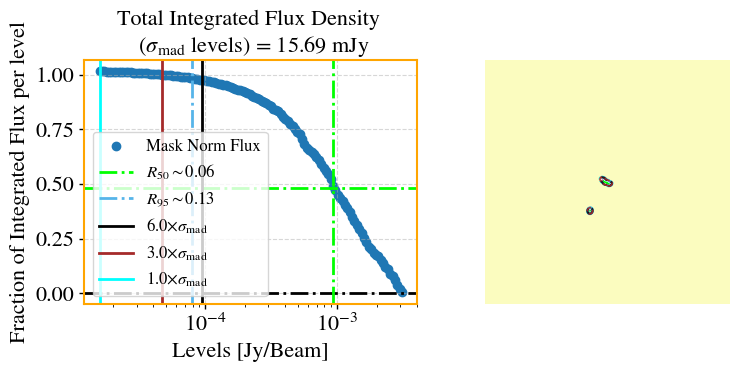

D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc
D_a =  157.7808937284992 Mpc
Linear Distance =  764.943358972662 pc
5.214656
Using rms provided...


128 512 384
non real ellipse


/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in true_divide
  qmedian = np.nanmedian(BB / AA)
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:264: RuntimeWarning: invalid value encountered in true_divide
  qmi = np.nanmedian((BB / AA)[:rsplit])
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:265: RuntimeWarning: invalid value encountered in true_divide
  qmo = np.nanmedian((BB / AA)[rsplit:])


3.2897623212397704 6.651697090182843 11.423968370726268 13.991446672986724
Sum of fluxes =  0.015574617619763042


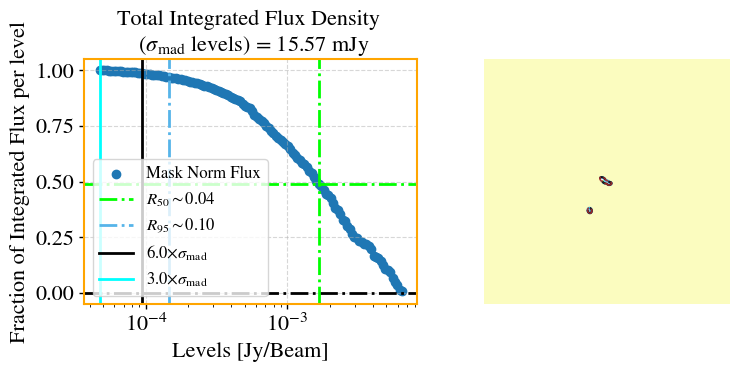

D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc
D_a =  157.7808937284992 Mpc
Linear Distance =  764.943358972662 pc
5.214656
Using rms provided...


128 512 384


/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:168: RuntimeWarning: Mean of empty slice.
  remove_indexes = np.where(np.logical_or(abs(y - y.mean()) >
/home/sagauga/miniconda3/envs/numba/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:169: RuntimeWarning: Mean of empty slice.
  abs(y - y.mean()).mean() * 1.5, \
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:170: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()) >
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:171: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()).mean() * 1.5) == True)[0]
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in tr

10.55502061411188 19.859152776030417 27.599194872999668 31.397543176356965
Sum of fluxes =  0.022686773542098478


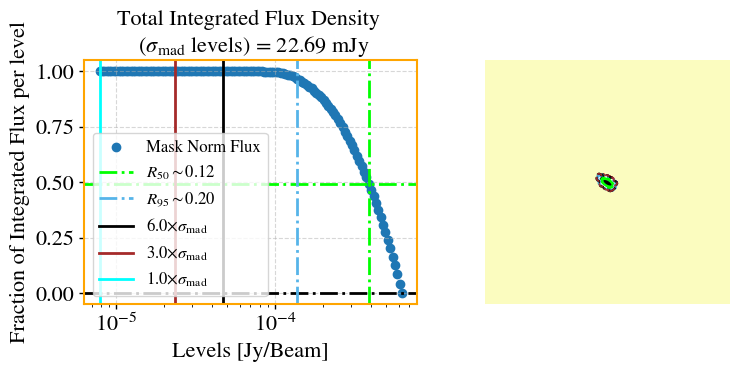

D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc
D_a =  157.7808937284992 Mpc
Linear Distance =  764.943358972662 pc
5.214656
Using rms provided...


128 512 384


/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:168: RuntimeWarning: Mean of empty slice.
  remove_indexes = np.where(np.logical_or(abs(y - y.mean()) >
/home/sagauga/miniconda3/envs/numba/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:169: RuntimeWarning: Mean of empty slice.
  abs(y - y.mean()).mean() * 1.5, \
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:170: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()) >
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:171: RuntimeWarning: Mean of empty slice.
  abs(x - x.mean()).mean() * 1.5) == True)[0]
/run/media/sagauga/ssd_3/cloud/pcloud-arch/PhD/GitHub/morphen/libs/fitEllipse2018.py:262: RuntimeWarning: invalid value encountered in tr

11.026984017500345 19.730509136937545 27.685559519911603 31.29599846286301
Sum of fluxes =  0.022935215807168736


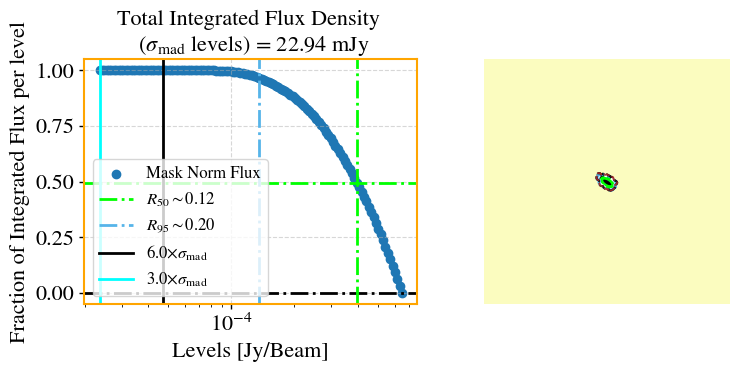

2023-09-11 02:45:08 - INFO - +--------------------------------+
2023-09-11 02:45:08 - INFO - | Core-Compact Component Sizes |
2023-09-11 02:45:08 - INFO - +--------------------------------+
2023-09-11 02:45:08 - INFO -  >=> Beam Size = 6.00 px
2023-09-11 02:45:08 - INFO -  >=> Beam Size = 27.54  pc
2023-09-11 02:45:08 - INFO -  >=> Rn Main Compact = 23.62  pc
2023-09-11 02:45:08 - INFO -  >=> C50 Compact Deconv Radii = 30.53  pc
2023-09-11 02:45:08 - INFO -  >=> C50 Compact Conv Radii = 42.15  pc
2023-09-11 02:45:08 - INFO -  >=> C95 Compact Deconv Radii = 75.76  pc
2023-09-11 02:45:08 - INFO -  >=> C95 Compact Conv Radii = 98.84  pc
2023-09-11 02:45:08 - INFO - +----------------------------+
2023-09-11 02:45:08 - INFO - | Extended Component Sizes |
2023-09-11 02:45:08 - INFO - +----------------------------+
2023-09-11 02:45:08 - INFO -  >=> C50 Extended Deconv Radii = 90.56  pc
2023-09-11 02:45:08 - INFO -  >=> C50 Extended Conv Radii = 91.15  pc
2023-09-11 02:45:08 - INFO -  >=> C95 

D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc
D_a =  157.7808937284992 Mpc
Linear Distance =  764.943358972662 pc
D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc


In [89]:
smfr = mp.sersic_multifit_radio(input_data2,
                                SE, #source extraction object, from previous step
                                which_residual = 'shuffled',
                                fix_geometry=True,
                                comp_ids=['1','2','3','4'],# which component ID is compact?
                                dr_fix=[3,3,3,3,150, 150],#fix (x0,y0) positions
                                aspect=None,z = z_d['UGC8696'])#elliptical or circular gaussian for beam convolution? 

In [93]:
SFR = mp.radio_star_formation(input_data,smfr,z=z_d['UGC8696'])

2023-09-11 02:46:56 - INFO - Using frequency of 5.21 GHz for star formation estimate.
2023-09-11 02:46:56 - INFO - +-----------------+
2023-09-11 02:46:56 - INFO - | SFR Estimates |
2023-09-11 02:46:56 - INFO - +-----------------+
2023-09-11 02:46:56 - INFO -  ==> SFR =168.35 +/- 7.74 Mo/yr
2023-09-11 02:46:56 - INFO - +------------------+
2023-09-11 02:46:56 - INFO - | sSFR Estimates |
2023-09-11 02:46:56 - INFO - +------------------+
2023-09-11 02:46:56 - INFO -  >=> Deconvolved A50 sSFR = 6534.85 Mo/(yr kpc^2)
2023-09-11 02:46:56 - INFO -  >=> Convolved A50 sSFR = 6450.46 Mo/(yr kpc^2)
2023-09-11 02:46:56 - INFO -  >=> Deconvolved A95 sSFR = 2242.46 Mo/(yr kpc^2)
2023-09-11 02:46:56 - INFO -  >=> Convolved A95 sSFR = 2224.36 Mo/(yr kpc^2)
2023-09-11 02:46:56 - INFO - +--------------------------+
2023-09-11 02:46:56 - INFO - | Brightness Temperature |
2023-09-11 02:46:56 - INFO - +--------------------------+
2023-09-11 02:46:56 - INFO -  ==> TB Rn Fit = 5.79 e5 K
2023-09-11 02:46:56 

D_a =  157.7808937284992 Mpc
Linear Distance =  4.589660153836064 pc


In [91]:
A50_kpc_comp_deconv = smfr.results_compact_deconv_morpho['A50']*smfr.results_compact_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_comp_conv = smfr.results_compact_conv_morpho['A50']*smfr.results_compact_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_ext_conv = smfr.results_ext_conv_morpho['A50']*smfr.results_ext_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A50_kpc_ext_deconv = smfr.results_ext_deconv_morpho['A50']*smfr.results_ext_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)

A95_kpc_comp_deconv = smfr.results_compact_deconv_morpho['A95']*smfr.results_compact_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_comp_conv = smfr.results_compact_conv_morpho['A95']*smfr.results_compact_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_ext_conv = smfr.results_ext_conv_morpho['A95']*smfr.results_ext_conv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)
A95_kpc_ext_deconv = smfr.results_ext_deconv_morpho['A95']*smfr.results_ext_deconv_morpho['beam_area'] * (pix_to_pc**2.0)/(1000**2.0)


print(f"Core-compact 50% Deconvolved Area ={A50_kpc_comp_deconv[0]*1000} kpc^2 x 1e3")
print(f"Core-compact 50% Convolved Area ={A50_kpc_comp_conv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 50% Deconvolved Area ={A50_kpc_ext_deconv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 50% Convolved Area ={A50_kpc_ext_conv[0]*1000} kpc^2 x 1e3")

print(f"Core-compact 95% Deconvolved Area ={A95_kpc_comp_deconv[0]*1000} kpc^2 x 1e3")
print(f"Core-compact 95% Convolved Area ={A95_kpc_comp_conv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 95% Deconvolved Area ={A95_kpc_ext_deconv[0]*1000} kpc^2 x 1e3")
print(f"Nuclear Ext 95% Convolved Area ={A95_kpc_ext_conv[0]*1000} kpc^2 x 1e3")

Core-compact 50% Deconvolved Area =5.989245193808231 kpc^2 x 1e3
Core-compact 50% Convolved Area =11.418345153663173 kpc^2 x 1e3
Nuclear Ext 50% Deconvolved Area =52.69674008652854 kpc^2 x 1e3
Nuclear Ext 50% Convolved Area =53.386149605240284 kpc^2 x 1e3
Core-compact 95% Deconvolved Area =36.883409251078035 kpc^2 x 1e3
Core-compact 95% Convolved Area =62.77935429768772 kpc^2 x 1e3
Nuclear Ext 95% Deconvolved Area =153.56597029303984 kpc^2 x 1e3
Nuclear Ext 95% Convolved Area =154.81552504570487 kpc^2 x 1e3


## 6. Upcoming Features
### 6.1 - Integration with PyBDSF


In [ ]:
import bdsf

In [ ]:
# df = pd.DataFrame({'ID': [1, 2, 1], 'x': [10, 10, 20], 'y': [10, 10, 20], 'z': [5, 6, 10]})

# define a function to aggregate rows with multiple measurements
def reduce_bdsf(df,cell_size):
    def average_rows(group):
        """
        For a PYBDSF table result (dataframe), read every duplicated 
        Source_ID and average it. 
        """
        if len(group) == 1:
            # if there's only one row in the group, return it
            return group
        else:
            # if there are multiple rows, calculate the mean of each column (except 'ID') and return a single row
            mean_values = group.drop('Source_id', axis=1).mean().to_dict()
            mean_values['Source_id'] = group['Source_id'].iloc[0]
            return pd.DataFrame(mean_values, index=[0])
    # group by 'ID' and apply the 'average_rows' function to each group
    output_df = df.groupby('Source_id').apply(average_rows)

    # reset the index of the output dataframe
    output_df = output_df.reset_index(drop=True)
    
    # Pybdsf does not provide Maj and Min in px :(
    # So lets do it
    output_df['Maj_px'] = output_df['Maj'] * 3600/cell_size
    output_df['Min_px'] = output_df['Min'] * 3600/cell_size
    

    # display the output dataframe
    # print(output_df)
    return(output_df)

def plot_bdsf_ells(img,df,ell_size_factor=1,sort_by='flux'): 
    from matplotlib.patches import Ellipse
    from skimage.draw import ellipse
    fig, ax = plt.subplots()
    m, s = np.mean(img), np.std(img)
    im = ax.imshow(img, interpolation='nearest', cmap='gray',
                   vmin=m - s, vmax=m + s, origin='lower')

    masks_regions = []

    y, x = np.indices(img.shape[:2])
    for i in range(len(df)):
        e = Ellipse(xy=(df['Xposn'][i], df['Yposn'][i]),
                    width= ell_size_factor * df['Maj_px'][i],
                    height= ell_size_factor * df['Min_px'][i],
                    angle=df['PA'][i]+90# * (-180.) / np.pi
                   )
        print(e)
        xc = df['Xposn'][i]
        yc = df['Yposn'][i]
        a = ell_size_factor * df['Maj_px'][i]/2.35482
        b = ell_size_factor * df['Min_px'][i]/2.35482
        theta = np.deg2rad(df['PA'][i] +90)
        # theta = df['PA'][i]#+90 / np.pi
        rx = (x - xc) * np.cos(theta) + (y - yc) * np.sin(theta)
        ry = (y - yc) * np.cos(theta) - (x - xc) * np.sin(theta)

        # print(((rx / a) ** 2 + (ry / b) ** 2))
        inside = ((rx / a) ** 2 + (ry / b) ** 2) <= 1
        mask_ell = np.zeros_like(img)
        mask_ell[inside] = True
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
        masks_regions.append(mask_ell)
        
    mask_areas = []
    if sort_by == 'area':
        for mask_comp in masks_regions:
            area_mask = np.sum(mask_comp)
            mask_areas.append(area_mask)
    if sort_by == 'flux':
        for mask_comp in masks_regions:
            area_mask = np.sum(mask_comp*img)
            mask_areas.append(area_mask)        
    
    mask_areas = np.asarray(mask_areas)
    sorted_indices_desc = np.argsort(mask_areas)[::-1]
    sorted_arr_desc = mask_areas[sorted_indices_desc]
    return(masks_regions,sorted_indices_desc)

In [ ]:
# minpix_isl = int(beam_area2(crop_image))
minpix_isl = int(mlibs.beam_area2(input_data.filename)/2)
print(minpix_isl)

In [ ]:
# image = bdsf.process_image(input_data.filename,
#                            thresh_pix=10,thresh_isl=7,rms_map=True,
#                            #rms_box=(128,10),
#                            atrous_do=True,flag_bordersize=5,
#                            thresh='hard', #'fdr', None
#                            interactive=False,do_mc_errors=True,
# #                            ncores=32,
#                            group_by_isl=True,
#                            splitisl_maxsize = minpix_isl * 5,
# #                          psf_vary_do = True,#output_all=True
#                            plot_allgaus=True,#savefits_meanim =True,savefits_residim=True,#savefits_rmsim = True,
#                            verbose_fitting=False, 
#                            plot_islands=True,
#                            group_tol = 5,#1
#                            split_isl=False,
#                            minpix_isl=minpix_isl,
#                            shapelet_do=False,
#                            adaptive_rms_box=True)

image = bdsf.process_image(input_data.filename,
                           thresh_pix=10,
                           thresh_isl=10,
                           splitisl_maxsize = minpix_isl / 5,
                           group_tol = 5,#1
                           rms_map=True,
                           atrous_do=True,
                           plot_allgaus=True,
                           plot_islands=True,
                           flag_bordersize=5,
                           interactive=False,
                           ncores=64,
                           do_mc_errors=False,
                           group_by_isl=True,
                           minpix_isl=minpix_isl,
                           shapelet_do=False,
                           adaptive_rms_box=True,
                           split_isl=True)


In [ ]:
image.show_fit()
image.write_catalog(format='fits', outfile='test_cat.fits', catalog_type='gaul',bbs_patches='single',clobber=True)
# image.write_catalog(format='fits', outfile='test_cat.fits', catalog_type='srl',bbs_patches='single',clobber=True)
image.save_pars(input_data.filename.replace('.fits','_bdsf_results'))

from astropy.table import Table
table_data = Table.read('test_cat.fits')


df = table_data.to_pandas()

# radi_ell = np.sqrt(df['Maj'] *df['Min'])
# pixel_scale = 0.008
# radius_arcsec = radi_ell * 3600
# radius_pixels = radius_arcsec / pixel_scale
# area_pixels = math.pi * radius_pixels ** 2
# print(area_pixels/area_pixels.sum())
output_df = reduce_bdsf(df,get_cell_size(input_data.filename))

In [ ]:
output_df.keys()

In [ ]:
masks_regions,sorted_indices_desc = \
    plot_bdsf_ells(input_data.image_data_2D, 
                   output_df, 
                   ell_size_factor=1.5*np.sqrt(np.pi))
plt.imshow(masks_regions[sorted_indices_desc[0]],origin='lower',alpha=0.2)

### 6.2 - Integration with Astrodendro

In [ ]:
from astrodendro import Dendrogram
from astrodendro.analysis import PPStatistic
def compute_dendogram(image,imagename,min_factor=5,min_delta_factor=0.1):
    from astropy.io import fits

    from astrodendro import Dendrogram
    from astrodendro.analysis import PPStatistic

    import matplotlib.pyplot as plt
    from matplotlib.patches import Ellipse

    if isinstance(image, str) == True:
        imagedata = ctn(image)
#         hdu = fits.open(imagelist[idx])[0]
    else:
        imagedata = image

    min_value = min_factor*mad_std(imagedata)
    min_npix = beam_area2(imagename)
    d = Dendrogram.compute(imagedata, min_value=min_value, 
                           min_delta=min_value*min_delta_factor, min_npix=min_npix,verbose=False)
    p = d.plotter()

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

    ax.imshow(imagedata, origin='lower', interpolation='nearest',
              cmap=plt.cm.Blues, vmax=0.0001)
    # ax=eimshow(hdu.data)
    stats = []
    ellipses = []
    for leaf in d.leaves:

        p.plot_contour(ax, structure=leaf, lw=3, colors='red')

        s = PPStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='orange', facecolor='none')
        stats.append(s)
        ellipses.append(ellipse)
        ax.add_patch(ellipse)

    # ax.set_xlim(75., 170.)
    # ax.set_ylim(120., 260.)
    # v = d.viewer()
    # v.show()
    return(d.trunk,d.leaves,stats,ellipses)


def calculate_dendograms(imagename,sigma_level=5,min_delta_factor=0.1,mask=None):
    from astropy.io import fits

    from astrodendro import Dendrogram
    from astrodendro.analysis import PPStatistic

    import matplotlib.pyplot as plt
    from matplotlib.patches import Ellipse

    hdu = pf.open(imagename)[0]
    min_npix = int(beam_area2(imagename))
    rms = sigma_level*mad_std(hdu.data)
    if mask is not None:
        min_value = 1e-5
        data_2D = hdu.data * mask
    else:
        data_2D = hdu.data
        min_value = rms
        

    d = Dendrogram.compute(data_2D, min_value=min_value, 
                           min_delta=min_value*min_delta_factor, 
                           min_npix=min_npix,verbose=False)
    p = d.plotter()

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

#     ax.imshow(hdu.data, origin='lower', interpolation='nearest',
#               cmap=plt.cm.Blues,vmax=hdu.data.max()*0.01) #  vmin = 0.1*min_value ,
    ax.imshow(hdu.data, origin='lower', interpolation='nearest',
              cmap=plt.cm.Blues,vmax=hdu.data.max()*0.01) #  vmin = 0.1*min_value ,

    # ax=eimshow(hdu.data)
    for leaf in d.leaves:

        p.plot_contour(ax, structure=leaf, lw=3, colors='red')

        s = PPStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='orange', facecolor='none')

        ax.add_patch(ellipse)

    # ax.set_xlim(75., 170.)
    # ax.set_ylim(120., 260.)
    # v = d.viewer()
    # v.show()
    return(d)

In [ ]:
d_t,d_l,d_s,d_e = compute_dendogram(input_data.image_data_2D,
                                    input_data.filename,
                                    min_factor=3,min_delta_factor=0.01)

In [ ]:
dendos = calculate_dendograms(input_data.filename,mask=None,sigma_level=1,min_delta_factor=0.001)

## Why using Morphen instead of other fitting packages? 

- The implementation with GPU/Jax acceleration speed up things by a factor of ~ 5-10.
- Model construction: the model construction in `morphen` relies on intrinsic properties of the emission, we do not have to construct by hand a list of model components and parameters. We see that if our model has to be modified (e.g. add new components), with `morphen` it is very easy to do so, and semi-automated. 

In [31]:
mlibs.beam_area2??

Signature: mlibs.beam_area2(image, cellsize=None)
Source:   
def beam_area2(image, cellsize=None):
    '''
    Computes the estimated projected beam area (theroetical),
    given the semi-major and minor axis
    and the cell size used during cleaning.
    Return the beam area in pixels.
    '''
    if cellsize is None:
        try:
            cellsize = get_cell_size(image)
        except:
            print('Unable to read cell size from image header. '
                  'Please, provide the cell size of the image!')
            pass
    imhd = imhead(image)
    Omaj = imhd['restoringbeam']['major']['value']
    Omin = imhd['restoringbeam']['minor']['value']
    BArea = ((np.pi * Omaj * Omin) / (4 * np.log(2))) / (cellsize ** 2.0)
    return (BArea)
File:      ~/pCloudDrive/PhD/GitHub/morphen/libs/libs.py
Type:      function

 INFO: Uinsg min number of pixels of : 55


Deblending:   0%|          | 0/2 [00:00<?, ?it/s]

0
1


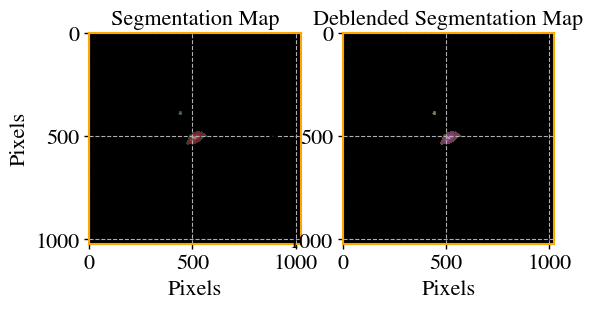

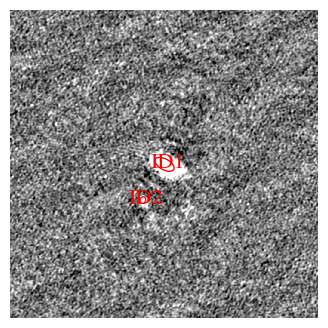

In [66]:
bwf, bhf = 1, 1 
fwf, fhf = 2, 2
clean_param = 0.5
deblend_cont = 1e-6
deblend_nthresh = 500
sigma = 3
# ell_size_factor = 2.5
ell_size_factor = 0.9*get_ell_size_factor(psf_current = mlibs.get_beam_size_px(input_data.filename)[0])

masks, indices, seg_maps, objects = \
    mlibs.phot_source_ext(input_data.filename, bw=51,
                   bh=51,
                   fw=51, fh=51,
                   minarea=mlibs.beam_area2(input_data.filename),minarea_factor=1,
                   segmentation_map=True,
                   filter_type='matched', mask=None,
                   deblend_nthresh=deblend_nthresh,
                   deblend_cont=deblend_cont,
                   clean_param=clean_param,
                   clean=True,
                   sort_by='flux',
                   sigma=sigma,sigma_mask=10,
                   ell_size_factor=1,
                   apply_mask=False,
                   show_detection=True)

In [75]:
import matplotlib.pyplot as plt
from astropy.convolution import convolve
from astropy.stats import sigma_clipped_stats
from photutils.segmentation import (detect_sources,
                                    make_2dgaussian_kernel)
from astropy.visualization import simple_norm

Not able to determine cell size. Please, provide a cell size with the parameter `cell_size`.
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


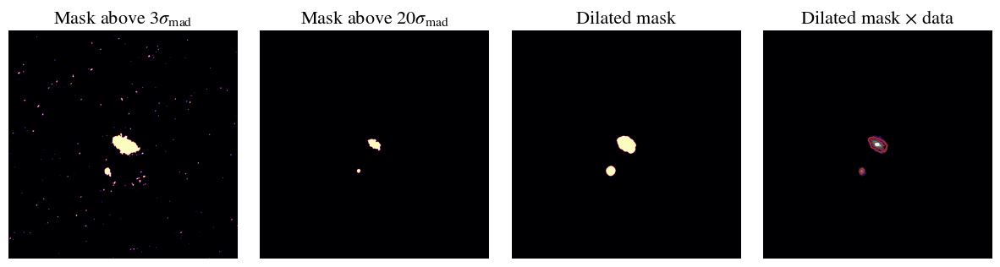

In [134]:
mlibs.beam_area2(input_data.filename)

55.24273452737936

Not able to determine cell size. Please, provide a cell size with the parameter `cell_size`.
No cell or pixel size information in the image wcs/header. Setting cell/pixel size = 1.


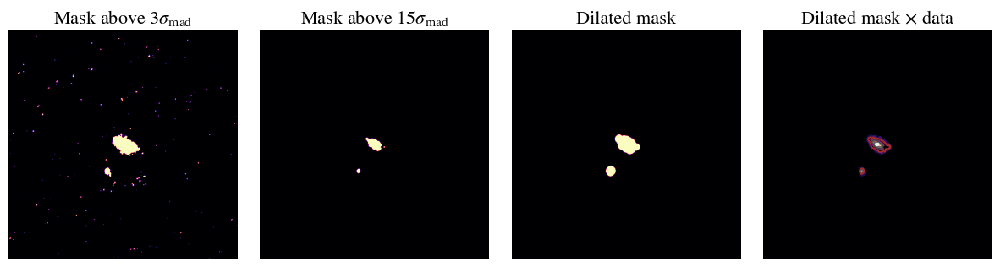

Deblending:   0%|          | 0/2 [00:00<?, ?it/s]

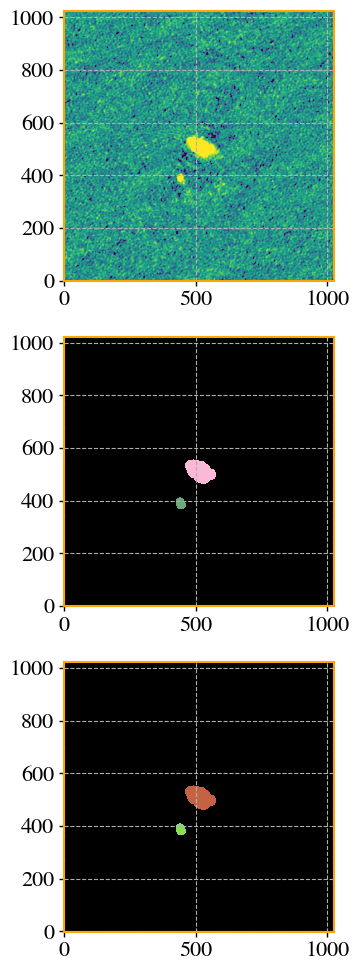

In [146]:
mean, _, std = sigma_clipped_stats(input_data.image_data_2D)
std = mlibs.mad_std(input_data.image_data_2D)
data =  input_data.image_data_2D - mean
_, mask_self = mlibs.mask_dilation(mlibs.ctn(input_data.filename), PLOT=True,dilation_type='disk',
                        sigma=15, iterations=2, dilation_size=None)

threshold = 0.6 * std
kernel = make_2dgaussian_kernel(15.0, size=15)  # FWHM = 3.
convolved_data = convolve(data*mask_self, kernel)
segm = detect_sources(convolved_data, threshold, npixels=int(mlibs.beam_area2(input_data.filename)))

from photutils.segmentation import deblend_sources
from astropy.visualization.mpl_normalize import ImageNormalize
segm_deblend = deblend_sources(convolved_data, segm,
                               npixels=int(mlibs.beam_area2(input_data.filename)*0.5), 
                               nlevels=500, contrast=0.1,
                               progress_bar=True)

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(8, 10))
norm = simple_norm(data, 'sqrt', percent=99.)
ax1.imshow(data, origin='lower', interpolation='nearest',
           norm=norm)
ax2.imshow(segm.data, origin='lower', interpolation='nearest',
           cmap=segm.make_cmap(seed=1234))
ax3.imshow(segm_deblend, origin='lower', cmap=segm_deblend.cmap,
          interpolation='nearest')
plt.tight_layout()

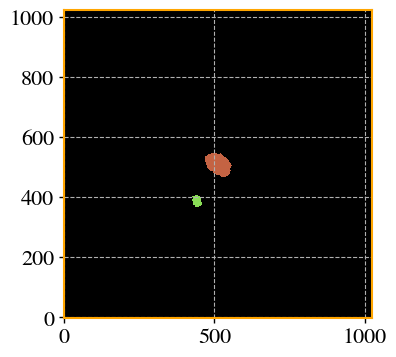

In [123]:
plt.figure()
plt.imshow(segm_deblend, origin='lower', cmap=segm_deblend.cmap,
      interpolation='nearest')



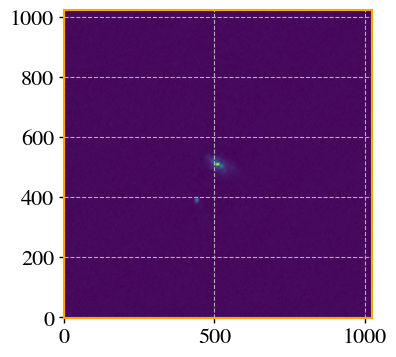

In [124]:
plt.figure()
plt.imshow(data, origin='lower', interpolation='nearest')

In [112]:
%matplotlib inline